##DATA PROCESSING

###Installing and Importing neccessary libraries and data

In [ ]:
!pip install xgboost catboost lightgbm torch tabpfn --quiet
!pip install pytorch-tabnet scikit-learn pandas numpy matplotlib seaborn --quiet
!pip install lime -q

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 99.2/99.2 MB 10.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 551.9/551.9 kB 30.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 144.7/144.7 kB 13.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 64.7/64.7 kB 5.0 MB/s eta 0:00:00
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
google-colab 1.0.0 requires requests==2.32.4, but you have requests 2.32.5 which is incompatible.
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 44.5/44.5 kB 1.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 275.7/275.7 kB 6.3 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done


In [7]:
import nbformat

file = "/content/GENERAL_PTB_MODEL_RISK_PREDICTING_AI_MODEL.ipynb"

nb = nbformat.read(file, as_version=4)

for cell in nb["cells"]:
    if "widgets" in cell.get("metadata", {}):
        del cell["metadata"]["widgets"]

nbformat.write(nb, file)
print("Fixed and saved:", file)


Fixed and saved: /content/GENERAL_PTB_MODEL_RISK_PREDICTING_AI_MODEL.ipynb


Importing libraries

In [ ]:
import warnings
warnings.filterwarnings('ignore')
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import sklearn
from sklearn.feature_selection import f_classif
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer
from google.colab import files
import re
import torch
from sklearn.preprocessing import PowerTransformer
from sklearn.model_selection import train_test_split, KFold
from sklearn.metrics import accuracy_score, classification_report,precision_score, recall_score, roc_curve,auc, confusion_matrix, roc_auc_score, f1_score
from sklearn.ensemble import RandomForestClassifier
from sklearn.neural_network import MLPClassifier
import xgboost as xgb
from catboost import CatBoostClassifier
import lightgbm as lgb
from tabpfn import TabPFNClassifier
from pytorch_tabnet.tab_model import TabNetClassifier
import torch.nn as nn
from torch.utils.data import DataLoader, TensorDataset
import shap
from lime.lime_tabular import LimeTabularExplainer
import matplotlib.colors as mcolors
from sklearn.feature_selection import f_classif
import statsmodels.api as sm
from collections import Counter
from imblearn.combine import SMOTEENN
from torch.utils.data import TensorDataset, DataLoader
from sklearn.metrics import (
    accuracy_score, precision_score, recall_score, f1_score,
    roc_auc_score, confusion_matrix, classification_report
)


In [ ]:
data = pd.read_csv('/content/drive/MyDrive/Preterm birth risk factors data collection.csv')
data.head(20)

,Patient_ID,Age,Baby position,PROM,Education level,Residence,Twin,Gest Hypertension,Chronic diseases,Infections,...,Anemia,FHR Abnormality,PTB history,Still birth history,Abortion history,Gravida,Preclampsia/Eclampsia,ANC followup,Prev C section,Outcome
0,A228592,40,right,no,NaN,rural,no,yes,no,no,...,yes,no,no,yes,no,3.0,yes,3.0,no,yes
1,A226594,24,right,NaN,NaN,rural,no,yes,NaN,no,...,no,NaN,no,yes,yes,5.0,yes,4.0,no,yes
2,A042904,26,right,yes,NaN,urban,no,yes,no,yes,...,no,no,no,yes,no,2.0,yes,3.0,yes,yes
3,A225423,24,NaN,NaN,NaN,urban,NaN,yes,NaN,NaN,...,yes,NaN,yes,no,yes,5.0,no,4.0,no,yes
4,A971233,23,NaN,no,NaN,urban,no,yes,no,NaN,...,no,no,no,no,no,1.0,no,3.0,yes,no
5,A22609,40,right,no,NaN,rural,no,no,yes,yes,...,yes,no,NaN,NaN,NaN,NaN,yes,NaN,NaN,yes
6,A227444,34,wrong,NaN,NaN,NaN,NaN,no,NaN,NaN,...,NaN,NaN,yes,no,yes,4.0,NaN,6.0,no,yes
7,A228731,28,wrong,no,NaN,rural,no,no,NaN,NaN,...,no,no,no,no,yes,6.0,no,3.0,no,yes
8,A225701,36,NaN,NaN,NaN,rural,NaN,yes,no,no,...,NaN,yes,NaN,no,NaN,NaN,yes,3.0,NaN,yes
9,A226399,30,right,no,NaN,rural,no,no,no,yes,...,yes,no,NaN,yes,NaN,4.0,NaN,4.0,yes,no


###Feature Selection

In [ ]:
print(data.columns)
data.drop(['Education level', 'Smoking','Physical stress', 'Alcohol'], axis=1, inplace=True)
data.head()

Index(['Patient_ID', 'Age', 'Baby position', 'PROM', 'Education level',
       'Residence', 'Twin', 'Gest Hypertension', 'Chronic diseases',
       'Infections', 'APH', 'Uterine problem', 'Smoking', 'Alcohol',
       'Physical stress', 'Anemia', 'FHR Abnormality', 'PTB history',
       'Still birth history', 'Abortion history', 'Gravida',
       'Preclampsia/Eclampsia', 'ANC followup', 'Prev C section', 'Outcome'],
      dtype='object')


,Patient_ID,Age,Baby position,PROM,Residence,Twin,Gest Hypertension,Chronic diseases,Infections,APH,...,Anemia,FHR Abnormality,PTB history,Still birth history,Abortion history,Gravida,Preclampsia/Eclampsia,ANC followup,Prev C section,Outcome
0,A228592,40,right,no,rural,no,yes,no,no,no,...,yes,no,no,yes,no,3.0,yes,3.0,no,yes
1,A226594,24,right,NaN,rural,no,yes,NaN,no,no,...,no,NaN,no,yes,yes,5.0,yes,4.0,no,yes
2,A042904,26,right,yes,urban,no,yes,no,yes,yes,...,no,no,no,yes,no,2.0,yes,3.0,yes,yes
3,A225423,24,NaN,NaN,urban,NaN,yes,NaN,NaN,yes,...,yes,NaN,yes,no,yes,5.0,no,4.0,no,yes
4,A971233,23,NaN,no,urban,no,yes,no,NaN,yes,...,no,no,no,no,no,1.0,no,3.0,yes,no


Dropping 'Patient ID'

In [ ]:
data.drop(['Patient_ID'], axis=1, inplace=True)
data.head()

,Age,Baby position,PROM,Residence,Twin,Gest Hypertension,Chronic diseases,Infections,APH,Uterine problem,Anemia,FHR Abnormality,PTB history,Still birth history,Abortion history,Gravida,Preclampsia/Eclampsia,ANC followup,Prev C section,Outcome
0,40,right,no,rural,no,yes,no,no,no,no,yes,no,no,yes,no,3.0,yes,3.0,no,yes
1,24,right,NaN,rural,no,yes,NaN,no,no,NaN,no,NaN,no,yes,yes,5.0,yes,4.0,no,yes
2,26,right,yes,urban,no,yes,no,yes,yes,no,no,no,no,yes,no,2.0,yes,3.0,yes,yes
3,24,NaN,NaN,urban,NaN,yes,NaN,NaN,yes,no,yes,NaN,yes,no,yes,5.0,no,4.0,no,yes
4,23,NaN,no,urban,no,yes,no,NaN,yes,NaN,no,no,no,no,no,1.0,no,3.0,yes,no


Checking data shape

In [ ]:
data.shape

(1356, 20)

Displaying the first 20 data rows

In [ ]:
data.head(20)

,Age,Baby position,PROM,Residence,Twin,Gest Hypertension,Chronic diseases,Infections,APH,Uterine problem,Anemia,FHR Abnormality,PTB history,Still birth history,Abortion history,Gravida,Preclampsia/Eclampsia,ANC followup,Prev C section,Outcome
0,40,right,no,rural,no,yes,no,no,no,no,yes,no,no,yes,no,3.0,yes,3.0,no,yes
1,24,right,NaN,rural,no,yes,NaN,no,no,NaN,no,NaN,no,yes,yes,5.0,yes,4.0,no,yes
2,26,right,yes,urban,no,yes,no,yes,yes,no,no,no,no,yes,no,2.0,yes,3.0,yes,yes
3,24,NaN,NaN,urban,NaN,yes,NaN,NaN,yes,no,yes,NaN,yes,no,yes,5.0,no,4.0,no,yes
4,23,NaN,no,urban,no,yes,no,NaN,yes,NaN,no,no,no,no,no,1.0,no,3.0,yes,no
5,40,right,no,rural,no,no,yes,yes,no,no,yes,no,NaN,NaN,NaN,NaN,yes,NaN,NaN,yes
6,34,wrong,NaN,NaN,NaN,no,NaN,NaN,yes,no,NaN,NaN,yes,no,yes,4.0,NaN,6.0,no,yes
7,28,wrong,no,rural,no,no,NaN,NaN,no,NaN,no,no,no,no,yes,6.0,no,3.0,no,yes
8,36,NaN,NaN,rural,NaN,yes,no,no,yes,yes,NaN,yes,NaN,no,NaN,NaN,yes,3.0,NaN,yes
9,30,right,no,rural,no,no,no,yes,no,no,yes,no,NaN,yes,NaN,4.0,NaN,4.0,yes,no


###Data encoding

Encoding Yes/No categories to Numbers

In [ ]:
def map_yes_no(val):
    if isinstance(val, str):
        val_lower = val.strip().lower()
        if val_lower == 'yes':
            return 1
        elif val_lower == 'no':
            return 0
    return val  # leave NaN or other values as-is

for col in data.columns:
    if data[col].dtype == 'object' and (
        data[col].str.lower().str.contains('yes', na=False).any() or
        data[col].str.lower().str.contains('no', na=False).any()
    ):
        data[col] = data[col].apply(map_yes_no)

data.head()


,Age,Baby position,PROM,Residence,Twin,Gest Hypertension,Chronic diseases,Infections,APH,Uterine problem,Anemia,FHR Abnormality,PTB history,Still birth history,Abortion history,Gravida,Preclampsia/Eclampsia,ANC followup,Prev C section,Outcome
0,40,right,0.0,rural,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0,0.0,1.0,0.0,3.0,1.0,3.0,0.0,1
1,24,right,NaN,rural,0.0,1.0,NaN,0.0,0.0,NaN,0.0,NaN,0.0,1.0,1.0,5.0,1.0,4.0,0.0,1
2,26,right,1.0,urban,0.0,1.0,0.0,1.0,1.0,0.0,0.0,0,0.0,1.0,0.0,2.0,1.0,3.0,1.0,1
3,24,NaN,NaN,urban,NaN,1.0,NaN,NaN,1.0,0.0,1.0,NaN,1.0,0.0,1.0,5.0,0.0,4.0,0.0,1
4,23,NaN,0.0,urban,0.0,1.0,0.0,NaN,1.0,NaN,0.0,0,0.0,0.0,0.0,1.0,0.0,3.0,1.0,0


Encoding Right/Wrong into Numbers

In [ ]:
# Find columns that contain 'right' or 'wrong'
columns_to_convert = []
for col in data.columns:
     if data[col].dtype == 'object':
         # Check if the column contains 'right' or 'wrong' (case-insensitive)
         if data[col].str.lower().str.contains('right').any() or data[col].str.lower().str.contains('wrong').any():
             columns_to_convert.append(col)

# # Convert 'right' to 0 and 'wrong' to 1 in the identified columns
for col in columns_to_convert:
     data[col] = data[col].str.lower().replace({'right': 0, 'wrong': 1})
     # Convert the column to numeric type after replacement
     data[col] = pd.to_numeric(data[col], errors='coerce')

data.head()

,Age,Baby position,PROM,Residence,Twin,Gest Hypertension,Chronic diseases,Infections,APH,Uterine problem,Anemia,FHR Abnormality,PTB history,Still birth history,Abortion history,Gravida,Preclampsia/Eclampsia,ANC followup,Prev C section,Outcome
0,40,0.0,0.0,rural,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0,0.0,1.0,0.0,3.0,1.0,3.0,0.0,1
1,24,0.0,NaN,rural,0.0,1.0,NaN,0.0,0.0,NaN,0.0,NaN,0.0,1.0,1.0,5.0,1.0,4.0,0.0,1
2,26,0.0,1.0,urban,0.0,1.0,0.0,1.0,1.0,0.0,0.0,0,0.0,1.0,0.0,2.0,1.0,3.0,1.0,1
3,24,NaN,NaN,urban,NaN,1.0,NaN,NaN,1.0,0.0,1.0,NaN,1.0,0.0,1.0,5.0,0.0,4.0,0.0,1
4,23,NaN,0.0,urban,0.0,1.0,0.0,NaN,1.0,NaN,0.0,0,0.0,0.0,0.0,1.0,0.0,3.0,1.0,0


Encoding Urban/Rural into numbers

In [ ]:
# Find columns that contain 'right' or 'wrong'
columns_to_convert = []
for col in data.columns:
     if data[col].dtype == 'object':
         # Check if the column contains 'right' or 'wrong' (case-insensitive)
         if data[col].str.lower().str.contains('rural').any() or data[col].str.lower().str.contains('urban').any():
             columns_to_convert.append(col)

# Convert 'right' to 0 and 'wrong' to 1 in the identified columns
for col in columns_to_convert:
     data[col] = data[col].str.lower().replace({'urban': 0, 'rural': 1})
#     # Convert the column to numeric type after replacement
     data[col] = pd.to_numeric(data[col], errors='coerce')

data.head()

,Age,Baby position,PROM,Residence,Twin,Gest Hypertension,Chronic diseases,Infections,APH,Uterine problem,Anemia,FHR Abnormality,PTB history,Still birth history,Abortion history,Gravida,Preclampsia/Eclampsia,ANC followup,Prev C section,Outcome
0,40,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0,0.0,1.0,0.0,3.0,1.0,3.0,0.0,1
1,24,0.0,NaN,1.0,0.0,1.0,NaN,0.0,0.0,NaN,0.0,NaN,0.0,1.0,1.0,5.0,1.0,4.0,0.0,1
2,26,0.0,1.0,0.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,0,0.0,1.0,0.0,2.0,1.0,3.0,1.0,1
3,24,NaN,NaN,0.0,NaN,1.0,NaN,NaN,1.0,0.0,1.0,NaN,1.0,0.0,1.0,5.0,0.0,4.0,0.0,1
4,23,NaN,0.0,0.0,0.0,1.0,0.0,NaN,1.0,NaN,0.0,0,0.0,0.0,0.0,1.0,0.0,3.0,1.0,0


Checking if all data features are encoded

In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1356 entries, 0 to 1355
Data columns (total 20 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   Age                    1356 non-null   int64  
 1   Baby position          1330 non-null   float64
 2   PROM                   1326 non-null   float64
 3   Residence              1355 non-null   float64
 4   Twin                   1335 non-null   float64
 5   Gest Hypertension      1339 non-null   float64
 6   Chronic diseases       1328 non-null   float64
 7   Infections             1335 non-null   float64
 8   APH                    1340 non-null   float64
 9   Uterine problem        1328 non-null   float64
 10  Anemia                 1347 non-null   float64
 11  FHR Abnormality        1349 non-null   object 
 12  PTB history            1284 non-null   float64
 13  Still birth history    1354 non-null   float64
 14  Abortion history       1352 non-null   float64
 15  Grav

In [ ]:
!pip freeze > requirements.txt
from google.colab import files
files.download('requirements.txt')



<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
# Convert remaining string values to NaN
for col in data.columns:
    if data[col].dtype == 'object':
        # Replace any non-numeric values with NaN
        data[col] = data[col].apply(lambda x: np.nan if isinstance(x, str) else x)

print("Data after converting remaining strings to NaN:")
data.head()

Data after converting remaining strings to NaN:


,Age,Baby position,PROM,Residence,Twin,Gest Hypertension,Chronic diseases,Infections,APH,Uterine problem,Anemia,FHR Abnormality,PTB history,Still birth history,Abortion history,Gravida,Preclampsia/Eclampsia,ANC followup,Prev C section,Outcome
0,40,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,3.0,1.0,3.0,0.0,1
1,24,0.0,NaN,1.0,0.0,1.0,NaN,0.0,0.0,NaN,0.0,NaN,0.0,1.0,1.0,5.0,1.0,4.0,0.0,1
2,26,0.0,1.0,0.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,2.0,1.0,3.0,1.0,1
3,24,NaN,NaN,0.0,NaN,1.0,NaN,NaN,1.0,0.0,1.0,NaN,1.0,0.0,1.0,5.0,0.0,4.0,0.0,1
4,23,NaN,0.0,0.0,0.0,1.0,0.0,NaN,1.0,NaN,0.0,0.0,0.0,0.0,0.0,1.0,0.0,3.0,1.0,0


###Data Imptuation

**MICE**

In [ ]:
# Initialize the IterativeImputer (MICE)
# You can adjust max_iter, random_state, and other parameters as needed
mice_imputer = IterativeImputer(max_iter=10, random_state=42)

# Apply MICE to the DataFrame
data_imputed_array = mice_imputer.fit_transform(data)

# Convert the imputed array back to a DataFrame
data_imputed = pd.DataFrame(data_imputed_array, columns=data.columns)

# Update the original data DataFrame with the imputed values
data = data_imputed

print("Data after MICE imputation:")
print(data.isnull().sum())
data.head(20)

Data after MICE imputation:
Age                      0
Baby position            0
PROM                     0
Residence                0
Twin                     0
Gest Hypertension        0
Chronic diseases         0
Infections               0
APH                      0
Uterine problem          0
Anemia                   0
FHR Abnormality          0
PTB history              0
Still birth history      0
Abortion history         0
Gravida                  0
Preclampsia/Eclampsia    0
ANC followup             0
Prev C section           0
Outcome                  0
dtype: int64


,Age,Baby position,PROM,Residence,Twin,Gest Hypertension,Chronic diseases,Infections,APH,Uterine problem,Anemia,FHR Abnormality,PTB history,Still birth history,Abortion history,Gravida,Preclampsia/Eclampsia,ANC followup,Prev C section,Outcome
0,40.0,0.000000,0.000000,1.000000,0.000000,1.0,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,1.000000,0.000000,3.000000,1.000000,3.000000,0.000000,1.0
1,24.0,0.000000,0.313647,1.000000,0.000000,1.0,0.320685,0.000000,0.000000,0.261089,0.000000,0.079982,0.000000,1.000000,1.000000,5.000000,1.000000,4.000000,0.000000,1.0
2,26.0,0.000000,1.000000,0.000000,0.000000,1.0,0.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,2.000000,1.000000,3.000000,1.000000,1.0
3,24.0,0.270701,0.539503,0.000000,0.145583,1.0,0.226567,0.654960,1.000000,0.000000,1.000000,0.093149,1.000000,0.000000,1.000000,5.000000,0.000000,4.000000,0.000000,1.0
4,23.0,0.110733,0.000000,0.000000,0.000000,1.0,0.000000,0.161165,1.000000,0.055299,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,3.000000,1.000000,0.0
5,40.0,0.000000,0.000000,1.000000,0.000000,0.0,1.000000,1.000000,0.000000,0.000000,1.000000,0.000000,0.522025,0.215119,0.387596,5.011436,1.000000,3.708789,0.316733,1.0
6,34.0,1.000000,0.466237,0.326212,0.197454,0.0,0.310473,0.474607,1.000000,0.000000,0.469024,0.182733,1.000000,0.000000,1.000000,4.000000,0.414679,6.000000,0.000000,1.0
7,28.0,1.000000,0.000000,1.000000,0.000000,0.0,0.250260,0.353198,0.000000,0.139429,0.000000,0.000000,0.000000,0.000000,1.000000,6.000000,0.000000,3.000000,0.000000,1.0
8,36.0,0.235203,0.461501,1.000000,0.121209,1.0,0.000000,0.000000,1.000000,1.000000,0.525321,1.000000,0.593364,0.000000,0.365015,3.808422,1.000000,3.000000,0.425366,1.0
9,30.0,0.000000,0.000000,1.000000,0.000000,0.0,0.000000,1.000000,0.000000,0.000000,1.000000,0.000000,0.181574,1.000000,0.120630,4.000000,0.192393,4.000000,1.000000,0.0


In [ ]:
# Apply absolute value to all numerical columns
# This will make all values positive
for col in data.select_dtypes(include=np.number).columns:
    data[col] = np.abs(data[col])

print("Data after making all values positive:")
data.head(20)

Data after making all values positive:


,Age,Baby position,PROM,Residence,Twin,Gest Hypertension,Chronic diseases,Infections,APH,Uterine problem,Anemia,FHR Abnormality,PTB history,Still birth history,Abortion history,Gravida,Preclampsia/Eclampsia,ANC followup,Prev C section,Outcome
0,40.0,0.000000,0.000000,1.000000,0.000000,1.0,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,1.000000,0.000000,3.000000,1.000000,3.000000,0.000000,1.0
1,24.0,0.000000,0.313647,1.000000,0.000000,1.0,0.320685,0.000000,0.000000,0.261089,0.000000,0.079982,0.000000,1.000000,1.000000,5.000000,1.000000,4.000000,0.000000,1.0
2,26.0,0.000000,1.000000,0.000000,0.000000,1.0,0.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,2.000000,1.000000,3.000000,1.000000,1.0
3,24.0,0.270701,0.539503,0.000000,0.145583,1.0,0.226567,0.654960,1.000000,0.000000,1.000000,0.093149,1.000000,0.000000,1.000000,5.000000,0.000000,4.000000,0.000000,1.0
4,23.0,0.110733,0.000000,0.000000,0.000000,1.0,0.000000,0.161165,1.000000,0.055299,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,3.000000,1.000000,0.0
5,40.0,0.000000,0.000000,1.000000,0.000000,0.0,1.000000,1.000000,0.000000,0.000000,1.000000,0.000000,0.522025,0.215119,0.387596,5.011436,1.000000,3.708789,0.316733,1.0
6,34.0,1.000000,0.466237,0.326212,0.197454,0.0,0.310473,0.474607,1.000000,0.000000,0.469024,0.182733,1.000000,0.000000,1.000000,4.000000,0.414679,6.000000,0.000000,1.0
7,28.0,1.000000,0.000000,1.000000,0.000000,0.0,0.250260,0.353198,0.000000,0.139429,0.000000,0.000000,0.000000,0.000000,1.000000,6.000000,0.000000,3.000000,0.000000,1.0
8,36.0,0.235203,0.461501,1.000000,0.121209,1.0,0.000000,0.000000,1.000000,1.000000,0.525321,1.000000,0.593364,0.000000,0.365015,3.808422,1.000000,3.000000,0.425366,1.0
9,30.0,0.000000,0.000000,1.000000,0.000000,0.0,0.000000,1.000000,0.000000,0.000000,1.000000,0.000000,0.181574,1.000000,0.120630,4.000000,0.192393,4.000000,1.000000,0.0


In [ ]:
# Convert all numerical columns to integer type after imputation and absolute value
for col in data.select_dtypes(include=np.number).columns:
    # Handle potential NaN values before converting to integer, e.g., by filling with 0 or rounding and converting
    # For simplicity here, I'll round and then convert, assuming imputation handled most NaNs
    data[col] = np.round(data[col]).astype(int)

print("\nData after converting numerical columns to integers:")
data.head(20)


Data after converting numerical columns to integers:


,Age,Baby position,PROM,Residence,Twin,Gest Hypertension,Chronic diseases,Infections,APH,Uterine problem,Anemia,FHR Abnormality,PTB history,Still birth history,Abortion history,Gravida,Preclampsia/Eclampsia,ANC followup,Prev C section,Outcome
0,40,0,0,1,0,1,0,0,0,0,1,0,0,1,0,3,1,3,0,1
1,24,0,0,1,0,1,0,0,0,0,0,0,0,1,1,5,1,4,0,1
2,26,0,1,0,0,1,0,1,1,0,0,0,0,1,0,2,1,3,1,1
3,24,0,1,0,0,1,0,1,1,0,1,0,1,0,1,5,0,4,0,1
4,23,0,0,0,0,1,0,0,1,0,0,0,0,0,0,1,0,3,1,0
5,40,0,0,1,0,0,1,1,0,0,1,0,1,0,0,5,1,4,0,1
6,34,1,0,0,0,0,0,0,1,0,0,0,1,0,1,4,0,6,0,1
7,28,1,0,1,0,0,0,0,0,0,0,0,0,0,1,6,0,3,0,1
8,36,0,0,1,0,1,0,0,1,1,1,1,1,0,0,4,1,3,0,1
9,30,0,0,1,0,0,0,1,0,0,1,0,0,1,0,4,0,4,1,0


In [ ]:
data.describe()

,Age,Baby position,PROM,Residence,Twin,Gest Hypertension,Chronic diseases,Infections,APH,Uterine problem,Anemia,FHR Abnormality,PTB history,Still birth history,Abortion history,Gravida,Preclampsia/Eclampsia,ANC followup,Prev C section,Outcome
count,1356.000000,1356.000000,1356.000000,1356.000000,1356.000000,1356.000000,1356.000000,1356.000000,1356.000000,1356.000000,1356.000000,1356.000000,1356.000000,1356.000000,1356.000000,1356.000000,1356.000000,1356.000000,1356.000000,1356.000000
mean,26.593658,0.160767,0.184366,0.404130,0.068584,0.278761,0.091445,0.247788,0.143068,0.066372,0.218289,0.162242,0.156342,0.087021,0.142330,2.457227,0.217552,4.997050,0.237463,0.296460
std,5.672430,0.367451,0.387925,0.490904,0.252839,0.448555,0.288348,0.431887,0.350271,0.249023,0.413237,0.368809,0.363313,0.281969,0.349518,1.458534,0.412733,1.608554,0.425685,0.456865
min,15.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000
25%,22.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,4.000000,0.000000,0.000000
50%,26.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.000000,0.000000,5.000000,0.000000,0.000000
75%,30.000000,0.000000,0.000000,1.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,3.000000,0.000000,6.000000,0.000000,1.000000
max,45.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,10.000000,1.000000,12.000000,1.000000,1.000000


###Statistical Data Analysis

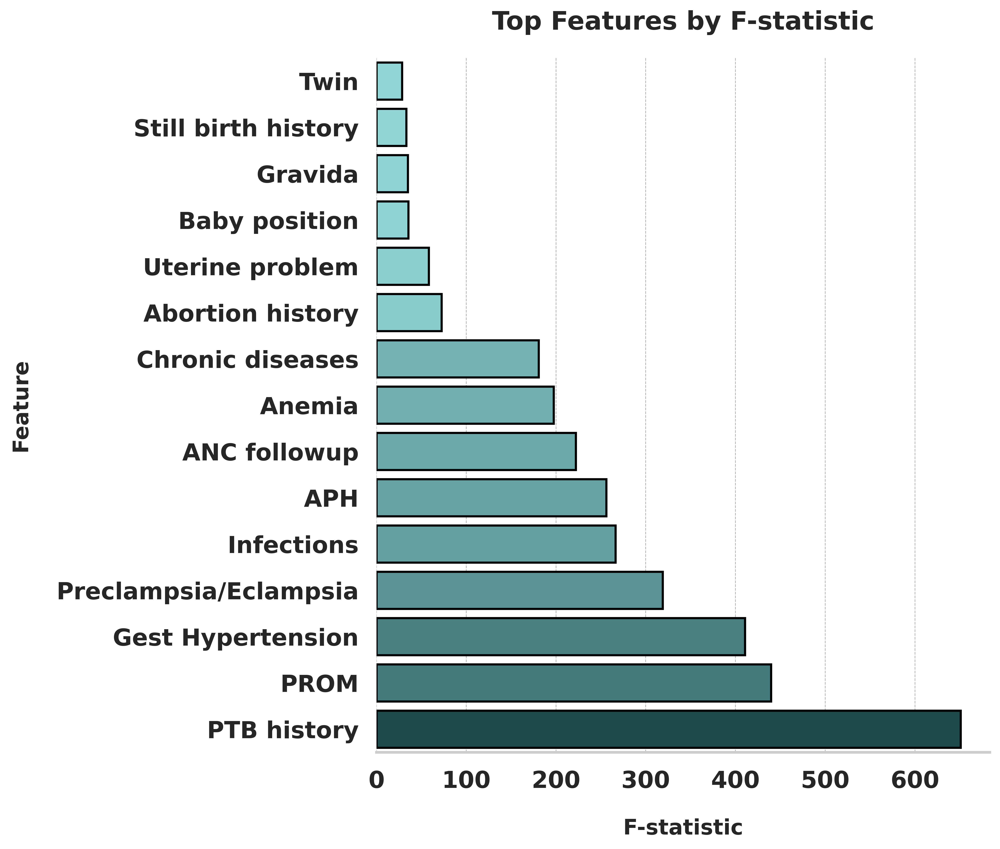

In [ ]:

# -----------------------------
# Data preparation
# -----------------------------
X = data.drop('Outcome', axis=1)
y = data['Outcome']

f_stats, p_values = f_classif(X, y)

f_stats_df = pd.DataFrame({
    'Feature': X.columns,
    'F-statistic': f_stats,
    'P-value': p_values
}).sort_values('F-statistic', ascending=False)

# Clean feature names
def clean_feature_name(name):
    name = name.replace("_", " ")
    name = re.sub(r"\d+$", "", name)
    return name.strip()

f_stats_df["Clean Feature"] = f_stats_df["Feature"].apply(clean_feature_name)

# Special handling for Baby position
f_stats_df["Clean Feature"] = f_stats_df["Clean Feature"].replace({
    "Baby position 0": None,
    "Baby position 2": "Baby position"
})

f_stats_df = f_stats_df[f_stats_df["Clean Feature"].notnull()]
f_stats_df = f_stats_df.drop_duplicates(subset=["Clean Feature"], keep="first")

# -----------------------------
# Visualization
# -----------------------------
sns.set(style="whitegrid", context="talk")

top_n = 15
plot_df = f_stats_df.head(top_n).iloc[::-1]  # reverse for barh

# Normalize F-statistics for color mapping
norm = plt.Normalize(plot_df["F-statistic"].min(), plot_df["F-statistic"].max())

# Custom color gradient from #145252 to #85e0e0
cmap = mcolors.LinearSegmentedColormap.from_list("teal_gradient", ["#85e0e0", "#145252"])

# Map F-statistic values to color gradient
colors = [cmap(norm(val)) for val in plot_df["F-statistic"]]

# Plot
plt.figure(figsize=(10, 8))

ax = sns.barplot(
    x="F-statistic",
    y="Clean Feature",
    data=plot_df,
    palette=colors,
    edgecolor="black"
)

# Titles & labels
ax.set_title("Top Features by F-statistic", fontsize=18, fontweight="bold", pad=20)
ax.set_xlabel("F-statistic", fontsize=15, fontweight="bold", labelpad=18)
ax.set_ylabel("Feature", fontsize=15, fontweight="bold", labelpad=18)

# Bold y-axis tick labels
ax.set_yticklabels([t.get_text() for t in ax.get_yticklabels()], fontweight="bold")

# Remove spines
for spine in ["top", "right", "left"]:
    ax.spines[spine].set_visible(False)

# Grid styling
ax.xaxis.grid(True, linestyle="--", linewidth=0.5, color="gray", alpha=0.6)
ax.yaxis.grid(False)

# Adjust layout
plt.subplots_adjust(left=0.35, right=0.95, top=0.9, bottom=0.05)

# -----------------------------
# Save high-quality figure
# -----------------------------
plt.savefig("f_statistic_gradient_graph.tiff", dpi=600, bbox_inches="tight")
plt.savefig("f_statistic_gradient_feature_importance.png", dpi=600, bbox_inches="tight")

plt.show()

In [ ]:
# -----------------------------
# Display F-statistics table
# -----------------------------
# Prepare and display a clean table of all features

f_stats_table = f_stats_df[["Clean Feature", "F-statistic", "P-value"]] \
    .sort_values("F-statistic", ascending=False)

# Display in full (without index)
print(f_stats_table.to_string(index=False))

        Clean Feature  F-statistic       P-value
          PTB history   650.903840 1.472920e-117
                 PROM   439.561825  9.556158e-85
    Gest Hypertension   410.537893  6.141797e-80
Preclampsia/Eclampsia   318.825047  3.345661e-64
           Infections   266.302375  8.626706e-55
                  APH   256.155597  6.163959e-53
         ANC followup   222.112809  1.255628e-46
               Anemia   197.383700  5.895296e-42
     Chronic diseases   180.621356  9.578465e-39
     Abortion history    72.514426  4.345693e-17
      Uterine problem    58.290392  4.249650e-14
        Baby position    35.525439  3.206106e-09
              Gravida    34.934015  4.310405e-09
  Still birth history    33.234481  1.010442e-08
                 Twin    28.386766  1.162259e-07
                  Age    13.929489  1.976584e-04
            Residence    13.813796  2.100768e-04
       Prev C section     6.025123  1.422875e-02
      FHR Abnormality     5.697210  1.712850e-02


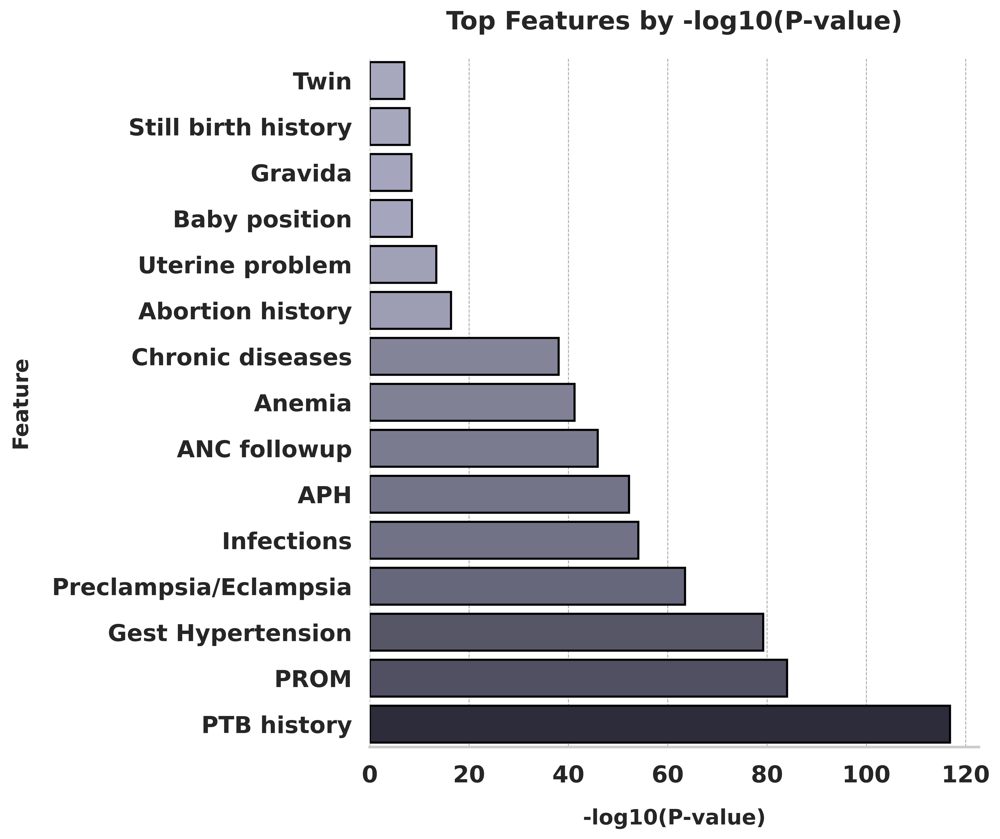

In [ ]:
# -----------------------------
# Feature name cleaning
# -----------------------------
def clean_feature_name(name):
    name = name.replace("_", " ")
    name = re.sub(r"\d+$", "", name)
    return name.strip()

p_values_df = f_stats_df.copy()
p_values_df["Clean Feature"] = p_values_df["Feature"].apply(clean_feature_name)

# Special handling for Baby position
p_values_df["Clean Feature"] = p_values_df["Clean Feature"].replace({
    "Baby position 0": None,
    "Baby position 2": "Baby position"
})

# Drop nulls and duplicates
p_values_df = p_values_df[p_values_df["Clean Feature"].notnull()]
p_values_df = p_values_df.drop_duplicates(subset=["Clean Feature"], keep="first")

# -----------------------------
# -log10 transform of p-values
# -----------------------------
p_values_df["-log10(P-value)"] = -np.log10(p_values_df["P-value"])
p_values_df = p_values_df.sort_values("-log10(P-value)", ascending=False)

# -----------------------------
# Visualization
# -----------------------------
sns.set(style="whitegrid", context="talk")

top_n = 15
plot_df = p_values_df.head(top_n).iloc[::-1]  # reverse for barh

# Normalize values for color mapping
norm = plt.Normalize(plot_df["-log10(P-value)"].min(), plot_df["-log10(P-value)"].max())

# Custom green gradient: from light to dark (low to high significance)
cmap = mcolors.LinearSegmentedColormap.from_list("green_gradient", ["#a3a3c2", "#29293d"])

# Generate color list
colors = [cmap(norm(val)) for val in plot_df["-log10(P-value)"]]

# Plot
plt.figure(figsize=(10, 8))

ax = sns.barplot(
    x="-log10(P-value)",
    y="Clean Feature",
    data=plot_df,
    palette=colors,
    edgecolor="black"
)

# Titles & labels
ax.set_title("Top Features by -log10(P-value)", fontsize=18, fontweight="bold", pad=20)
ax.set_xlabel("-log10(P-value)", fontsize=15, fontweight="bold", labelpad=15)
ax.set_ylabel("Feature", fontsize=15, fontweight="bold", labelpad=15)

# Bold y-axis labels
ax.set_yticklabels([t.get_text() for t in ax.get_yticklabels()], fontweight="bold")

# Remove spines for cleaner look
for spine in ["top", "right", "left"]:
    ax.spines[spine].set_visible(False)

# Grid styling
ax.xaxis.grid(True, linestyle="--", linewidth=0.6, color="gray", alpha=0.7)
ax.yaxis.grid(False)

# Layout spacing
plt.subplots_adjust(left=0.35, right=0.95, top=0.9, bottom=0.05)

# -----------------------------
# Save high-quality figure
# -----------------------------
plt.savefig("p_value.tiff", dpi=600, bbox_inches="tight")
plt.savefig("p_value_feature_significance_log_nature.png", dpi=600, bbox_inches="tight")

plt.show()


In [ ]:
# Prepare a DataFrame with all features and their p-values and cleaned names
all_p_values_table = f_stats_df.copy()
all_p_values_table["Features"] = all_p_values_table["Feature"].apply(clean_feature_name)

# Drop nulls and duplicates on cleaned feature
all_p_values_table = all_p_values_table[all_p_values_table["Features"].notnull()]
all_p_values_table = all_p_values_table.drop_duplicates(subset=["Features"], keep="first")

# Select columns and sort by p-value ascending
all_p_values_table = all_p_values_table[["Features", "P-value"]].sort_values("P-value")
#display the table
print(all_p_values_table.to_string(index=False))

             Features       P-value
          PTB history 1.472920e-117
                 PROM  9.556158e-85
    Gest Hypertension  6.141797e-80
Preclampsia/Eclampsia  3.345661e-64
           Infections  8.626706e-55
                  APH  6.163959e-53
         ANC followup  1.255628e-46
               Anemia  5.895296e-42
     Chronic diseases  9.578465e-39
     Abortion history  4.345693e-17
      Uterine problem  4.249650e-14
        Baby position  3.206106e-09
              Gravida  4.310405e-09
  Still birth history  1.010442e-08
                 Twin  1.162259e-07
                  Age  1.976584e-04
            Residence  2.100768e-04
       Prev C section  1.422875e-02
      FHR Abnormality  1.712850e-02


###Exploratory Data Analysis

####Univariate

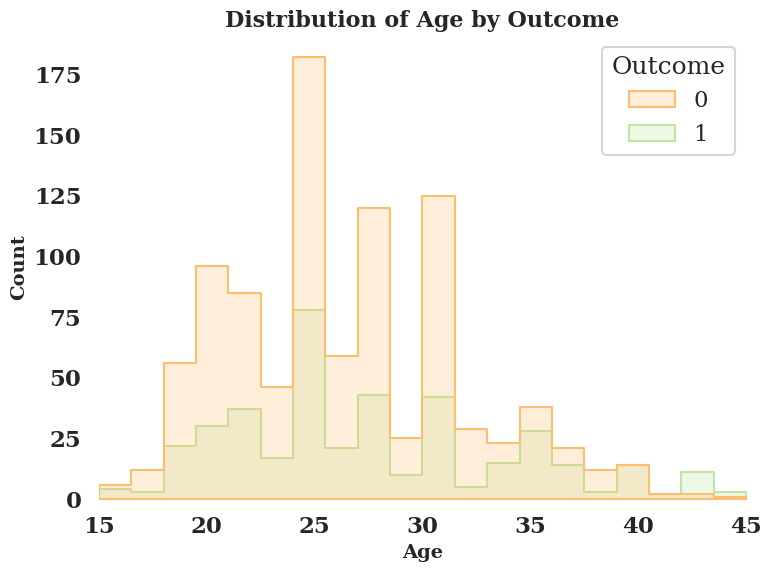

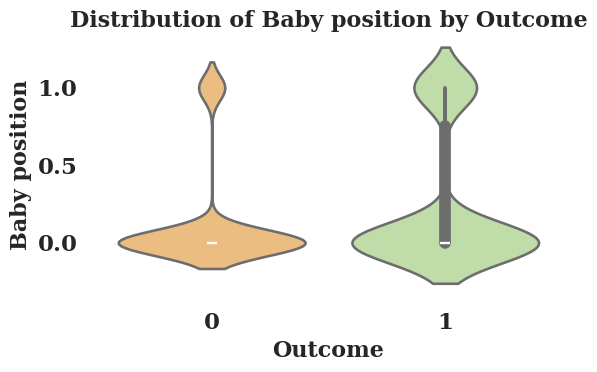

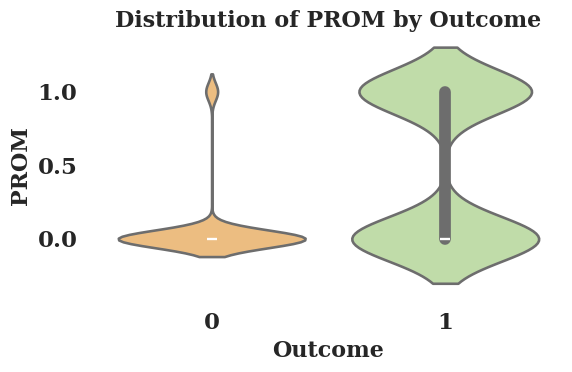

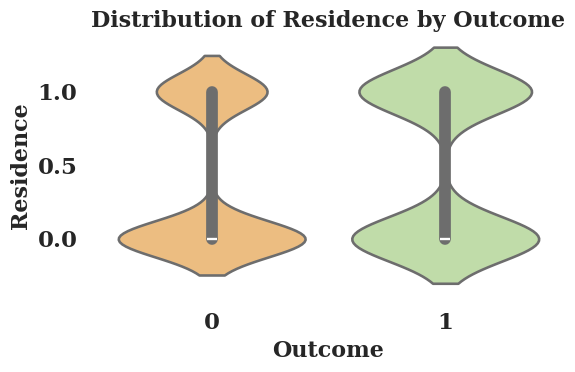

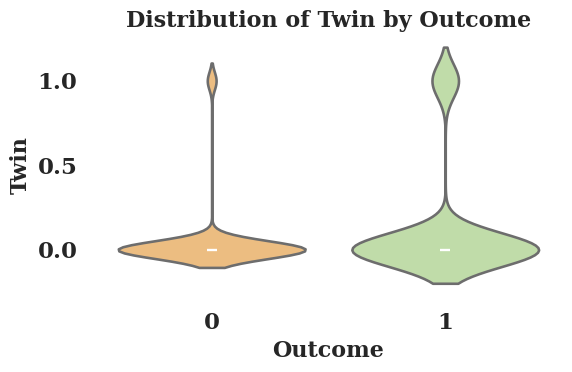

...

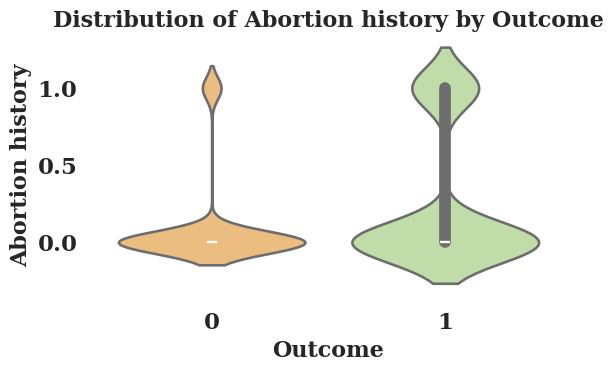

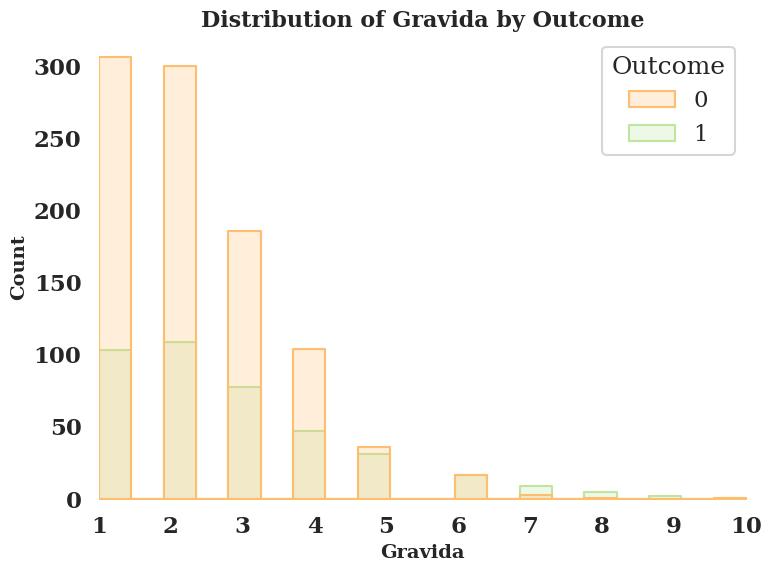

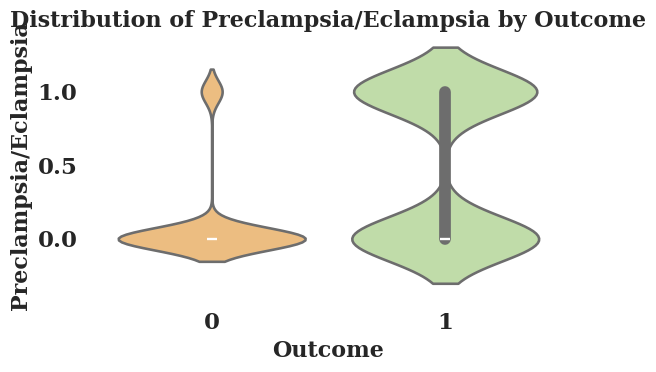

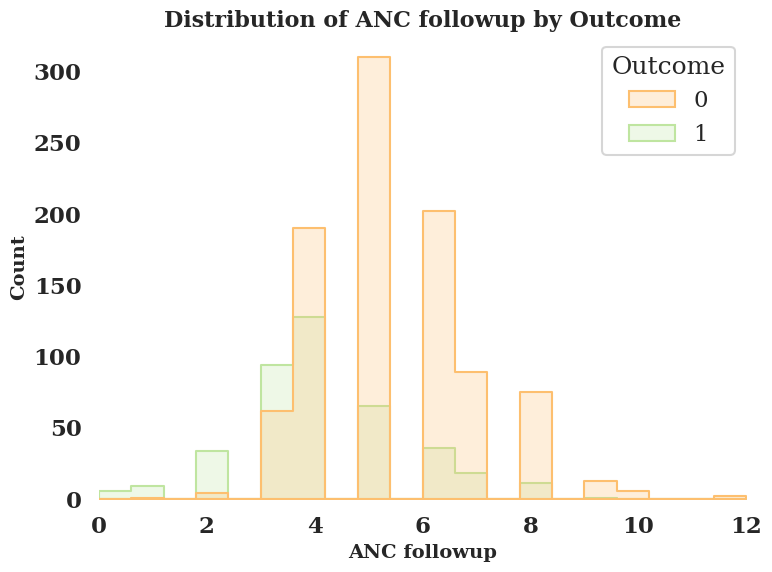

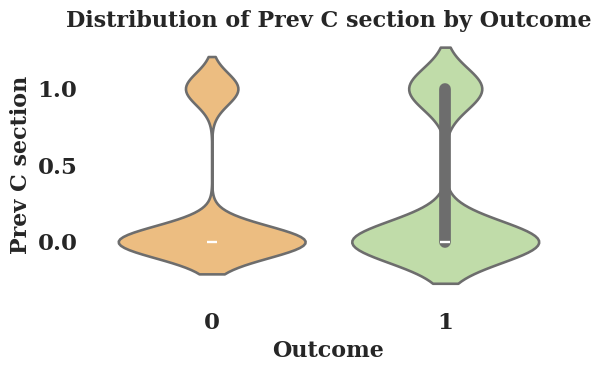

✅ All figures saved in high-quality TIFF format in: feature_vs_outcome_figures


In [ ]:
plt.rcParams.update({
    "font.family": "serif",
    "font.size": 16,
    "axes.labelweight": "bold",
    "axes.titlesize": 16,
    "axes.titleweight": "bold"
})

# --- Create output folder ---
output_dir = "feature_vs_outcome_figures"
os.makedirs(output_dir, exist_ok=True)

# --- Helper to clean filenames ---
def clean_filename(s):
    return re.sub(r'[\\/*?:"<>|,]', "_", s).replace(" ", "_")

# --- Select numerical columns ---
numerical_cols = data.select_dtypes(include=np.number).columns.tolist()
if "Outcome" in numerical_cols:
    numerical_cols.remove("Outcome")

# ===========================
# Loop through features
# ===========================
for col in numerical_cols:
    unique_vals = data[col].dropna().unique()
    max_val = data[col].max()

    # ---- Case 1: Small-range integer → Violin plot ----
    if np.allclose(unique_vals, unique_vals.astype(int)) and max_val <= 3:
        plt.figure(figsize=(6, 4))
        ax = sns.violinplot(
            x="Outcome",
            y=col,
            data=data,
            palette="Spectral",
            inner="box"  # adds boxplot inside violin
        )
        plt.title(f'Distribution of {col} by Outcome', fontsize=16, fontweight='bold')
        plt.xlabel("Outcome", fontsize=16, fontweight='bold')
        plt.ylabel(col, fontsize=16, fontweight='bold')
        plt.xticks(fontweight='bold')
        plt.yticks(fontweight='bold')
        sns.despine(left=True, bottom=True)
        ax.grid(False)

        fname = os.path.join(output_dir, f"{clean_filename(col)}_violin_vs_outcome.tiff")
        plt.tight_layout()
        plt.show()
        plt.savefig(fname, dpi=600, bbox_inches="tight")
        plt.close()

    # ---- Case 2: Truly continuous → Histogram of counts ----
    else:
        plt.figure(figsize=(8, 6))
        ax = sns.histplot(
            data=data,
            x=col,
            hue="Outcome",
            palette="Spectral",
            element="step",     # outline bars for clarity
            stat="count",       # show counts (not density/mean)
            common_norm=False,
            bins=20
        )

        # Remove categories with 0 counts
        # (only keep ticks where count > 0)
        counts = data.groupby(["Outcome", col]).size().reset_index(name="count")
        nonzero_vals = counts.loc[counts["count"] > 0, col].unique()
        ax.set_xlim(min(nonzero_vals), max(nonzero_vals))

        plt.title(f'Distribution of {col} by Outcome', fontsize=16, fontweight='bold')
        plt.xlabel(col, fontsize=14, fontweight='bold')
        plt.ylabel('Count', fontsize=14, fontweight='bold')
        plt.xticks(fontweight='bold')
        plt.yticks(fontweight='bold')
        sns.despine(left=True, bottom=True)
        ax.grid(False)

        fname = os.path.join(output_dir, f"{clean_filename(col)}_hist_vs_outcome.tiff")
        plt.tight_layout()
        plt.show()
        plt.savefig(fname, dpi=600, bbox_inches="tight")
        plt.close()

print("✅ All figures saved in high-quality TIFF format in:", output_dir)

In [ ]:
import statsmodels.api as sm

# Separate features (X) and target (y)
X = data.drop('Outcome', axis=1)
y = data['Outcome']

# Add a constant (intercept) to the feature data
X = sm.add_constant(X)

# Fit a logistic regression model
model = sm.Logit(y, X)
result = model.fit()

# Extract Odds Ratios and Confidence Intervals
odds_ratios = pd.DataFrame({
    'OR': result.params,
    'Lower CI': result.conf_int()[0],
    'Upper CI': result.conf_int()[1]
})

# Drop the 'const' row as it's the intercept
odds_ratios = odds_ratios.drop('const')

# Display the results
print("Odds Ratios and 95% Confidence Intervals:")
print(odds_ratios)

Optimization terminated successfully.
         Current function value: 0.218179
         Iterations 8
Odds Ratios and 95% Confidence Intervals:
                             OR  Lower CI  Upper CI
Age                   -0.021275 -0.070022  0.027472
Baby position          0.985443  0.449829  1.521058
PROM                   2.465282  1.941001  2.989564
Residence              0.049962 -0.393570  0.493493
Twin                   1.237091  0.456470  2.017711
Gest Hypertension      1.447891  0.977166  1.918615
Chronic diseases       1.917302  1.160516  2.674089
Infections             1.144881  0.664605  1.625156
APH                    1.834574  1.250201  2.418947
Uterine problem        1.026664  0.125286  1.928041
Anemia                 0.900364  0.408925  1.391802
FHR Abnormality        0.358766 -0.185019  0.902550
PTB history            2.850259  2.160668  3.539851
Still birth history    0.334221 -0.408509  1.076950
Abortion history       0.735419  0.074310  1.396528
Gravida                0

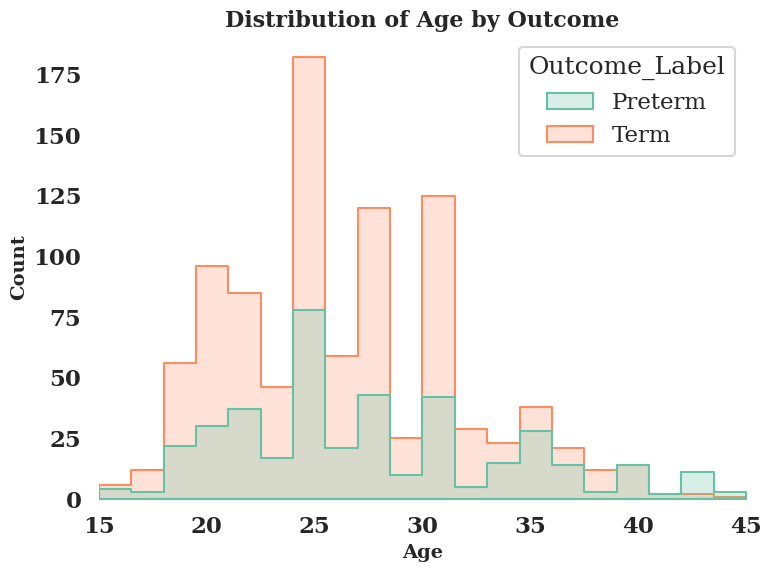

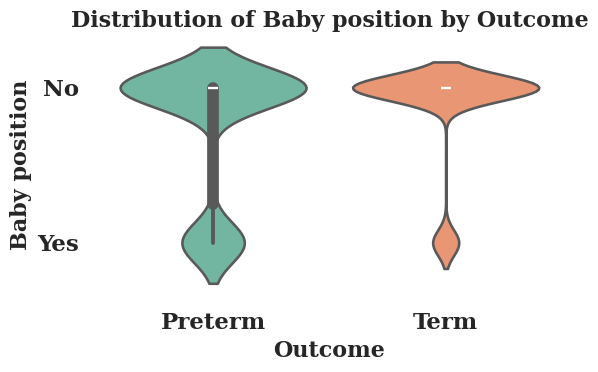

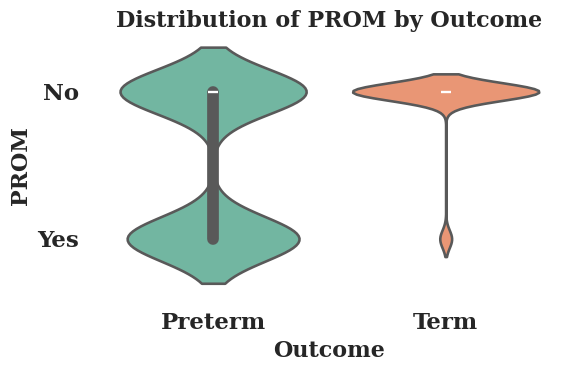

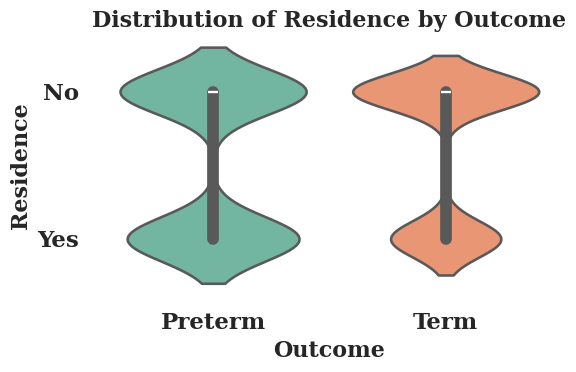

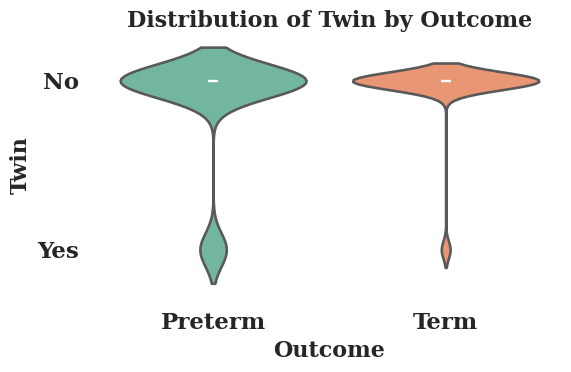

...

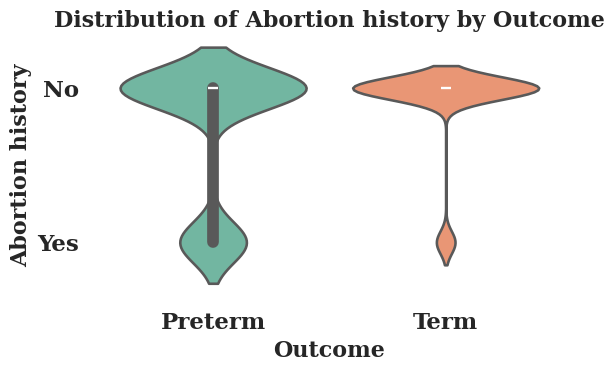

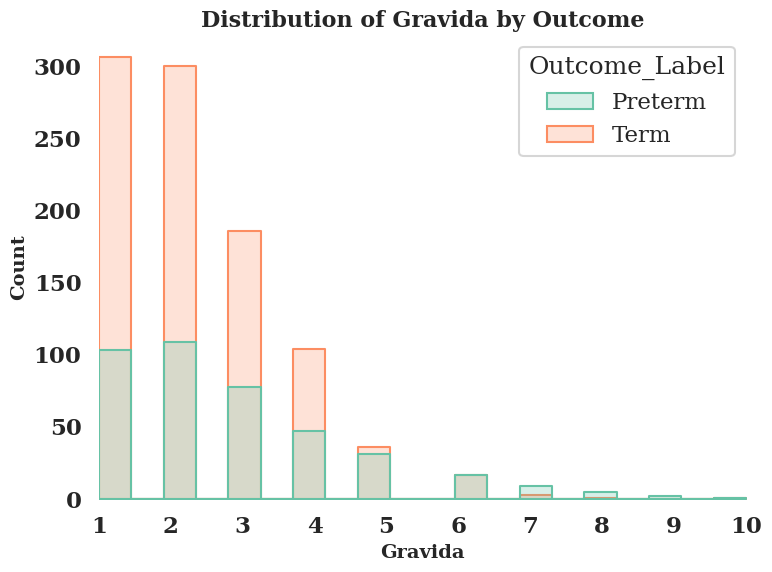

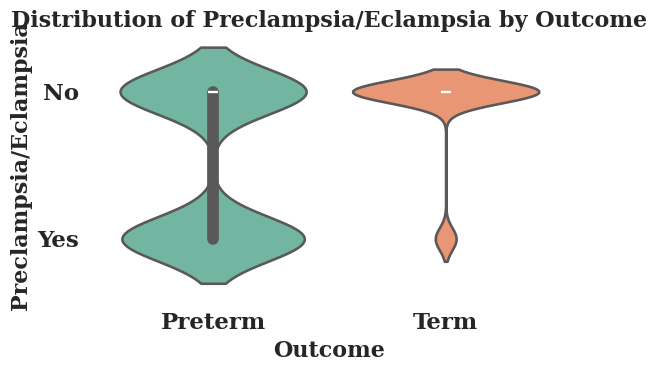

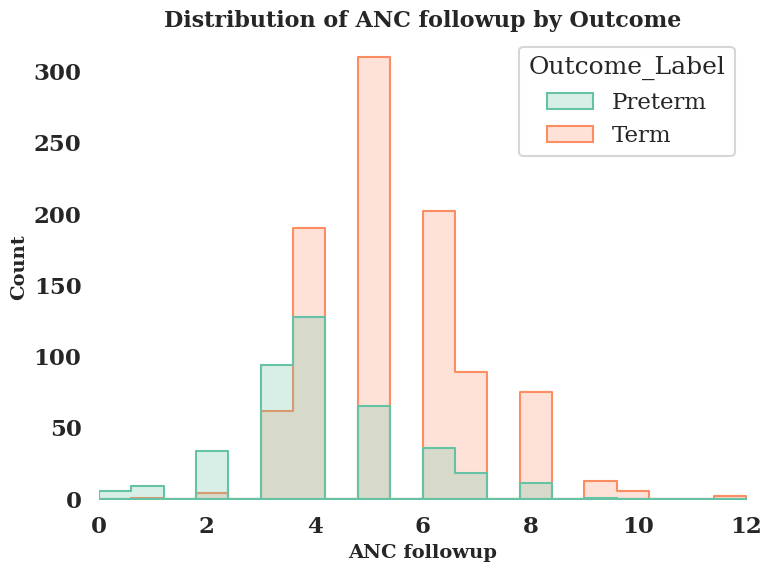

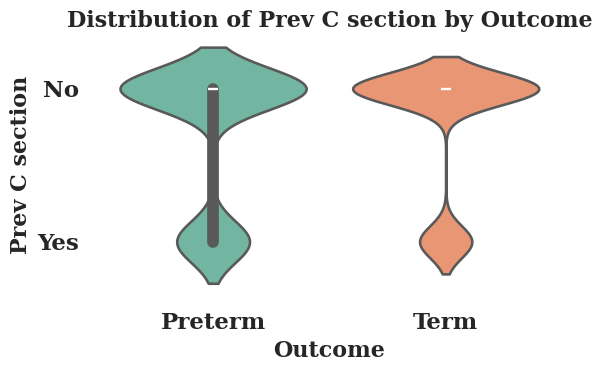

✅ All figures saved in high-quality TIFF format in: feature_vs_outcome_figures


In [ ]:
# ---------------------------------------
# Style for publication-ready figures
# ---------------------------------------
plt.rcParams.update({
    "font.family": "serif",
    "font.size": 16,
    "axes.labelweight": "bold",
    "axes.titlesize": 16,
    "axes.titleweight": "bold"
})

# ---------------------------------------
# Output directory for figures
# ---------------------------------------
output_dir = "feature_vs_outcome_figures"
os.makedirs(output_dir, exist_ok=True)

# ---------------------------------------
# Helper to clean filenames
# ---------------------------------------
def clean_filename(s):
    return re.sub(r'[\\/*?:"<>|,]', "_", s).replace(" ", "_")

# ---------------------------------------
# Select numeric columns (excluding Outcome)
# ---------------------------------------
numerical_cols = data.select_dtypes(include=np.number).columns.tolist()
if "Outcome" in numerical_cols:
    numerical_cols.remove("Outcome")

# ---------------------------------------
# Map outcome labels: 0 → Term, 1 → Preterm
# ---------------------------------------
data_plot = data.copy()
data_plot["Outcome_Label"] = data_plot["Outcome"].map({0: "Term", 1: "Preterm"})

# =======================================
# Generate one plot per numerical feature
# =======================================
for col in numerical_cols:
    unique_vals = data_plot[col].dropna().unique()
    max_val = data_plot[col].max()

    # ---- Case 1: Small-range integer → Violin plot ----
    if np.allclose(unique_vals, unique_vals.astype(int)) and max_val <= 3:

        # For binary variables with only 0 and 1: map y-axis values 0 -> No, 1 -> Yes
        if set(unique_vals).issubset({0, 1}):
            # Filter data to only 0 and 1 (in case of other values)
            df_filtered = data_plot[data_plot[col].isin([0,1])].copy()
            # Map values for plotting
            df_filtered[col + "_label"] = df_filtered[col].map({0: "No", 1: "Yes"})
            # Make it categorical with order to fix plot order
            df_filtered[col + "_label"] = pd.Categorical(df_filtered[col + "_label"], categories=["No", "Yes"])

            plt.figure(figsize=(6, 4))
            ax = sns.violinplot(
                x="Outcome_Label",
                y=col + "_label",
                data=df_filtered,
                palette="Set2",
                inner="box"
            )
            plt.ylabel(col, fontsize=16, fontweight='bold')

            # Explicitly set y-ticks and labels
            ax.set_yticks([0,1])
            ax.set_yticklabels(["No", "Yes"], fontweight='bold')

        else:
            # Use original column if not binary 0/1
            plt.figure(figsize=(6, 4))
            ax = sns.violinplot(
                x="Outcome",
                y=col,
                data=data_plot,
                palette="Set2",
                inner="box"
            )
            plt.ylabel(col, fontsize=16, fontweight='bold')

        # Styling
        plt.title(f'Distribution of {col} by Outcome', fontsize=16, fontweight='bold')
        plt.xlabel("Outcome", fontsize=16, fontweight='bold')
        plt.xticks(fontweight='bold')
        plt.yticks(fontweight='bold')
        sns.despine(left=True, bottom=True)
        ax.grid(False)

        # Save
        fname = os.path.join(output_dir, f"{clean_filename(col)}_violin_vs_outcome.tiff")
        plt.tight_layout()
        plt.savefig(fname, dpi=600, bbox_inches="tight")
        plt.show()
        plt.close()

    # ---- Case 2: Continuous → Histogram with count ----
    else:
        plt.figure(figsize=(8, 6))
        ax = sns.histplot(
            data=data_plot,
            x=col,
            hue="Outcome_Label",
            palette="Set2",
            element="step",       # outline bars
            stat="count",
            bins=20,
            common_norm=False
        )

        # Set X limits based on non-zero counts
        counts = data_plot.groupby(["Outcome", col]).size().reset_index(name="count")
        nonzero_vals = counts.loc[counts["count"] > 0, col].unique()
        if len(nonzero_vals) > 0:
            ax.set_xlim(min(nonzero_vals), max(nonzero_vals))

        # Styling
        plt.title(f'Distribution of {col} by Outcome', fontsize=16, fontweight='bold')
        plt.xlabel(col, fontsize=14, fontweight='bold')
        plt.ylabel('Count', fontsize=14, fontweight='bold')
        plt.xticks(fontweight='bold')
        plt.yticks(fontweight='bold')
        sns.despine(left=True, bottom=True)
        ax.grid(False)

        # Save
        fname = os.path.join(output_dir, f"{clean_filename(col)}_hist_vs_outcome.tiff")
        plt.tight_layout()
        plt.savefig(fname, dpi=600, bbox_inches="tight")
        plt.show()
        plt.close()

print("✅ All figures saved in high-quality TIFF format in:", output_dir)


####Bivariate

Correlation map

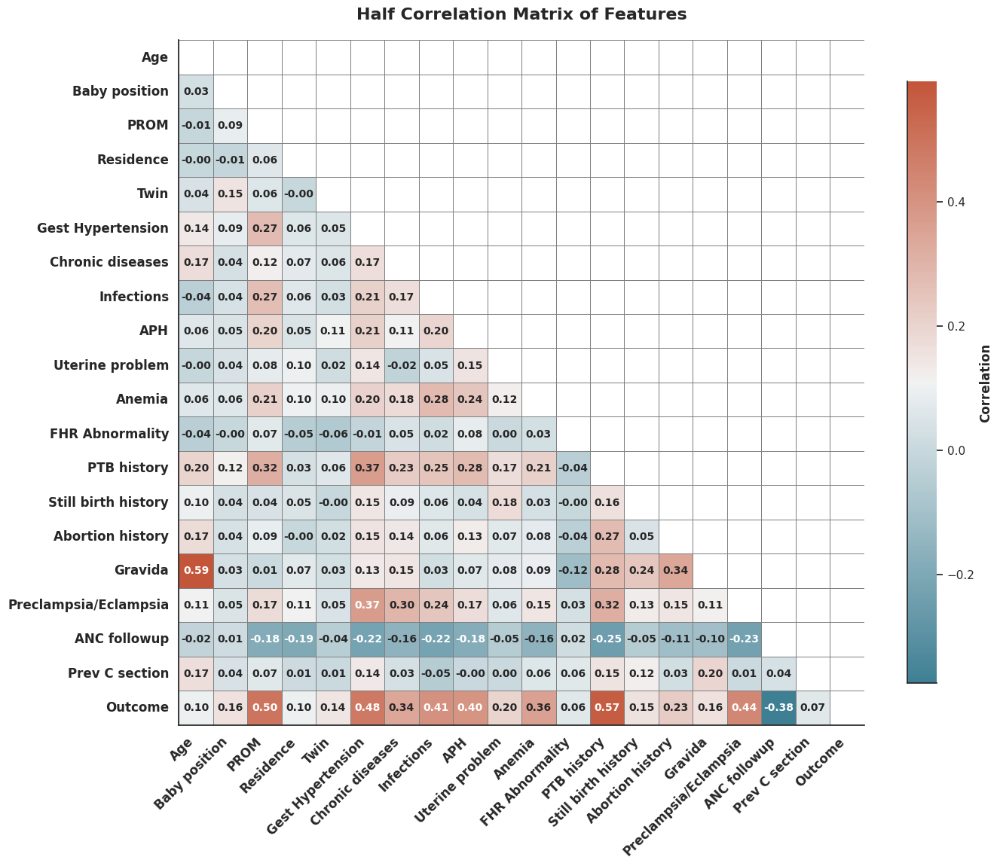

✅ Correlation heatmap saved as high-quality TIFF: figures/half_correlation_matrix.tiff


In [ ]:
# --- Ensure output folder exists ---
output_dir = "figures"
os.makedirs(output_dir, exist_ok=True)

# Ensure 'Outcome' column is numeric (0 for Term, 1 for Preterm)
# This handles cases where it might have been converted to strings ('Term', 'Preterm')
data['Outcome'] = data['Outcome'].replace({'Term': 0.0, 'Preterm': 1.0})
data['Outcome'] = pd.to_numeric(data['Outcome'], errors='coerce').astype(float)

# Handle potential NaNs created by coercion (if any) after conversion
# Given previous imputation steps, re-imputing the whole DataFrame might be necessary
if data['Outcome'].isnull().any():
    print("NaN values found in 'Outcome' after coercing. Re-imputing...")
    if 'mice_imputer' in locals():
         data_imputed_array = mice_imputer.fit_transform(data)
         data = pd.DataFrame(data_imputed_array, columns=data.columns)
         print("Data after re-imputation:")
         print(data.isnull().sum())
    else:
        print("Warning: mice_imputer not found. Manual imputation of 'Outcome' NaNs skipped.")
        # Simple fillna if imputer is not available
        data['Outcome'] = data['Outcome'].fillna(data['Outcome'].mode()[0])

# Drop the 'Birth Outcome' column as it contains string values and is not needed for correlation
if 'Birth Outcome' in data.columns:
    data = data.drop('Birth Outcome', axis=1)


# --- Compute correlation matrix ---
corr_matrix = data.corr()

# --- Generate a mask for the upper triangle ---
mask = np.triu(np.ones_like(corr_matrix, dtype=bool))

# --- plotting ---
plt.figure(figsize=(14, 12))
sns.set(style="white")

# Custom diverging colormap
cmap = sns.diverging_palette(220, 20, as_cmap=True)

# Draw the heatmap
ax = sns.heatmap(
    corr_matrix,
    mask=mask,
    annot=True,
    fmt=".2f",
    cmap=cmap,
    cbar_kws={"shrink": 0.8, "label": "Correlation"},
    square=True,
    linewidths=0.6,
    linecolor='gray',
    annot_kws={"size": 10, "weight": "bold"},
)

# Bold and readable labels
ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='right', fontsize=12, fontweight='bold')
ax.set_yticklabels(ax.get_yticklabels(), rotation=0, fontsize=12, fontweight='bold')

# Title
plt.title("Half Correlation Matrix of Features", fontsize=16, fontweight='bold', pad=20)

# Remove top/right spines for clean look
sns.despine(top=True, right=True, left=False, bottom=False)

# Tight layout
plt.tight_layout()

# Save high-resolution TIFF
save_path = os.path.join(output_dir, "half_correlation_matrix.tiff")
plt.savefig(save_path, dpi=600, bbox_inches="tight")
plt.show()

print(f"✅ Correlation heatmap saved as high-quality TIFF: {save_path}")

###Class Balancing

Class distribution graph

Class distribution for 'Outcome':
Outcome
0.0    954
1.0    402
Name: count, dtype: int64


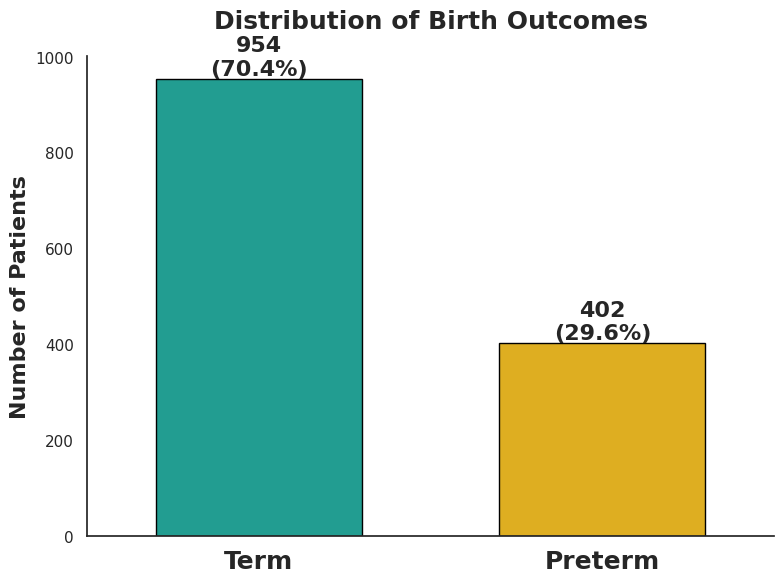

✅ Lancet-style distribution plot saved: figures/Outcome_distribution_lancet_style.tiff


In [ ]:
# --- Ensure output folder exists ---
output_dir = "figures"
os.makedirs(output_dir, exist_ok=True)

# --- Specify target column ---
target_column = 'Outcome'

if target_column in data.columns:
    # --- Compute class distribution ---
    class_distribution = data[target_column].value_counts().sort_index()
    total = class_distribution.sum()
    print(f"Class distribution for '{target_column}':")
    print(class_distribution)

    # --- Professional style ---
    sns.set_theme(style="white")
    plt.figure(figsize=(8, 6))

    # Colors: Term = teal, Preterm = amber
    palette = {0: "#0db2a2", 1: "#febd01"}

    # Barplot
    ax = sns.barplot(
        x=class_distribution.index,
        y=class_distribution.values,
        palette=[palette[val] for val in class_distribution.index],
        edgecolor='black',
        width=0.6
    )

    # Annotate counts + percentages
    for p, val in zip(ax.patches, class_distribution.values):
        height = p.get_height()
        percent = (val / total) * 100
        ax.annotate(
            f'{val:,}\n({percent:.1f}%)',
            (p.get_x() + p.get_width() / 2., height),
            ha='center', va='bottom',
            fontsize=16, fontweight='bold'
        )

    # Title and labels
    ax.set_title("Distribution of Birth Outcomes", fontsize=18, fontweight='bold', pad=20)
    ax.set_xlabel("", fontsize=0)  # remove default label
    ax.set_ylabel("Number of Patients", fontsize=16, fontweight='bold')

    # Replace tick labels with clinical terms
    ax.set_xticks(range(len(class_distribution.index)))
    ax.set_xticklabels(["Term", "Preterm"], fontsize=18, fontweight='bold')

    # Remove unnecessary spines
    sns.despine(left=False, bottom=False)

    # Remove gridlines for cleaner look
    ax.grid(False)

    plt.tight_layout()

    # Save high-resolution TIFF
    save_path = os.path.join(output_dir, f"{target_column}_distribution_lancet_style.tiff")
    plt.savefig(save_path, dpi=600, bbox_inches="tight", transparent=True)
    plt.show()

    print(f"✅ Lancet-style distribution plot saved: {save_path}")

else:
    print(f"Target column '{target_column}' not found in the DataFrame.")


Class balancing using cost-sensitive learning

Cost- sensitive learning for ML models

In [ ]:
# Define features (X) and target (y)
X = data.drop('Outcome', axis=1)
y = data['Outcome']
# Calculate class weights for cost-sensitive learning
class_counts = y.value_counts()
# Calculate weights inversely proportional to class frequencies
# This gives more weight to the minority class
class_weights = {
    0: len(y) / (2 * class_counts[0]),
    1: len(y) / (2 * class_counts[1])
}

print("Calculated class weights:")
print(class_weights)

Calculated class weights:
{0: np.float64(0.710691823899371), 1: np.float64(1.6865671641791045)}


Cost sensitive learning for Transformer based models

In [ ]:
class_counts = y.value_counts()
weight_0 = 1.0
weight_1 = class_counts[0] / class_counts[1]
class_weights_list = [weight_0, weight_1]
class_weights_tensor = torch.tensor(class_weights_list, dtype=torch.float32)

Plotting weights

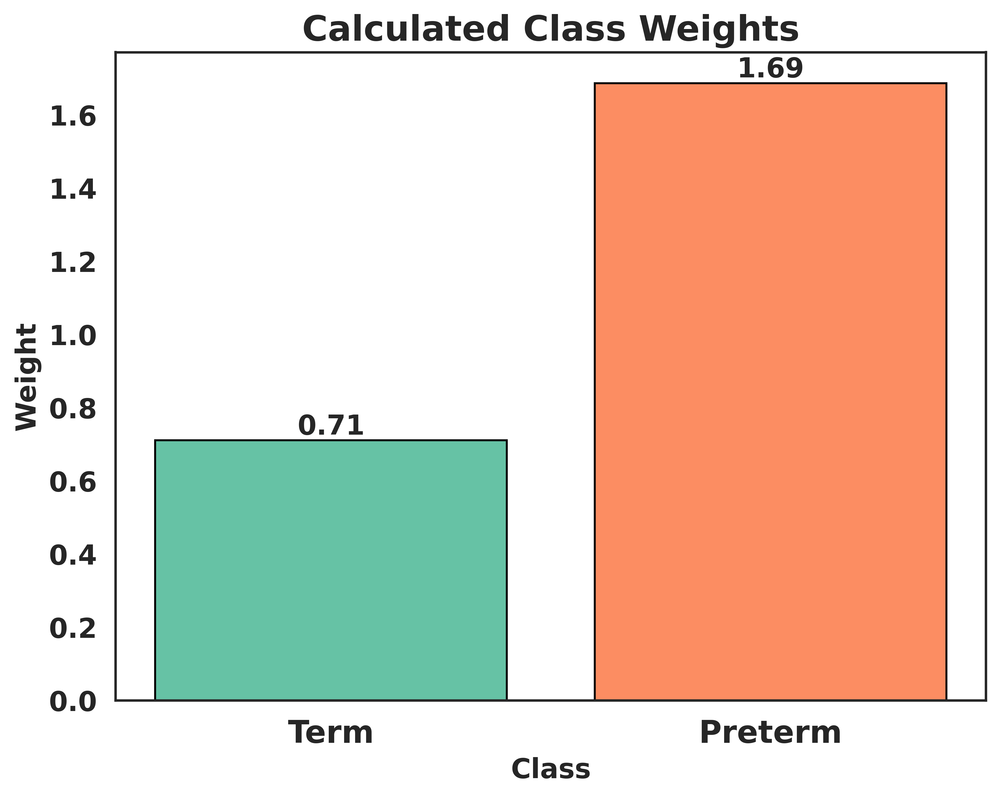

In [ ]:
# Use seaborn style
sns.set_style("white")

# Update matplotlib parameters for bold and larger fonts
plt.rcParams.update({
    "font.size": 14,              # Base font size
    "axes.titlesize": 18,         # Title size
    "axes.labelsize": 16,         # Axis label size
    "xtick.labelsize": 14,        # X tick size
    "ytick.labelsize": 14,        # Y tick size
    "figure.dpi": 600,
    "font.weight": "bold",
    "axes.labelweight": "bold"
})

# Plot class weights
plt.figure(figsize=(8, 6))
bars = plt.bar(class_weights.keys(), class_weights.values(),
               color=["#66c2a5", "#fc8d62"], edgecolor="black")

# Title and axis labels with bold font
plt.title("Calculated Class Weights", fontweight='bold', fontsize=18)
plt.xlabel("Class", fontweight='bold', fontsize=14)
plt.ylabel("Weight", fontweight='bold', fontsize=14)

# Custom x-tick labels with bold font
plt.xticks([0, 1], ["Term", "Preterm"], fontweight='bold', fontsize=16)
plt.yticks(fontweight='bold', fontsize=14)

# Add exact values on top of bars
for bar in bars:
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width() / 2., height,
             f'{height:.2f}', ha='center', va='bottom',
             fontsize=14, fontweight='bold')

# Save high-quality figure
plt.savefig("class_weights_graph.tiff", dpi=600, bbox_inches="tight")

# Show plot
plt.show()


###Data splitting

In [ ]:

#Splitting data into train and test sets
X_train, X_test, y_train, y_test = train_test_split(
    X, y,
    test_size=0.2,
    random_state=42,
    stratify=y  # Stratify to maintain class distribution
)

# Set up 10-fold cross-validation
cv = KFold(n_splits=10, shuffle=True, random_state=42)

print(f"Shape of X_train: {X_train.shape}")
print(f"Shape of X_test: {X_test.shape}")
print(f"Shape of y_train: {y_train.shape}")
print(f"Shape of y_test: {y_test.shape}")

Shape of X_train: (1084, 19)
Shape of X_test: (272, 19)
Shape of y_train: (1084,)
Shape of y_test: (272,)


###Data Transformation

In [ ]:
# Initialize the PowerTransformer with the 'yeo-johnson' method
pt = PowerTransformer(method='yeo-johnson', standardize=True)
X_train = pt.fit_transform(X_train)
X_test = pt.transform(X_test)

###Data Normalization

In [ ]:
from sklearn.preprocessing import StandardScaler
# Initialize the StandardScaler
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

##MODEL DEVELOPMENT

###Model Training and Evaluation

In [ ]:
from huggingface_hub import login

# Please create your own HF_token for TabPFN in hugging face, otherwise It won't run
login()

ML models

In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.base import clone

# -------------------------
# Prepare data
# -------------------------
try:
    y_full = y.copy()
except NameError:
    if 'Outcome' in X.columns:
        y_full = X['Outcome'].copy()
        X = X.drop(columns=['Outcome'])
    else:
        raise NameError("No target found: define `y` or include 'Outcome' column in X.")

X_full = pd.DataFrame(X).reset_index(drop=True)
y_full = pd.Series(y_full).reset_index(drop=True)
X_full.columns = ["".join(c if str(c).isalnum() or c in ['_', '.'] else '_' for c in str(col)) for col in X_full.columns]

# -------------------------
# Train/Test split
# -------------------------
X_train, X_test, y_train, y_test = train_test_split(
    X_full, y_full, test_size=0.2, stratify=y_full, random_state=42
)

# -------------------------
# Device
# -------------------------
device = 'cuda' if torch.cuda.is_available() else 'cpu'
print(f"🖥️ Using device: {device}")

# -------------------------
# Base models with specified hyperparameters
# -------------------------
base_models = {
    "Random Forest": RandomForestClassifier(
        n_estimators=500,
        max_depth=15,
        min_samples_split=5,
        min_samples_leaf=2,
        max_features='sqrt',
        bootstrap=True,
        random_state=42
    ),
    "XGBoost": xgb.XGBClassifier(
        n_estimators=500,
        max_depth=6,
        learning_rate=0.05,
        subsample=0.8,
        colsample_bytree=0.8,
        use_label_encoder=False,
        eval_metric='logloss',
        random_state=42
    ),
    "CatBoost": CatBoostClassifier(
        iterations=500,
        depth=6,
        learning_rate=0.05,
        l2_leaf_reg=3,
        verbose=0,
        random_state=42
    ),
    "LightGBM": lgb.LGBMClassifier(
        n_estimators=500,
        max_depth=15,
        learning_rate=0.05,
        num_leaves=64,
        colsample_bytree=0.8,
        subsample=0.8,
        random_state=42
    ),
    "TabPFN": TabPFNClassifier(device=device, ignore_pretraining_limits=True),
}

max_train_samples = 1024  # TabPFN training limit
all_model_results = {}

# -------------------------
# Train & evaluate each model
# -------------------------
for name, base_model in base_models.items():
    print(f"\n🔧 Training and evaluating: {name}")
    model = clone(base_model)

    # TabPFN training-size handling
    if name == "TabPFN" and X_train.shape[0] > max_train_samples:
        X_tr_fit = X_train.iloc[:max_train_samples]
        y_tr_fit = y_train.iloc[:max_train_samples]
    else:
        X_tr_fit = X_train
        y_tr_fit = y_train

    # Fit (some models may accept sample_weight; not used here)
    try:
        if name == "CatBoost":
            # CatBoost verbose already set to 0 in params
            model.fit(X_tr_fit, y_tr_fit)
        else:
            model.fit(X_tr_fit, y_tr_fit)
    except Exception as e:
        print(f"❗ Error fitting {name}: {e}")
        raise

    # Predict labels and probabilities
    try:
        y_pred = model.predict(X_test)
    except Exception as e:
        print(f"❗ Error predicting with {name}: {e}")
        raise

    # Probabilities
    if hasattr(model, "predict_proba"):
        try:
            y_proba = model.predict_proba(X_test)
            # If binary, take column 1; else leave as-is
            if y_proba.ndim == 2 and y_proba.shape[1] == 2:
                y_proba_pos = y_proba[:, 1]
            else:
                # multiclass or unexpected shape
                y_proba_pos = None
        except Exception:
            # TabPFN or other custom predict
            try:
                y_proba = model.predict(X_test, return_type='probabilities')
                y_proba_pos = y_proba[:, 1]
            except Exception:
                y_proba_pos = None
    else:
        # TabPFN-specific fallback
        try:
            y_proba = model.predict(X_test, return_type='probabilities')
            y_proba_pos = y_proba[:, 1]
        except Exception:
            y_proba_pos = None

    # Metrics
    acc = accuracy_score(y_test, y_pred)
    try:
        if y_proba_pos is not None:
            auc = roc_auc_score(y_test, y_proba_pos)
        else:
            auc = float('nan')
    except Exception:
        auc = float('nan')

    try:
        tn, fp, fn, tp = confusion_matrix(y_test, y_pred).ravel()
        sensitivity = tp / (tp + fn) if (tp + fn) > 0 else float('nan')
        specificity = tn / (tn + fp) if (tn + fp) > 0 else float('nan')
    except Exception:
        sensitivity = specificity = float('nan')

    try:
        clf_report = classification_report(y_test, y_pred)
    except Exception:
        clf_report = "Classification report could not be generated."

    # Save results
    all_model_results[name] = {
        "accuracy": acc,
        "auc": auc,
        "sensitivity": sensitivity,
        "specificity": specificity,
        "classification_report": clf_report,
        "y_true": y_test.values,
        "y_pred": y_pred,
        "y_proba_pos": y_proba_pos
    }

    # ROC plot (if binary and probabilities available)
    if y_proba_pos is not None and len(np.unique(y_test)) > 1:
        fpr, tpr, _ = roc_curve(y_test, y_proba_pos)
        plt.figure(figsize=(7, 6))
        plt.plot(fpr, tpr, lw=3, label=f'ROC curve (AUC = {auc:.3f})')
        plt.plot([0, 1], [0, 1], lw=2, linestyle='--')
        plt.xlabel('False Positive Rate')
        plt.ylabel('True Positive Rate')
        plt.title(f'ROC Curve — {name}')
        plt.legend(loc='lower right')
        plt.grid(False)
        plt.tight_layout()
        plt.savefig(f'ROC_{name.replace(" ", "_")}_test.tiff', dpi=600)
        plt.close()
    else:
        print(f"⚠️ No probability-based ROC for {name} (multiclass or missing probabilities).")

    # Print summary
    print(f"\nSummary for {name}:")
    print(f"  Accuracy   : {acc:.4f}")
    print(f"  AUC        : {auc if not np.isnan(auc) else 'nan'}")
    print(f"  Sensitivity: {sensitivity if not np.isnan(sensitivity) else 'nan'}")
    print(f"  Specificity: {specificity if not np.isnan(specificity) else 'nan'}")
    print("  Classification report:\n")
    print(clf_report)


🖥️ Using device: cpu

🔧 Training and testing Random Forest...
Summary for Random Forest:
  Accuracy   : 0.9118
  AUC        : 0.9620
  Sensitivity: 0.8395
  Specificity: 0.9424
  Classification report:

              precision    recall  f1-score   support

         0.0       0.93      0.94      0.94       191
         1.0       0.86      0.84      0.85        81

    accuracy                           0.91       272
   macro avg       0.90      0.89      0.89       272
weighted avg       0.91      0.91      0.91       272


🔧 Training and testing XGBoost...
Summary for XGBoost:
  Accuracy   : 0.9191
  AUC        : 0.9479
  Sensitivity: 0.8642
  Specificity: 0.9424
  Classification report:

              precision    recall  f1-score   support

         0.0       0.94      0.94      0.94       191
         1.0       0.86      0.86      0.86        81

    accuracy                           0.92       272
   macro avg       0.90      0.90      0.90       272
weighted avg       0.92     

TabNet

In [ ]:
# -------------------------
# FEATURES AND TARGET
# -------------------------
X = data.drop('Outcome', axis=1)
y = data['Outcome']

# Ensure target is integer type
y = y.astype(int)

# -------------------------
# CLASS WEIGHTS
# -------------------------
class_counts = y.value_counts()
weight_0 = 1.0
weight_1 = class_counts[0] / class_counts[1]  # inverse frequency
class_weights_list = [weight_0, weight_1]
print("Class weights:", class_weights_list)

# -------------------------
# TRAIN/TEST SPLIT
# -------------------------
X_train, X_test, y_train, y_test = train_test_split(
    X, y,
    test_size=0.2,
    random_state=42,
    stratify=y
)

X_train_np, X_test_np = X_train.values, X_test.values
y_train_np, y_test_np = y_train.values, y_test.values

# Ensure training labels are integers
y_train_np_int = y_train_np.astype(int)
y_test_np_int = y_test_np.astype(int)

print(f"✅ X_train shape: {X_train.shape}, y_train shape: {y_train.shape}")
print(f"✅ X_test shape : {X_test.shape}, y_test shape : {y_test.shape}")

# -------------------------
# DEVICE SETUP
# -------------------------
device = 'cuda' if torch.cuda.is_available() else 'cpu'
print(f"🖥️ Using device: {device}")

# -------------------------
# SAMPLE WEIGHTS FOR TRAINING
# -------------------------
sample_weights = np.array([class_weights_list[label] for label in y_train_np_int])

# -------------------------
# 10-FOLD STRATIFIED CV
# -------------------------
n_splits = 10
cv = StratifiedKFold(n_splits=n_splits, shuffle=True, random_state=42)

fold_accuracies, fold_aucs, fold_sensitivities, fold_specificities = [], [], [], []

print("\n🔧 Performing 10-fold Stratified CV with class weighting...\n")

for fold_idx, (train_idx, val_idx) in enumerate(cv.split(X_train_np, y_train_np_int), 1):
    X_tr, X_val = X_train_np[train_idx], X_train_np[val_idx]
    y_tr, y_val = y_train_np_int[train_idx], y_train_np_int[val_idx]

    fold_weights = sample_weights[train_idx]

    model = TabNetClassifier(
        device_name=device,
        verbose=0,
        optimizer_params=dict(lr=2e-2)
    )

    model.fit(
        X_tr, y_tr,
        eval_set=[(X_val, y_val)],
        patience=10,
        max_epochs=50,
        weights=fold_weights
    )

    # Predict
    y_val_pred = model.predict(X_val)
    y_val_proba = model.predict_proba(X_val)[:, 1]

    # Metrics
    acc = accuracy_score(y_val, y_val_pred)
    try:
        auc = roc_auc_score(y_val, y_val_proba)
    except Exception:
        auc = float('nan')

    try:
        tn, fp, fn, tp = confusion_matrix(y_val, y_val_pred).ravel()
        sens = tp / (tp + fn)
        spec = tn / (tn + fp)
    except Exception:
        sens = spec = float('nan')

    fold_accuracies.append(acc)
    fold_aucs.append(auc)
    fold_sensitivities.append(sens)
    fold_specificities.append(spec)

    print(f"Fold {fold_idx:02d}: Accuracy={acc:.4f}, AUC={auc:.4f}, Sensitivity={sens:.4f}, Specificity={spec:.4f}")

# CV Summary
print("\n📌 10-Fold CV Results (Training Set)")
print(f"Mean Accuracy   : {np.mean(fold_accuracies):.4f} ± {np.std(fold_accuracies):.4f}")
print(f"Mean AUC        : {np.nanmean(fold_aucs):.4f} ± {np.nanstd(fold_aucs):.4f}")
print(f"Mean Sensitivity: {np.mean(fold_sensitivities):.4f}")
print(f"Mean Specificity: {np.mean(fold_specificities):.4f}")

# -------------------------
# TRAIN FINAL MODEL ON FULL TRAINING SET
# -------------------------
print("\n🔧 Training final TabNet model on full training set...")
final_model = TabNetClassifier(
    device_name=device,
    verbose=0,
    optimizer_params=dict(lr=2e-2)
)

final_model.fit(
    X_train_np, y_train_np_int,
    eval_set=[(X_test_np, y_test_np_int)],
    patience=50,
    max_epochs=50,
    weights=sample_weights
)
print("✅ Final training complete.")

# -------------------------
# EVALUATE ON TEST SET
# -------------------------
y_test_pred = final_model.predict(X_test_np)
y_test_proba = final_model.predict_proba(X_test_np)[:, 1]

accuracy = accuracy_score(y_test_np_int, y_test_pred)
auc_score = roc_auc_score(y_test_np_int, y_test_proba)
try:
    tn, fp, fn, tp = confusion_matrix(y_test_np_int, y_test_pred).ravel()
    sensitivity = tp / (tp + fn)
    specificity = tn / (tn + fp)
except Exception:
    sensitivity = specificity = float('nan')

report_text = classification_report(y_test_np_int, y_test_pred)

# Print test results
print("\n" + "="*40)
print("📊 TEST SET PERFORMANCE")
print("="*40)
print(f"✅ Accuracy   : {accuracy:.4f}")
print(f"📈 Sensitivity: {sensitivity:.4f}")
print(f"📉 Specificity: {specificity:.4f}")
print(f"🎯 AUC        : {auc_score:.4f}")
print("\n📋 Full Classification Report:\n")
print(report_text)


Class weights: [1.0, np.float64(2.373134328358209)]
✅ X_train shape: (1084, 19), y_train shape: (1084,)
✅ X_test shape : (272, 19), y_test shape : (272,)
🖥️ Using device: cpu

🔧 Performing 10-fold Stratified CV with class weighting...


Early stopping occurred at epoch 10 with best_epoch = 0 and best_val_0_auc = 0.45754
Fold 01: Accuracy=0.3853, AUC=0.4575, Sensitivity=0.6364, Specificity=0.2763

Early stopping occurred at epoch 10 with best_epoch = 0 and best_val_0_auc = 0.40138
Fold 02: Accuracy=0.3119, AUC=0.4014, Sensitivity=0.5312, Specificity=0.2208

Early stopping occurred at epoch 10 with best_epoch = 0 and best_val_0_auc = 0.27273
Fold 03: Accuracy=0.2385, AUC=0.2727, Sensitivity=0.3750, Specificity=0.1818

Early stopping occurred at epoch 10 with best_epoch = 0 and best_val_0_auc = 0.28287
Fold 04: Accuracy=0.2385, AUC=0.2829, Sensitivity=0.3438, Specificity=0.1948

Early stopping occurred at epoch 10 with best_epoch = 0 and best_val_0_auc = 0.38569
Fold 05: Accuracy=0.3056, 

TabTransformer

In [ ]:
from torch.utils.data import TensorDataset, DataLoader, WeightedRandomSampler
X_train_np, X_test_np = X_train.values, X_test.values
y_train_np, y_test_np = y_train.values.astype(int), y_test.values.astype(int)

num_features = X_train.shape[1]
num_classes = len(np.unique(y_train_np))

device = 'cuda' if torch.cuda.is_available() else 'cpu'
print(f"🖥️ Using device: {device}")

# ------------------ Class Weights ------------------
class_counts = np.bincount(y_train_np)
weight_0 = 1.0
weight_1 = class_counts[0] / class_counts[1]
class_weights_list = [weight_0, weight_1]
print("Class weights:", class_weights_list)

# ------------------ TabTransformer Definition ------------------
class TabTransformer(nn.Module):
    def __init__(self, num_features, num_classes, dim=32, depth=2, heads=4, attn_dropout=0.1, ff_dropout=0.1):
        super().__init__()
        self.embedding = nn.Linear(num_features, dim)
        self.transformer = nn.TransformerEncoder(
            nn.TransformerEncoderLayer(
                d_model=dim, nhead=heads, dim_feedforward=dim*4, dropout=attn_dropout, batch_first=True
            ),
            num_layers=depth
        )
        self.mlp_head = nn.Sequential(
            nn.LayerNorm(dim),
            nn.Linear(dim, num_classes)
        )

    def forward(self, x):
        x = self.embedding(x.float())
        x = self.transformer(x.unsqueeze(1)).squeeze(1)
        return self.mlp_head(x)

# ------------------ 10-Fold Stratified CV ------------------
n_splits = 10
cv = StratifiedKFold(n_splits=n_splits, shuffle=True, random_state=42)

fold_metrics = []

epochs = 50
batch_size = 32

for fold_idx, (train_idx, val_idx) in enumerate(cv.split(X_train_np, y_train_np), 1):
    print(f"\n🔧 Fold {fold_idx} / {n_splits}")

    X_tr, X_val = X_train_np[train_idx], X_train_np[val_idx]
    y_tr, y_val = y_train_np[train_idx], y_train_np[val_idx]

    # Convert to tensors
    X_tr_tensor = torch.tensor(X_tr, dtype=torch.float32)
    y_tr_tensor = torch.tensor(y_tr, dtype=torch.long)
    X_val_tensor = torch.tensor(X_val, dtype=torch.float32)
    y_val_tensor = torch.tensor(y_val, dtype=torch.long)

    # ------------------ Weighted Sampler ------------------
    sample_weights = np.array([class_weights_list[label] for label in y_tr])
    sampler = WeightedRandomSampler(weights=sample_weights, num_samples=len(sample_weights), replacement=True)

    train_dataset = TensorDataset(X_tr_tensor, y_tr_tensor)
    train_loader = DataLoader(train_dataset, batch_size=batch_size, sampler=sampler)
    val_dataset = TensorDataset(X_val_tensor, y_val_tensor)
    val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)

    # ------------------ Model Init ------------------
    model = TabTransformer(num_features, num_classes).to(device)
    optimizer = torch.optim.Adam(model.parameters(), lr=1e-3)
    criterion = nn.CrossEntropyLoss()

    # ------------------ Training Loop ------------------
    model.train()
    for epoch in range(epochs):
        for inputs, labels in train_loader:
            inputs, labels = inputs.to(device), labels.to(device)
            optimizer.zero_grad()
            outputs = model(inputs)
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()

    # ------------------ Validation ------------------
    model.eval()
    all_preds, all_probs = [], []
    with torch.no_grad():
        for inputs, labels in val_loader:
            inputs = inputs.to(device)
            outputs = model(inputs)
            probs = torch.softmax(outputs, dim=1)
            _, preds = torch.max(probs, 1)
            all_preds.extend(preds.cpu().numpy())
            all_probs.extend(probs.cpu().numpy())

    y_true = y_val
    y_pred = np.array(all_preds)
    y_proba = np.array(all_probs)

    if num_classes == 2:
        y_proba_pos = y_proba[:, 1]
        acc = accuracy_score(y_true, y_pred)
        auc_score = roc_auc_score(y_true, y_proba_pos)
        report_dict = classification_report(y_true, y_pred, output_dict=True)
        negative_label, positive_label = sorted([str(l) for l in np.unique(y_true)])
        sensitivity = report_dict[positive_label]['recall']
        specificity = report_dict[negative_label]['recall']
    else:
        acc = accuracy_score(y_true, y_pred)
        auc_score = roc_auc_score(y_true, y_proba, multi_class='ovr', average='weighted')
        sensitivity = specificity = float('nan')

    fold_metrics.append((acc, auc_score, sensitivity, specificity))
    print(f"Fold {fold_idx} - Accuracy: {acc:.4f}, AUC: {auc_score:.4f}, Sensitivity: {sensitivity:.4f}, Specificity: {specificity:.4f}")

# ------------------ CV Summary ------------------
fold_metrics = np.array(fold_metrics)
print("\n📌 10-Fold CV Summary:")
print(f"Mean Accuracy   : {np.mean(fold_metrics[:,0]):.4f} ± {np.std(fold_metrics[:,0]):.4f}")
print(f"Mean AUC        : {np.mean(fold_metrics[:,1]):.4f} ± {np.std(fold_metrics[:,1]):.4f}")
print(f"Mean Sensitivity: {np.mean(fold_metrics[:,2]):.4f}")
print(f"Mean Specificity: {np.mean(fold_metrics[:,3]):.4f}")

# ------------------ Final Training on Full Training Set ------------------
X_train_tensor_full = torch.tensor(X_train_np, dtype=torch.float32)
y_train_tensor_full = torch.tensor(y_train_np, dtype=torch.long)
X_test_tensor_full = torch.tensor(X_test_np, dtype=torch.float32)
y_test_tensor_full = torch.tensor(y_test_np, dtype=torch.long)

sample_weights_full = np.array([class_weights_list[label] for label in y_train_np])
sampler_full = WeightedRandomSampler(weights=sample_weights_full, num_samples=len(sample_weights_full), replacement=True)
train_dataset_full = TensorDataset(X_train_tensor_full, y_train_tensor_full)
train_loader_full = DataLoader(train_dataset_full, batch_size=batch_size, sampler=sampler_full)
test_dataset_full = TensorDataset(X_test_tensor_full, y_test_tensor_full)
test_loader_full = DataLoader(test_dataset_full, batch_size=batch_size, shuffle=False)

final_model = TabTransformer(num_features, num_classes).to(device)
optimizer = torch.optim.Adam(final_model.parameters(), lr=1e-3)
criterion = nn.CrossEntropyLoss()

# Training final model
final_model.train()
for epoch in range(epochs):
    for inputs, labels in train_loader_full:
        inputs, labels = inputs.to(device), labels.to(device)
        optimizer.zero_grad()
        outputs = final_model(inputs)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()

# ------------------ Evaluate on Test Set ------------------
final_model.eval()
all_preds, all_probs = [], []
with torch.no_grad():
    for inputs, labels in test_loader_full:
        inputs = inputs.to(device)
        outputs = final_model(inputs)
        probs = torch.softmax(outputs, dim=1)
        _, preds = torch.max(probs, 1)
        all_preds.extend(preds.cpu().numpy())
        all_probs.extend(probs.cpu().numpy())

y_true_test = y_test_np
y_pred_test = np.array(all_preds)
y_proba_test = np.array(all_probs)

if num_classes == 2:
    y_proba_pos = y_proba_test[:,1]
    acc = accuracy_score(y_true_test, y_pred_test)
    auc_score = roc_auc_score(y_true_test, y_proba_pos)
    report_text = classification_report(y_true_test, y_pred_test)
    negative_label, positive_label = sorted([str(l) for l in np.unique(y_true_test)])
    sensitivity = classification_report(y_true_test, y_pred_test, output_dict=True)[positive_label]['recall']
    specificity = classification_report(y_true_test, y_pred_test, output_dict=True)[negative_label]['recall']
else:
    acc = accuracy_score(y_true_test, y_pred_test)
    auc_score = roc_auc_score(y_true_test, y_proba_test, multi_class='ovr', average='weighted')
    sensitivity = specificity = float('nan')
    report_text = classification_report(y_true_test, y_pred_test)

print("\n" + "="*40)
print("📊 TABTRANSFORMER FINAL TEST PERFORMANCE")
print("="*40)
print(f"Accuracy   : {acc:.4f}")
print(f"Sensitivity: {sensitivity:.4f}")
print(f"Specificity: {specificity:.4f}")
print(f"AUC        : {auc_score:.4f}")
print("\n📋 Full Classification Report:\n")
print(report_text)

🖥️ Using device: cpu
Class weights: [1.0, np.float64(2.3769470404984423)]

🔧 Fold 1 / 10
Fold 1 - Accuracy: 0.8440, AUC: 0.8872, Sensitivity: 0.7576, Specificity: 0.8816

🔧 Fold 2 / 10
Fold 2 - Accuracy: 0.8899, AUC: 0.9578, Sensitivity: 0.8438, Specificity: 0.9091

🔧 Fold 3 / 10
Fold 3 - Accuracy: 0.9083, AUC: 0.9302, Sensitivity: 0.8438, Specificity: 0.9351

🔧 Fold 4 / 10
Fold 4 - Accuracy: 0.8624, AUC: 0.9574, Sensitivity: 0.9062, Specificity: 0.8442

🔧 Fold 5 / 10
Fold 5 - Accuracy: 0.8611, AUC: 0.9359, Sensitivity: 0.8750, Specificity: 0.8553

🔧 Fold 6 / 10
Fold 6 - Accuracy: 0.8426, AUC: 0.9219, Sensitivity: 0.9062, Specificity: 0.8158

🔧 Fold 7 / 10
Fold 7 - Accuracy: 0.8981, AUC: 0.9663, Sensitivity: 0.9688, Specificity: 0.8684

🔧 Fold 8 / 10
Fold 8 - Accuracy: 0.8704, AUC: 0.9260, Sensitivity: 0.9062, Specificity: 0.8553

🔧 Fold 9 / 10
Fold 9 - Accuracy: 0.8889, AUC: 0.9535, Sensitivity: 0.8750, Specificity: 0.8947

🔧 Fold 10 / 10
Fold 10 - Accuracy: 0.9352, AUC: 0.9622, Sensi

TabM

In [ ]:
# ------------------ Features and Target ------------------
X_np = X_train.values
y_np = y_train.values
X_test_np = X_test.values
y_test_np = y_test.values

device = 'cuda' if torch.cuda.is_available() else 'cpu'
print(f"🖥️ Using device: {device}")

# ------------------ TabM Definition ------------------
class TabM(nn.Module):
    def __init__(self, num_features, num_classes):
        super().__init__()
        self.layers = nn.Sequential(
            nn.Linear(num_features, 256),
            nn.ReLU(),
            nn.Dropout(0.2),
            nn.Linear(256, 128),
            nn.ReLU(),
            nn.Dropout(0.2),
            nn.Linear(128, num_classes)
        )

    def forward(self, x):
        return self.layers(x.float())

# ------------------ 10-Fold CV ------------------
n_splits = 10
cv = StratifiedKFold(n_splits=n_splits, shuffle=True, random_state=42)

fold_accuracies, fold_aucs, fold_sensitivities, fold_specificities = [], [], [], []

# Compute class weights for weighted sampling
class_counts = pd.Series(y_np).value_counts()
weight_0 = 1.0
weight_1 = class_counts[0] / class_counts[1]
class_weights_list = [weight_0, weight_1]
print(f"Class weights: {class_weights_list}\n")

print("🔧 Performing 10-Fold Stratified CV with Class Balancing...\n")

for fold_idx, (train_idx, val_idx) in enumerate(cv.split(X_np, y_np), 1):
    X_tr, X_val = X_np[train_idx], X_np[val_idx]
    y_tr, y_val = y_np[train_idx], y_np[val_idx]

    # Weighted sampler
    sample_weights = np.array([class_weights_list[label] for label in y_tr])
    sampler = WeightedRandomSampler(weights=sample_weights, num_samples=len(sample_weights), replacement=True)

    # DataLoaders
    train_dataset = TensorDataset(torch.tensor(X_tr, dtype=torch.float32),
                                  torch.tensor(y_tr, dtype=torch.long))
    val_dataset = TensorDataset(torch.tensor(X_val, dtype=torch.float32),
                                torch.tensor(y_val, dtype=torch.long))

    train_loader = DataLoader(train_dataset, batch_size=32, sampler=sampler)
    val_loader = DataLoader(val_dataset, batch_size=32, shuffle=False)

    # Model initialization
    num_features = X_tr.shape[1]
    num_classes = len(np.unique(y_tr))
    model = TabM(num_features, num_classes).to(device)

    optimizer = torch.optim.Adam(model.parameters(), lr=1e-3)
    criterion = nn.CrossEntropyLoss()

    # Training loop
    model.train()
    epochs = 50
    for epoch in range(epochs):
        for inputs, labels in train_loader:
            inputs, labels = inputs.to(device), labels.to(device)
            optimizer.zero_grad()
            outputs = model(inputs)
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()

    # Evaluation on validation fold
    model.eval()
    all_preds, all_probs = [], []
    with torch.no_grad():
        for inputs, labels in val_loader:
            inputs, labels = inputs.to(device), labels.to(device)
            outputs = model(inputs)
            probs = torch.softmax(outputs, dim=1)
            _, preds = torch.max(probs, 1)
            all_preds.extend(preds.cpu().numpy())
            all_probs.extend(probs.cpu().numpy())

    y_true = y_val
    y_pred = np.array(all_preds)
    y_proba = np.array(all_probs)

    if len(np.unique(y_true)) == 2:
        y_proba_pos = y_proba[:, 1]
        report_dict = classification_report(y_true, y_pred, output_dict=True)
        negative_label, positive_label = sorted([label for label in report_dict.keys() if label not in ['accuracy','macro avg','weighted avg']])
        sensitivity = report_dict[positive_label]['recall']
        specificity = report_dict[negative_label]['recall']
        auc_score = roc_auc_score(y_true, y_proba_pos)
    else:
        sensitivity = specificity = float('nan')
        auc_score = roc_auc_score(y_true, y_proba, multi_class='ovr', average='weighted')

    acc = accuracy_score(y_true, y_pred)

    fold_accuracies.append(acc)
    fold_aucs.append(auc_score)
    fold_sensitivities.append(sensitivity)
    fold_specificities.append(specificity)

    print(f"Fold {fold_idx:02d}: Accuracy={acc:.4f}, AUC={auc_score:.4f}, Sensitivity={sensitivity:.4f}, Specificity={specificity:.4f}")

# ------------------ CV Summary ------------------
print("\n📌 10-Fold CV Results")
print(f"Mean Accuracy   : {np.mean(fold_accuracies):.4f} ± {np.std(fold_accuracies):.4f}")
print(f"Mean AUC        : {np.mean(fold_aucs):.4f} ± {np.std(fold_aucs):.4f}")
print(f"Mean Sensitivity: {np.mean(fold_sensitivities):.4f}")
print(f"Mean Specificity: {np.mean(fold_specificities):.4f}")

# ------------------ Train Final Model on Full Training Set ------------------
print("\n🔧 Training final model on full training set with class balancing...")
full_sample_weights = np.array([class_weights_list[label] for label in y_np])
full_sampler = WeightedRandomSampler(weights=full_sample_weights, num_samples=len(full_sample_weights), replacement=True)

train_dataset_full = TensorDataset(torch.tensor(X_np, dtype=torch.float32),
                                   torch.tensor(y_np, dtype=torch.long))
train_loader_full = DataLoader(train_dataset_full, batch_size=32, sampler=full_sampler)

final_model = TabM(num_features, num_classes).to(device)
optimizer = torch.optim.Adam(final_model.parameters(), lr=1e-3)
criterion = nn.CrossEntropyLoss()

final_model.train()
for epoch in range(epochs):
    for inputs, labels in train_loader_full:
        inputs, labels = inputs.to(device), labels.to(device)
        optimizer.zero_grad()
        outputs = final_model(inputs)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()

# ------------------ Evaluate on Test Set ------------------
final_model.eval()
all_preds, all_probs = [], []
with torch.no_grad():
    for inputs, labels in DataLoader(TensorDataset(torch.tensor(X_test_np, dtype=torch.float32),
                                                   torch.tensor(y_test_np, dtype=torch.long)),
                                     batch_size=32, shuffle=False):
        inputs = inputs.to(device)
        outputs = final_model(inputs)
        probs = torch.softmax(outputs, dim=1)
        _, preds = torch.max(probs, 1)
        all_preds.extend(preds.cpu().numpy())
        all_probs.extend(probs.cpu().numpy())

y_true = y_test_np
y_pred = np.array(all_preds)
y_proba = np.array(all_probs)

# Metrics
if len(np.unique(y_true)) == 2:
    y_proba_pos = y_proba[:, 1]
    report_dict = classification_report(y_true, y_pred, output_dict=True)
    negative_label, positive_label = sorted([label for label in report_dict.keys() if label not in ['accuracy','macro avg','weighted avg']])
    sensitivity = report_dict[positive_label]['recall']
    specificity = report_dict[negative_label]['recall']
    auc_score = roc_auc_score(y_true, y_proba_pos)
else:
    sensitivity = specificity = float('nan')
    auc_score = roc_auc_score(y_true, y_proba, multi_class='ovr', average='weighted')

accuracy = accuracy_score(y_true, y_pred)
report_text = classification_report(y_true, y_pred)

# Print final test metrics
print("\n" + "="*40)
print("📊 FINAL TEST SET PERFORMANCE")
print("="*40)
print(f"✅ Accuracy   : {accuracy:.4f}")
print(f"📈 Sensitivity: {sensitivity:.4f}")
print(f"📉 Specificity: {specificity:.4f}")
print(f"🎯 AUC        : {auc_score:.4f}")
print("\n📋 Classification Report:\n")
print(report_text)

🖥️ Using device: cpu
Class weights: [1.0, np.float64(2.3769470404984423)]

🔧 Performing 10-Fold Stratified CV with Class Balancing...

Fold 01: Accuracy=0.8165, AUC=0.8772, Sensitivity=0.7576, Specificity=0.8421
Fold 02: Accuracy=0.8716, AUC=0.9505, Sensitivity=0.9375, Specificity=0.8442
Fold 03: Accuracy=0.9083, AUC=0.9115, Sensitivity=0.8125, Specificity=0.9481
Fold 04: Accuracy=0.8716, AUC=0.9558, Sensitivity=0.9062, Specificity=0.8571
Fold 05: Accuracy=0.8611, AUC=0.9342, Sensitivity=0.7188, Specificity=0.9211
Fold 06: Accuracy=0.9074, AUC=0.9124, Sensitivity=0.8125, Specificity=0.9474
Fold 07: Accuracy=0.9259, AUC=0.9712, Sensitivity=0.9375, Specificity=0.9211
Fold 08: Accuracy=0.8796, AUC=0.9025, Sensitivity=0.9062, Specificity=0.8684
Fold 09: Accuracy=0.8796, AUC=0.9437, Sensitivity=0.8438, Specificity=0.8947
Fold 10: Accuracy=0.9259, AUC=0.9770, Sensitivity=0.8438, Specificity=0.9605

📌 10-Fold CV Results
Mean Accuracy   : 0.8848 ± 0.0317
Mean AUC        : 0.9336 ± 0.0304
Mean 

###Model Performance Visualization

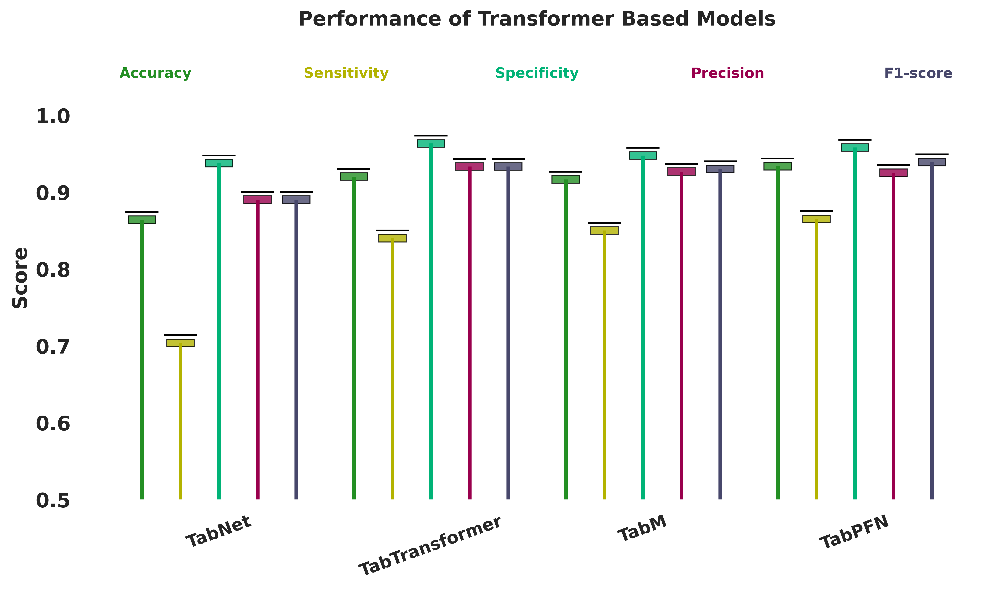

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# --- Model performance data ---
data = {
    'Model': ['TabNet', 'TabTransformer', 'TabM', 'TabPFN'],
    'Accuracy': [0.8640, 0.9201, 0.9228, 0.9338],
    'Sensitivity': [0.7037, 0.8401, 0.85, 0.865],
    'Specificity': [0.9376, 0.9634, 0.9476,0.9581],
    'Precision': [0.89, 0.9333, 0.9265, 0.925],
    'F1-score': [0.89, 0.9333, 0.9299,0.939]
}

df = pd.DataFrame(data)

# --- Figure setup ---
plt.figure(figsize=(10, 6))
index = np.arange(len(df['Model']))
width = 0.13  # candle body width

# --- Colors for each metric ---
colors = ['#248f24', '#b3b300', '#00b377', '#99004d', '#47476b']
metrics = ['Accuracy', 'Sensitivity', 'Specificity', 'Precision', 'F1-score']

# --- Plot bars ---
for i, metric in enumerate(metrics):
    offset = (i - 2) * width * 1.4   # shift each metric around the model
    x_positions = index + offset

    # Candle body (±0.005 around the metric value)
    body_bottom = df[metric] - 0.005
    body_top = df[metric] + 0.005
    plt.bar(
        x_positions,
        body_top - body_bottom,
        bottom=body_bottom,
        width=width,
        color=colors[i],
        alpha=0.8,
        edgecolor="black",
        linewidth=0.7
    )

    # Wick line (0 up to metric value)
    plt.vlines(x_positions, ymin=0, ymax=df[metric], color=colors[i], linewidth=2.5)

    # T-shaped cap on top
    cap_size = width * 1.2
    plt.hlines(df[metric] + 0.01, x_positions - cap_size / 2, x_positions + cap_size / 2,
               color="black", linewidth=1.2)

# --- Add spaced metric names on top (colored) ---
x_min = index[0] - 0.3
x_max = index[-1] + 0.3
label_x_positions = np.linspace(x_min, x_max, len(metrics))

for x, metric, color in zip(label_x_positions, metrics, colors):
    plt.text(x, 1.045, metric, ha='center', va='bottom',
             fontsize=10, fontweight='bold', rotation=0, color=color)

# --- Axis labels and title ---
plt.xticks(index, df['Model'],rotation = 20, fontsize=12, fontweight='bold')
plt.ylabel('Score', fontsize=14, fontweight='bold')
plt.ylim(0.5, 1.08)  # add vertical space for metric names
plt.title('Performance of Transformer Based Models', fontsize=14, fontweight='bold', pad=20)
plt.box(False)

# --- Tight layout ---
plt.tight_layout()

# --- Save high-resolution figure ---
plt.savefig('tabular_models_candlestick_colored_metric_labels.tiff', dpi=600, bbox_inches='tight')
plt.show()


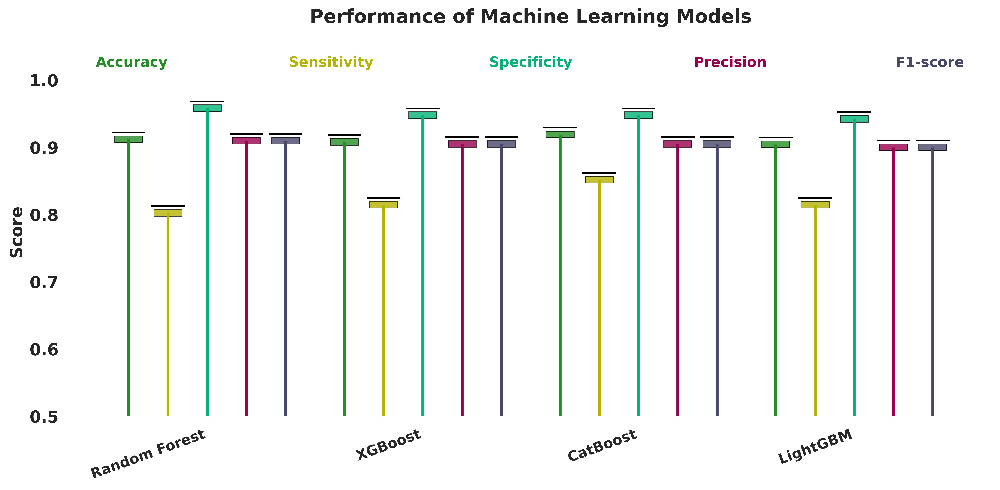

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# --- Model performance data ---
data = {
    'Model': ['Random Forest', 'XGBoost', 'CatBoost', 'LightGBM'],
    'Accuracy': [0.9118, 0.9081, 0.9191, 0.9044],
    'Sensitivity': [0.8025, 0.8148, 0.8519, 0.8148],
    'Specificity': [0.9581, 0.9476, 0.9476, 0.9424],
    'Precision': [0.91, 0.905, 0.905, 0.90],
    'F1-score': [0.91, 0.905, 0.905, 0.90]
}

df = pd.DataFrame(data)

# --- Figure setup ---
plt.figure(figsize=(12, 6))
index = np.arange(len(df['Model']))
width = 0.13  # candle body width

# --- Colors for each metric ---
colors = ['#248f24', '#b3b300', '#00b377', '#99004d', '#47476b']
metrics = ['Accuracy', 'Sensitivity', 'Specificity', 'Precision', 'F1-score']

# --- Plot candlesticks ---
for i, metric in enumerate(metrics):
    offset = (i - 2) * width * 1.4   # spread them out per model
    x_positions = index + offset

    # Candle body (rectangle around the metric value ±0.005)
    body_bottom = df[metric] - 0.005
    body_top = df[metric] + 0.005
    plt.bar(
        x_positions,
        body_top - body_bottom,
        bottom=body_bottom,
        width=width,
        color=colors[i],
        alpha=0.8,
        edgecolor="black",
        linewidth=0.7
    )

    # Wick line (0 up to metric value)
    plt.vlines(x_positions, ymin=0, ymax=df[metric], color=colors[i], linewidth=2.5)

    # T-shaped cap at the top
    cap_size = width * 1.2
    plt.hlines(df[metric] + 0.01, x_positions - cap_size / 2, x_positions + cap_size / 2,
               color="black", linewidth=1.2)

# --- Add spaced metric names on top (colored) ---
x_min = index[0] - 0.35
x_max = index[-1] + 0.35
label_x_positions = np.linspace(x_min, x_max, len(metrics))

for x, metric, color in zip(label_x_positions, metrics, colors):
    plt.text(x, 1.015, metric, ha='center', va='bottom',
             fontsize=12, fontweight='bold', rotation=0, color=color)

# --- Labels and title ---
plt.xticks(index, df['Model'], rotation=20, ha='right', fontsize=12, fontweight='bold')
plt.ylabel('Score', fontsize=14, fontweight='bold')
plt.ylim(0.5, 1.05)  # Increased to make room for colored labels
plt.title('Performance of Machine Learning Models', fontsize=16, fontweight='bold', pad=20)


# --- Clean style ---
#plt.grid(axis='y', linestyle='--', alpha=0.3)
plt.box(False)

plt.tight_layout()
plt.savefig('ml_models_candlestick_colored_labels.tiff', dpi=600, bbox_inches='tight')
plt.show()


ROC Curve

Using device: cpu
Training TabM...
TabM Epoch 1/10 - Loss: 0.3798
TabM Epoch 2/10 - Loss: 0.2412
TabM Epoch 3/10 - Loss: 0.2294
TabM Epoch 4/10 - Loss: 0.2159
TabM Epoch 5/10 - Loss: 0.2157
TabM Epoch 6/10 - Loss: 0.2059
TabM Epoch 7/10 - Loss: 0.1937
TabM Epoch 8/10 - Loss: 0.1900
TabM Epoch 9/10 - Loss: 0.1876
TabM Epoch 10/10 - Loss: 0.1832
Training TabTransformer...
TabTransformer Epoch 1/10 - Loss: 0.3064
TabTransformer Epoch 2/10 - Loss: 0.2529
TabTransformer Epoch 3/10 - Loss: 0.2336
TabTransformer Epoch 4/10 - Loss: 0.2366
TabTransformer Epoch 5/10 - Loss: 0.2251
TabTransformer Epoch 6/10 - Loss: 0.2110
TabTransformer Epoch 7/10 - Loss: 0.2117
TabTransformer Epoch 8/10 - Loss: 0.2038
TabTransformer Epoch 9/10 - Loss: 0.2002
TabTransformer Epoch 10/10 - Loss: 0.2027
Training TabNet (pytorch_tabnet)...
epoch 0  | loss: 0.95242 | valid_auc: 0.57967 |  0:00:00s
epoch 1  | loss: 0.67751 | valid_auc: 0.72697 |  0:00:01s
epoch 2  | loss: 0.57545 | valid_auc: 0.76789 |  0:00:02s
epoch 

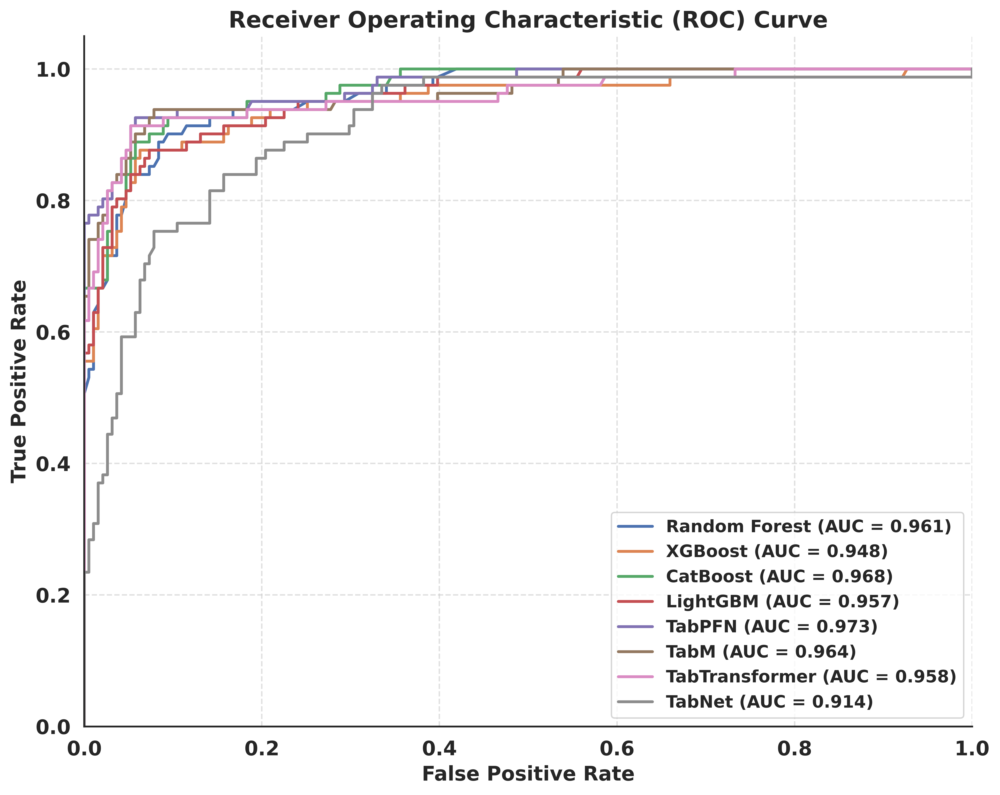

✅ ROC curve plot generated and saved as 'roc_final_curve_all_models_bold.tiff'


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:

import torch.nn as nn
from torch.utils.data import DataLoader, TensorDataset
from sklearn.metrics import roc_curve, roc_auc_score
from sklearn.preprocessing import label_binarize

# If running in notebooks/Colab and you want to download outputs:
try:
    from google.colab import files
    _HAS_COLAB = True
except Exception:
    _HAS_COLAB = False

# --- Optional: install pytorch-tabnet if missing (only in environments with internet)
try:
    from pytorch_tabnet.tab_model import TabNetClassifier
    _HAS_TABNET_LIB = True
except Exception:
    _HAS_TABNET_LIB = False
    try:
        # Try to install (works in Colab/normal pip-enabled environments)
        import subprocess
        subprocess.check_call([sys.executable, "-m", "pip", "install", "pytorch-tabnet"], stdout=subprocess.DEVNULL)
        from pytorch_tabnet.tab_model import TabNetClassifier
        _HAS_TABNET_LIB = True
    except Exception:
        _HAS_TABNET_LIB = False
        print("⚠ pytorch-tabnet not available. TabNet training will be skipped. "
              "To enable TabNet, install 'pytorch-tabnet' (pip install pytorch-tabnet).")

# ------------------ User-provided data requirement ------------------
# The code expects the following variables to exist in the workspace:
# X_train, X_test: pandas DataFrame (features)
# y_train, y_test: pandas Series or 1d array (labels)
# results: optional dict of classical model results (with 'y_proba' and 'auc')
#
# If these are not defined, the script will raise NameError.

# ------------------ Step 0: Prepare tensors & loaders ------------------
device = 'cuda' if torch.cuda.is_available() else 'cpu'
print(f"Using device: {device}")

# Convert (assumes X_train, X_test, y_train, y_test exist)
X_train_tensor = torch.tensor(X_train.values, dtype=torch.float32)
y_train_tensor = torch.tensor(y_train.values, dtype=torch.long)
X_test_tensor = torch.tensor(X_test.values, dtype=torch.float32)
y_test_tensor = torch.tensor(y_test.values, dtype=torch.long)

batch_size = 32
train_dataset = TensorDataset(X_train_tensor, y_train_tensor)
test_dataset = TensorDataset(X_test_tensor, y_test_tensor)

train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

num_features = X_train.shape[1]
classes = np.unique(y_train)
num_classes = len(classes)

# Helper to get y_true for metrics (numpy)
y_true = y_test_tensor.cpu().numpy()

# ------------------ Step 1: TabM (MLP-based) Definition ------------------
class TabM(nn.Module):
    def __init__(self, num_features, num_classes):
        super().__init__()
        self.layers = nn.Sequential(
            nn.Linear(num_features, 256),
            nn.ReLU(),
            nn.Dropout(0.2),
            nn.Linear(256, 128),
            nn.ReLU(),
            nn.Dropout(0.2),
            nn.Linear(128, num_classes)
        )
    def forward(self, x):
        return self.layers(x.float())

# Initialize TabM
tab_m_model = TabM(num_features, num_classes).to(device)
optimizer_tabm = torch.optim.Adam(tab_m_model.parameters(), lr=1e-3)
criterion = nn.CrossEntropyLoss()

# Training TabM
epochs = 10
print("Training TabM...")
for epoch in range(epochs):
    tab_m_model.train()
    running_loss = 0.0
    for inputs, labels in train_loader:
        inputs, labels = inputs.to(device), labels.to(device)
        optimizer_tabm.zero_grad()
        outputs = tab_m_model(inputs)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer_tabm.step()
        running_loss += loss.item() * inputs.size(0)
    epoch_loss = running_loss / len(train_loader.dataset)
    print(f"TabM Epoch {epoch+1}/{epochs} - Loss: {epoch_loss:.4f}")

# Evaluation TabM
tab_m_model.eval()
all_preds, all_probs = [], []
with torch.no_grad():
    for inputs, _ in test_loader:
        inputs = inputs.to(device)
        outputs = tab_m_model(inputs)
        probs = torch.softmax(outputs, dim=1)
        _, preds = torch.max(probs, 1)
        all_preds.extend(preds.cpu().numpy())
        all_probs.extend(probs.cpu().numpy())

y_pred_tabm = np.array(all_preds)
y_proba_tabm = np.array(all_probs)  # shape: (n_samples, num_classes)

# ------------------ Step 2: TabTransformer Definition ------------------
class TabTransformer(nn.Module):
    def __init__(self, num_features, num_classes, dim=64, depth=2, heads=4, attn_dropout=0.1, ff_dropout=0.1):
        super().__init__()
        # A simple embedding via linear layer then transformer encoder
        self.embedding = nn.Linear(num_features, dim)
        encoder_layer = nn.TransformerEncoderLayer(
            d_model=dim, nhead=heads, dim_feedforward=dim*4,
            dropout=attn_dropout, batch_first=True
        )
        self.transformer = nn.TransformerEncoder(encoder_layer, num_layers=depth)
        self.mlp_head = nn.Sequential(
            nn.LayerNorm(dim),
            nn.Linear(dim, num_classes)
        )
    def forward(self, x):
        # embed and run through transformer (treat features as a single token dimension)
        x = self.embedding(x.float())
        # using unsqueeze to create sequence dim of length 1 so transformer works
        x = self.transformer(x.unsqueeze(1)).squeeze(1)
        return self.mlp_head(x)

tab_transformer = TabTransformer(num_features, num_classes, dim=64, depth=2, heads=4).to(device)
optimizer_tt = torch.optim.Adam(tab_transformer.parameters(), lr=1e-3)

# Training TabTransformer
print("Training TabTransformer...")
for epoch in range(epochs):
    tab_transformer.train()
    running_loss = 0.0
    for inputs, labels in train_loader:
        inputs, labels = inputs.to(device), labels.to(device)
        optimizer_tt.zero_grad()
        outputs = tab_transformer(inputs)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer_tt.step()
        running_loss += loss.item() * inputs.size(0)
    epoch_loss = running_loss / len(train_loader.dataset)
    print(f"TabTransformer Epoch {epoch+1}/{epochs} - Loss: {epoch_loss:.4f}")

# Evaluation TabTransformer
tab_transformer.eval()
all_preds, all_probs = [], []
with torch.no_grad():
    for inputs, _ in test_loader:
        inputs = inputs.to(device)
        outputs = tab_transformer(inputs)
        probs = torch.softmax(outputs, dim=1)
        _, preds = torch.max(probs, 1)
        all_preds.extend(preds.cpu().numpy())
        all_probs.extend(probs.cpu().numpy())

y_pred_tt = np.array(all_preds)
y_proba_tt = np.array(all_probs)

# ------------------ Step 3: TabNet (via pytorch_tabnet) ------------------
y_proba_tabnet = None
y_pred_tabnet = None
auc_tabnet = None

if _HAS_TABNET_LIB:
    print("Training TabNet (pytorch_tabnet)...")
    # pytorch_tabnet expects numpy arrays
    X_train_np = X_train.values.astype(np.float32)
    y_train_np = y_train.values
    X_test_np = X_test.values.astype(np.float32)
    y_test_np = y_test.values

    # If binary classification, TabNetClassifier defaults to out_dim=1; ensure categorical_handling is not used here.
    tabnet_clf = TabNetClassifier(
        n_d=32, n_a=32, n_steps=3, gamma=1.3,
        optimizer_fn=torch.optim.Adam,
        optimizer_params=dict(lr=2e-3),
        mask_type='sparsemax'
    )

    # Fit (small number of epochs; increase for better performance)
    tabnet_clf.fit(
        X_train_np, y_train_np,
        eval_set=[(X_test_np, y_test_np)],
        eval_name=['valid'],
        eval_metric=['auc' if num_classes==2 else 'logloss'],
        max_epochs=epochs,
        patience=50,
        batch_size=batch_size,
        virtual_batch_size=16,
        num_workers=0,
        drop_last=False
    )

    # Predict probabilities
    proba = tabnet_clf.predict_proba(X_test_np)  # shape (n_samples, num_classes) for multiclass, or (n_samples,2) for binary
    y_proba_tabnet = np.array(proba)
    y_pred_tabnet = tabnet_clf.predict(X_test_np)

    try:
        if num_classes == 2:
            auc_tabnet = roc_auc_score(y_test_np, y_proba_tabnet[:, 1])
        else:
            auc_tabnet = roc_auc_score(y_test_np, y_proba_tabnet, multi_class="ovr", average="weighted")
    except Exception as e:
        print(f"⚠ Error computing TabNet AUC: {e}")
else:
    print("Skipping TabNet: 'pytorch_tabnet' not installed.")

# ------------------ Step 4: Collect all results ------------------
all_model_results = {}

# 4a: Classical models from 'results' dict (if provided in workspace)
if 'results' in locals():
    for name, res in results.items():
        try:
            if 'y_proba' in res and 'auc' in res:
                y_proba = res['y_proba']
                # Ensure 1D probs for binary
                all_model_results[name] = {'y_proba': np.array(y_proba), 'auc': float(res['auc'])}
            else:
                print(f"⚠ Missing 'y_proba' or 'auc' for {name}")
        except Exception as e:
            print(f"⚠ Error processing classical result {name}: {e}")

# 4b: TabM
try:
    if num_classes == 2:
        auc_tabm = roc_auc_score(y_true, y_proba_tabm[:, 1])
    else:
        auc_tabm = roc_auc_score(y_true, y_proba_tabm, multi_class="ovr", average="weighted")
    all_model_results['TabM'] = {'y_proba': y_proba_tabm, 'auc': auc_tabm}
except Exception as e:
    print(f"⚠ Error computing TabM AUC: {e}")

# 4c: TabTransformer
try:
    if num_classes == 2:
        auc_tt = roc_auc_score(y_true, y_proba_tt[:, 1])
    else:
        auc_tt = roc_auc_score(y_true, y_proba_tt, multi_class="ovr", average="weighted")
    all_model_results['TabTransformer'] = {'y_proba': y_proba_tt, 'auc': auc_tt}
except Exception as e:
    print(f"⚠ Error computing TabTransformer AUC: {e}")

# 4d: TabNet (if available)
if y_proba_tabnet is not None:
    try:
        all_model_results['TabNet'] = {'y_proba': y_proba_tabnet, 'auc': float(auc_tabnet) if auc_tabnet is not None else None}
    except Exception as e:
        print(f"⚠ Error adding TabNet results: {e}")

# ------------------ Step 5: Plot ROC curves ------------------
if not all_model_results:
    print("❌ No model results found for plotting.")
else:
    plt.figure(figsize=(10,8))
    sns.set_style("white")

    for name, res in all_model_results.items():
        y_proba_plot = res['y_proba']
        # If shape is (n_samples, n_classes), get positive class probs for binary
        if y_proba_plot.ndim == 2 and y_proba_plot.shape[1] == 2:
            y_proba_plot = y_proba_plot[:, 1]
        # For multiclass where we have full probs, compute macro/multiclass ROC handling by averaging per-class OVR curves is possible,
        # but here we plot a single weighted ROC via roc_curve on a single binary indicator if binary, else skip plotting if shape mismatch.
        try:
            fpr, tpr, _ = roc_curve(y_true, y_proba_plot)
            auc_val = res.get('auc', None)
            label_auc = f"{name} (AUC = {auc_val:.3f})" if auc_val is not None else name
            plt.plot(fpr, tpr, lw=2, label=label_auc)
        except Exception as e:
            # For multiclass, try to compute an OVR ROC for each class and average — but keep it simple here.
            print(f"⚠ Could not plot ROC for {name}: {e}")
    plt.xlim([0.0,1.0])
    plt.ylim([0.0,1.05])
    plt.xlabel('False Positive Rate', fontsize=14, fontweight='bold')
    plt.ylabel('True Positive Rate', fontsize=14, fontweight='bold')
    plt.title('Receiver Operating Characteristic (ROC) Curve', fontsize=16, fontweight='bold')

    legend = plt.legend(loc='lower right', fontsize=12)
    for text in legend.get_texts():
        text.set_fontweight('bold')

    plt.grid(True, linestyle='--', alpha=0.6)
    sns.despine()
    plt.tight_layout()

    out_name = 'roc_final_curve_all_models_bold.tiff'
    plt.savefig(out_name, dpi=600, bbox_inches='tight', format='tiff')
    plt.show()
    print(f"✅ ROC curve plot generated and saved as '{out_name}'")

    # Optional download in Colab
    if _HAS_COLAB:
        files.download(out_name)


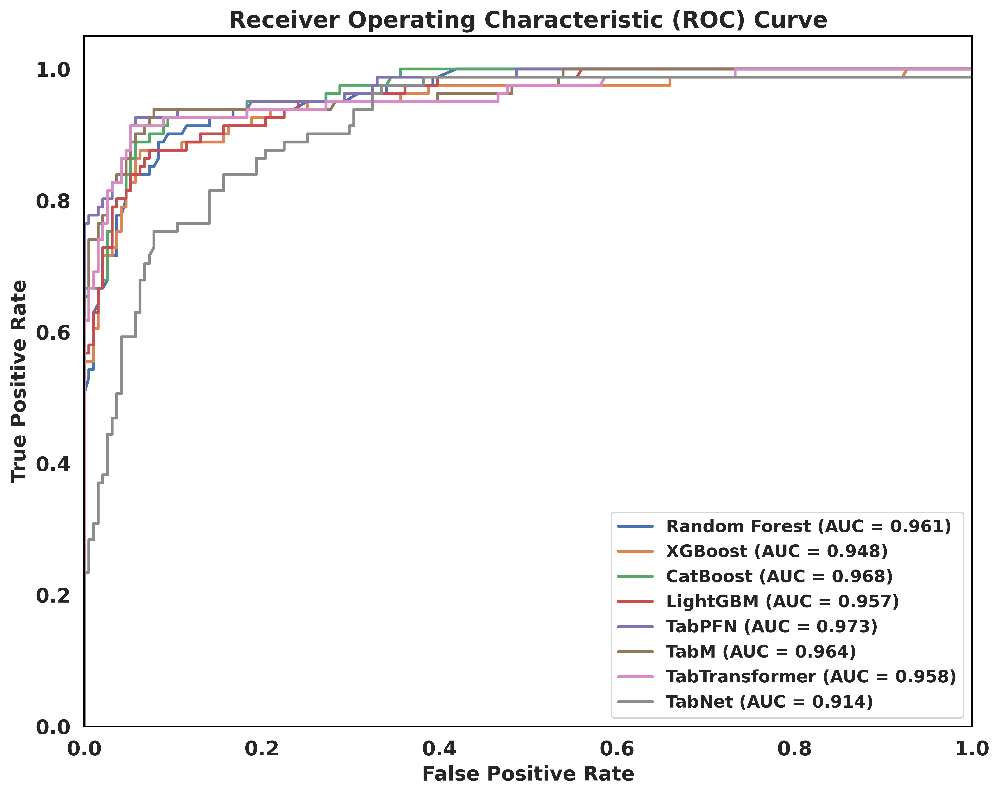

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import roc_curve

# ------------------------------
# Assumes these already exist:
# y_true, all_model_results
# ------------------------------

plt.figure(figsize=(10, 8))
sns.set_style("white")

for name, res in all_model_results.items():
    y_proba_plot = res['y_proba']
    if y_proba_plot.ndim == 2 and y_proba_plot.shape[1] == 2:
        y_proba_plot = y_proba_plot[:, 1]

    try:
        fpr, tpr, _ = roc_curve(y_true, y_proba_plot)
        auc_val = res.get('auc', None)
        label_auc = f"{name} (AUC = {auc_val:.3f})" if auc_val is not None else name
        plt.plot(fpr, tpr, lw=2, label=label_auc)
    except Exception as e:
        print(f"⚠ Could not plot ROC for {name}: {e}")

# Diagonal random guess line
#plt.plot([0, 1], [0, 1], color='gray', lw=1.5, linestyle='--', label='Random Guess (AUC = 0.50)')

plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate', fontsize=14, fontweight='bold')
plt.ylabel('True Positive Rate', fontsize=14, fontweight='bold')
plt.title('Receiver Operating Characteristic (ROC) Curve', fontsize=16, fontweight='bold')

# Legend styling
legend = plt.legend(loc='lower right', fontsize=12)
for text in legend.get_texts():
    text.set_fontweight('bold')

# Remove grid
plt.grid(False)

# Add visible box (all 4 spines)
for spine in plt.gca().spines.values():
    spine.set_visible(True)
    spine.set_linewidth(1.2)
    spine.set_color('black')

plt.tight_layout()
plt.savefig("roc_final_curve_all_models_boxed.tiff", dpi=600, bbox_inches='tight')
plt.show()


**Confusion matrix for the best performing model**

In [ ]:
from pathlib import Path
import joblib, pickle, torch
from sklearn.metrics import confusion_matrix

cwd = Path.cwd()
out_dir = cwd / "confusion_matrix_tabpfn"
out_dir.mkdir(parents=True, exist_ok=True)

# ---- checks ----
if 'X_test' not in globals() or 'y_test' not in globals():
    raise RuntimeError("`X_test` and/or `y_test` not found. Run the data-split cell first.")

X_test_df = X_test if isinstance(X_test, (pd.DataFrame, pd.Series)) else pd.DataFrame(X_test)
y_test_ser = y_test if isinstance(y_test, pd.Series) else pd.Series(y_test, name='true')

# ---- find TabPFN in workspace (case-insensitive) ----
tabpfn_model = None
if 'models' in globals() and isinstance(models, dict):
    for k, v in models.items():
        if str(k).lower() == "tabpfn" or "tabpfn" in str(k).lower():
            tabpfn_model = v
            found_name = k
            break

# ---- if not in models dict, try to load files containing 'tabpfn' ----
def try_load(path: Path):
    try:
        return joblib.load(path)
    except Exception:
        pass
    try:
        with open(path, "rb") as fh:
            return pickle.load(fh)
    except Exception:
        pass
    try:
        return torch.load(path, map_location="cpu")
    except Exception:
        pass
    return None

if tabpfn_model is None:
    # search for likely files
    candidates = list(cwd.glob("*tabpfn*.*"))
    for f in candidates:
        obj = try_load(f)
        if obj is not None:
            tabpfn_model = obj
            found_name = f.stem
            print(f"Loaded TabPFN-like model from file: {f.name}")
            break

if tabpfn_model is None:
    raise RuntimeError("TabPFN model not found in `models` dict or as a '*tabpfn*' file in the working directory. Please ensure it's available and re-run this cell.")

# ---- robust predict helper ----
def safe_predict(model, X):
    """Try multiple ways to obtain label predictions."""
    # sklearn-like
    try:
        preds = model.predict(X)
    except Exception:
        try:
            preds = model.predict(np.asarray(X))
        except Exception:
            # try predict_proba
            if hasattr(model, "predict_proba"):
                proba = np.asarray(model.predict_proba(X))
                if proba.ndim == 1:
                    preds = (proba >= 0.5).astype(int)
                else:
                    preds = proba.argmax(axis=1)
            # try attribute wrappers (common patterns)
            elif hasattr(model, "clf") and hasattr(model.clf, "predict"):
                preds = model.clf.predict(X)
            else:
                # pytorch-tabnet or other libs sometimes implement predict_proba only
                if hasattr(model, "predict_proba"):
                    proba = np.asarray(model.predict_proba(X))
                    preds = proba.argmax(axis=1) if proba.ndim == 2 else (proba >= 0.5).astype(int)
                else:
                    raise RuntimeError(f"No usable predict method for model type {type(model)}")
    preds = np.asarray(preds)
    if preds.ndim == 2 and preds.shape[1] > 1:
        preds = preds.argmax(axis=1)
    return preds.ravel()

# ---- get predictions ----
try:
    y_pred = safe_predict(tabpfn_model, X_test_df)
except Exception as e:
    raise RuntimeError(f"TabPFN prediction failed: {e}")

# ---- prepare labels and mapping ----
unique_labels = np.sort(y_test_ser.unique())
# If dataset uses exactly 0/1 labels, force [0,1] ordering
if set(unique_labels) >= {0,1}:
    labels_for_cm = [0, 1]
else:
    labels_for_cm = list(unique_labels)

label_names = {0: "Term", 1: "Preterm"}
tick_labels = [label_names.get(lbl, str(lbl)) for lbl in labels_for_cm]

# ---- confusion matrix and normalized ----
cm = confusion_matrix(y_test_ser, y_pred, labels=labels_for_cm)
with np.errstate(divide='ignore', invalid='ignore'):
    cmn = cm.astype(float) / cm.sum(axis=1, keepdims=True)
    cmn = np.nan_to_num(cmn)

# ---- annotation strings ----
annot = np.empty_like(cm).astype(object)
for r in range(cm.shape[0]):
    for c in range(cm.shape[1]):
        annot[r, c] = f"{int(cm[r,c])}\n({cmn[r,c]*100:0.1f}%)"

# ---- plot and save ----
plt.figure(figsize=(6,5))
sns.heatmap(
    cm,
    annot=annot,
    fmt='',
    cmap='Blues',
    cbar=False,
    xticklabels=tick_labels,
    yticklabels=tick_labels,
    linewidths=0.5,
    linecolor='gray'
)
plt.xlabel("Predicted", fontweight='bold')
plt.ylabel("True", fontweight='bold')
plt.title(f"TabPFN", fontsize=13, fontweight='bold')  # no accuracy shown, per request
plt.tight_layout()

out_path = out_dir / "confusion_matrix_TabPFN.tiff"
plt.savefig(out_path, dpi=600, bbox_inches='tight')
plt.show()
print(f"✅ Saved: {out_path}")


##**MODEL EXPLANATION**

###**SHAP (Global Explanation)**

Training Random Forest...
Training XGBoost...
Training CatBoost...
Training LightGBM...
[LightGBM] [Info] Number of positive: 321, number of negative: 763
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000232 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 102
[LightGBM] [Info] Number of data points in the train set: 1084, number of used features: 19
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.296125 -> initscore=-0.865817
[LightGBM] [Info] Start training from score -0.865817

Computing SHAP values for Random Forest...
⚠️ Could not compute SHAP values for Random Forest: Must pass 2-d input. shape=(272, 19, 2)

Computing SHAP values for XGBoost...
⚠️ Could not compute SHAP values for XGBoost: The passed model is not callable and cannot be analyzed directly with the given masker! Model: XGBClassifier(base_score=None, booster=None, 

 94%|=================== | 257/272 [00:13<00:00]       

✅ Saved figure: shap_CatBoost.tiff


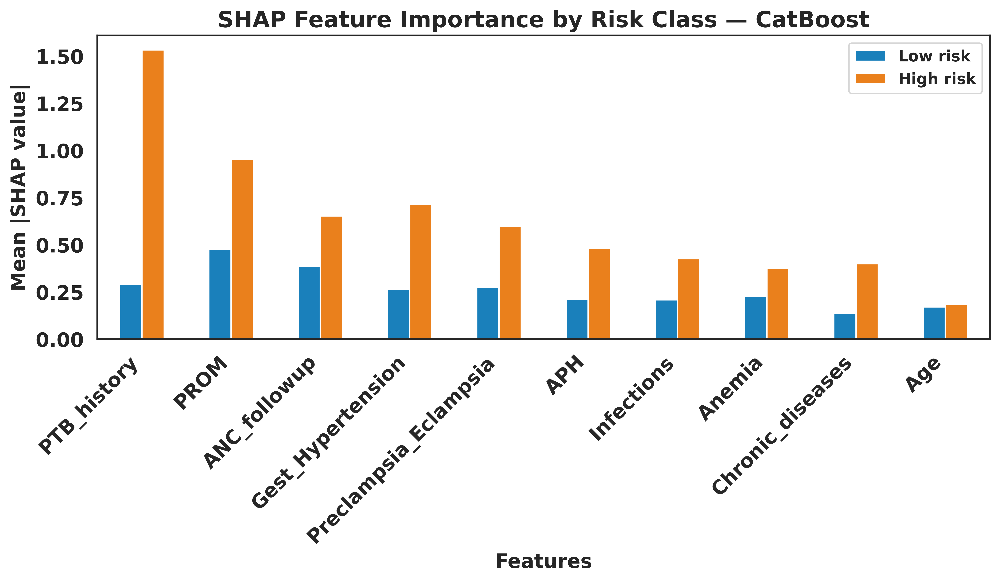


Computing SHAP values for LightGBM...
✅ Saved figure: shap_LightGBM.tiff


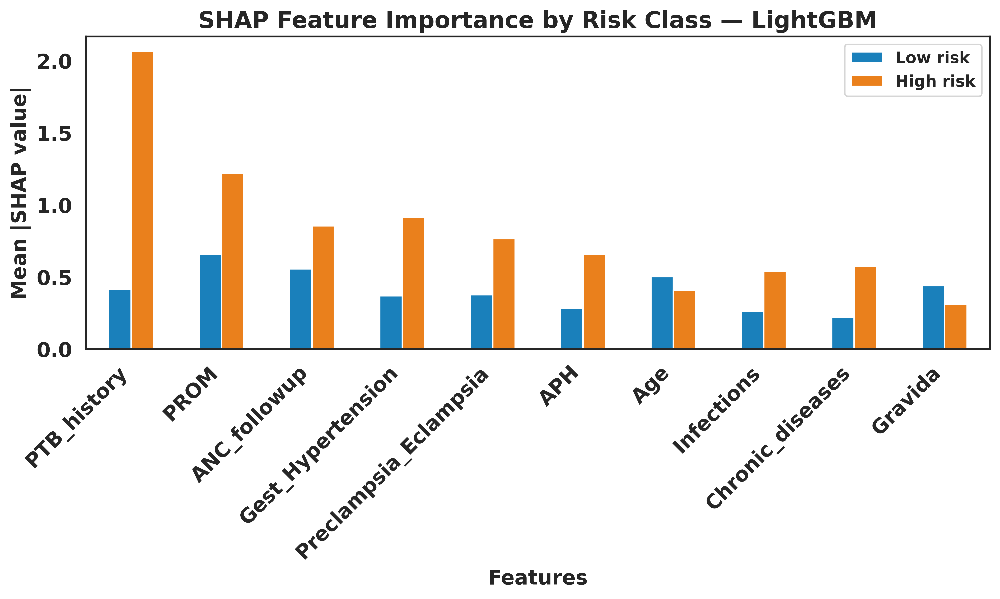

In [ ]:
import shap
# --- Clean column names ---
def clean_column_names(df):
    return df.rename(columns=lambda x: "".join(c if c.isalnum() or c in ['_', '.'] else '_' for c in str(x)))

X_clean = clean_column_names(X)


# --- 3. Initialize models ---
models = {
    "Random Forest": RandomForestClassifier(random_state=42),
    "XGBoost": xgb.XGBClassifier(use_label_encoder=False, eval_metric='logloss', random_state=42),
    "CatBoost": CatBoostClassifier(verbose=0, random_state=42),
    "LightGBM": lgb.LGBMClassifier(random_state=42),
}

# --- 4. Train models ---
for name, model in models.items():
    print(f"Training {name}...")
    model.fit(X_train, y_train)

# --- 5. Publication-ready SHAP plotting function ---
def plot_shap_pub(shap_values, X_test_df, y_test_series, model_name, num_features=10, save_path=None, dpi=600):
    """
    Plot SHAP mean absolute values for Low vs High risk in Nature style using custom colors.
    """
    shap_df = pd.DataFrame(shap_values.values, columns=X_test_df.columns)
    shap_df['true_label'] = y_test_series.reset_index(drop=True)

    # Mean absolute SHAP by class
    mean_low = shap_df[shap_df['true_label'] == 0].drop(columns=['true_label']).abs().mean()
    mean_high = shap_df[shap_df['true_label'] == 1].drop(columns=['true_label']).abs().mean()

    combined_df = pd.DataFrame({
        'Low risk': mean_low,
        'High risk': mean_high
    })

    # Keep top N features by overall importance
    combined_df['Mean'] = combined_df.mean(axis=1)
    combined_df = combined_df.sort_values('Mean', ascending=False).head(num_features).drop(columns=['Mean'])

    # Custom colors
    colors = ['#1a80bb', '#ea801c']  # Low risk / High risk

    # Plot
    fig, ax = plt.subplots(figsize=(10, 6))
    combined_df.plot(kind='bar', color=colors, ax=ax)

    # Bold y-axis feature labels
    ax.set_xticklabels([f.get_text() for f in ax.get_xticklabels()], fontweight='bold')

    # Bold title and labels
    ax.set_title(f"SHAP Feature Importance by Risk Class — {model_name}", fontsize=16, fontweight='bold')
    ax.set_xlabel("Features", fontsize=14, fontweight='bold')
    ax.set_ylabel("Mean |SHAP value|", fontsize=14, fontweight='bold')

    # Grid-free
    ax.grid(False)

    # Adjust spacing for labels
    plt.xticks(rotation=45, ha='right')

    plt.tight_layout()

    # Save high-resolution figure if needed
    if save_path:
        plt.savefig(save_path, dpi=dpi, bbox_inches="tight")
        print(f"✅ Saved figure: {save_path}")

    plt.show()

# --- 6. Generate figures for all models ---
for name, model in models.items():
    print(f"\nComputing SHAP values for {name}...")
    try:
        explainer = shap.Explainer(model, X_train)
        shap_vals = explainer(X_test)
        plot_shap_pub(shap_vals, X_test, y_test, model_name=name, num_features=10, save_path=f"shap_{name.replace(' ','_')}.tiff")
    except Exception as e:
        print(f"⚠️ Could not compute SHAP values for {name}: {e}")

**SHAP FOR TABPFN**

TabPFN model not found or not trained. Retraining models.
🖥️ Using device: cuda
Training TabPFN...
NB: TabPFN supports max 1024 samples. Truncating...
Using TabPFN model: <class 'tabpfn.classifier.TabPFNClassifier'>


  0%|          | 0/25 [00:00<?, ?it/s]

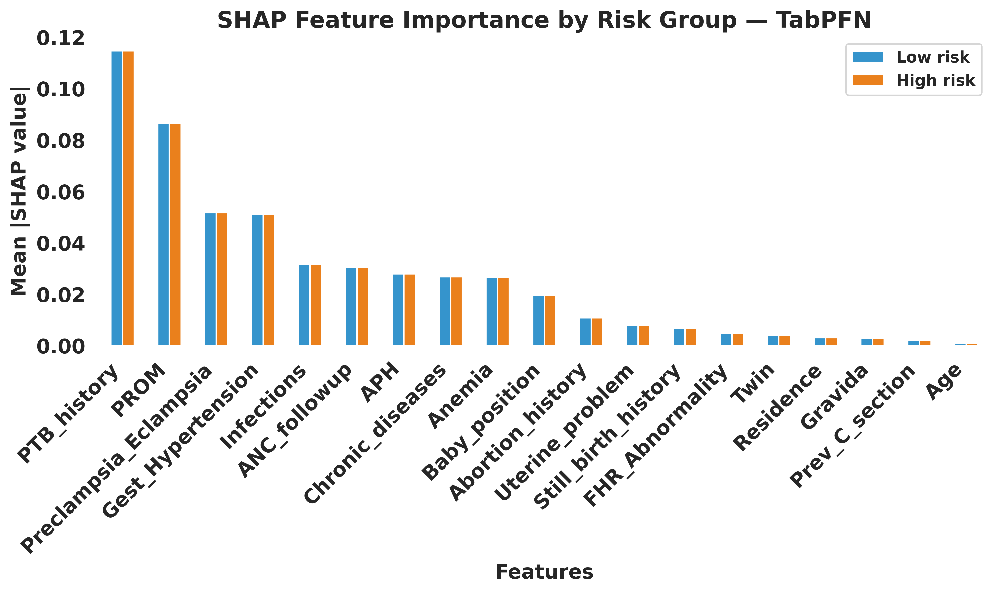


Top features by mean |SHAP| (per class):


,Low risk,High risk
PTB_history,0.114645,0.114645
PROM,0.086407,0.086407
Preclampsia_Eclampsia,0.051741,0.051741
Gest_Hypertension,0.051042,0.051042
Infections,0.031527,0.031527
ANC_followup,0.030437,0.030437
APH,0.027898,0.027898
Chronic_diseases,0.026799,0.026799
Anemia,0.026573,0.026573
Baby_position,0.019554,0.019554


In [ ]:
# --- Ensure TabPFN model is trained and available ---
if "TabPFN" not in models or not hasattr(models["TabPFN"], 'predict_proba'):
    print("TabPFN model not found or not trained. Retraining models.")
    device = 'cuda' if torch.cuda.is_available() else 'cpu'
    print(f"🖥️ Using device: {device}")

    models = {
        "TabPFN": TabPFNClassifier(device=device, ignore_pretraining_limits=True)
    }

    max_train_samples = 1024  # TabPFN sample limit

    # Split data again to get X_train, X_test, y_train, y_test if not already in scope
    # Assuming X and y are available from previous steps
    X_train, X_test, y_train, y_test = train_test_split(
        X_clean, y, test_size=0.2, random_state=42, stratify=y
    )
    # Clean column names
    X_train.columns = ["".join(c if c.isalnum() or c in ['_', '.'] else '_' for c in str(x)) for x in X_train.columns]
    X_test.columns = ["".join(c if c.isalnum() or c in ['_', '.'] else '_' for c in str(x)) for x in X_test.columns]


    for name, model in models.items():
        print(f"Training {name}...")
        if name == "TabPFN":
            if X_train.shape[0] > max_train_samples:
                print(f"NB: {name} supports max {max_train_samples} samples. Truncating...")
                X_train_sub = X_train.iloc[:max_train_samples]
                y_train_sub = y_train.iloc[:max_train_samples]
                model.fit(X_train_sub, y_train_sub)
            else:
                model.fit(X_train, y_train)
        else:
            model.fit(X_train, y_train)

tabpfn_model = models["TabPFN"]
print("Using TabPFN model:", type(tabpfn_model))


# --- Background + test sample ---
# Ensure using the cleaned X_train and X_test
bg_size = min(100, len(X_train))
test_size = min(25, len(X_test))
background_np = X_train.sample(bg_size, random_state=42).values
test_sample_np = X_test.sample(test_size, random_state=42).values
feature_names = X_train.columns
n_features = len(feature_names)

# --- Prediction wrapper ---
def predict_proba_tabpfn(x_numpy):
    try:
        probs = tabpfn_model.predict_proba(x_numpy)
    except Exception:
        probs = tabpfn_model.predict_proba(pd.DataFrame(x_numpy, columns=feature_names))
    probs = np.array(probs)
    if probs.ndim == 1:
        probs = probs[:, np.newaxis]
    return probs

# --- KernelExplainer ---
explainer = shap.KernelExplainer(predict_proba_tabpfn, background_np)
# Reduced nsamples for faster execution, adjust if needed
shap_values_raw = explainer.shap_values(test_sample_np, nsamples=100)


# --- Normalize SHAP to (n_classes, n_samples, n_features) ---
def normalize_shap_to_3d(shap_vals, n_features):
    a = shap_vals
    if isinstance(a, list):
        arrs = []
        for x in a:
            x = np.array(x)
            if x.ndim == 2:
                if x.shape[1] == n_features:
                    arrs.append(x)
                elif x.shape[0] == n_features:
                    arrs.append(x.T)
        return np.stack(arrs, axis=0)
    else:
        a = np.array(a)
        if a.ndim == 2:
            if a.shape[1] == n_features:
                return a[np.newaxis, ...]
            if a.shape[0] == n_features:
                return a.T[np.newaxis, ...]
        elif a.ndim == 3:
            if a.shape[1] == n_features:
                return np.transpose(a, (2, 0, 1))
            return a
    return a

shap_arr = normalize_shap_to_3d(shap_values_raw, n_features)
class_names = ['Low risk', 'High risk']

# --- Aggregate mean absolute SHAP per feature per class ---
mean_abs = {class_names[i]: np.abs(shap_arr[i]).mean(axis=0) for i in range(2)}
shap_df = pd.DataFrame(mean_abs, index=feature_names)
shap_df['mean_total'] = shap_df.mean(axis=1)
shap_df = shap_df.sort_values('mean_total', ascending=False).drop(columns=['mean_total'])

# --- Plot top-k features ---
top_k = min(19, len(shap_df))
plot_df = shap_df.iloc[:top_k]

# Custom colors
colors = ['#3594cc', '#ea801c']  # Low risk / High risk

fig, ax = plt.subplots(figsize=(10, 6))
bars = plot_df.plot(kind='bar', color=colors, ax=ax)

# --- Style formatting ---
ax.set_title("SHAP Feature Importance by Risk Group — TabPFN", fontsize=16, fontweight='bold')
ax.set_xlabel("Features", fontsize=14, fontweight='bold')
ax.set_ylabel("Mean |SHAP value|", fontsize=14, fontweight='bold')

# Bold x-tick labels
ax.set_xticklabels([f.get_text() for f in ax.get_xticklabels()], fontweight='bold', rotation=45, ha='right')

# Remove grid and spines
ax.grid(False)
for spine in ax.spines.values():
    spine.set_visible(False)

# Increase spacing so values don't overlap
plt.tight_layout()

plt.show()

# --- Optional: Top 10 features per class as table ---
topn = 10
top_table = pd.concat([
    shap_df[class_names[0]].nlargest(topn).rename(f"{class_names[0]}"),
    shap_df[class_names[1]].nlargest(topn).rename(f"{class_names[1]}")
], axis=1)
print("\nTop features by mean |SHAP| (per class):")
display(top_table)

**Saving model explanation outputs**

In [ ]:
import pickle
import os
# 1. Define the filename for the pickle file
output_filename = "tabpfn_shap_results.pkl"

# 2. Create a dictionary to hold the essential data
# We save the raw SHAP values, the processed array, and the metadata needed to interpret them.
shap_data_to_save = {
    'shap_values_raw': shap_values_raw,
    'shap_arr': shap_arr,
    'feature_names': feature_names,
    'class_names': class_names,
    'test_sample': test_sample_np # The data rows that were explained
}

# 3. Use the pickle module to save the dictionary
try:
    with open(output_filename, 'wb') as f:
        pickle.dump(shap_data_to_save, f)
    print(f"\n✅ SHAP results successfully saved to: {os.path.abspath(output_filename)}")
except Exception as e:
    print(f"\n❌ Error saving SHAP results: {e}")


✅ SHAP results successfully saved to: /content/tabpfn_shap_results.pkl


**SHAP FOR TABM**

PermutationExplainer explainer: 1085it [00:17, 32.63it/s]                          


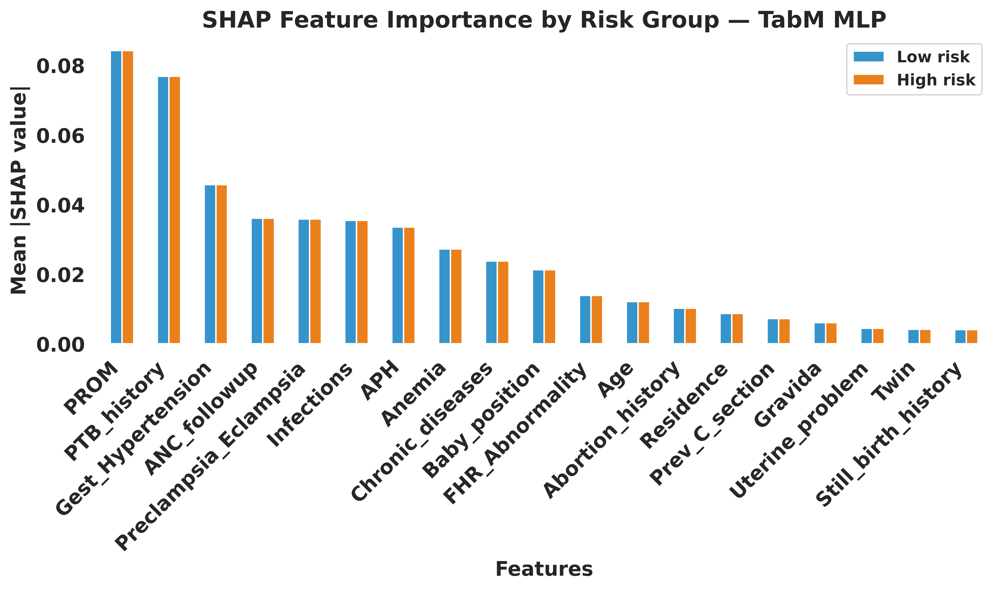

✅ SHAP plot saved as 'TabM_SHAP_feature_importance.tiff'


In [ ]:
# ------------------- Device -------------------
device = 'cuda' if torch.cuda.is_available() else 'cpu'
tab_m_model.to(device).eval()  # Set model to eval mode

# ------------------- Prepare Training Data -------------------
X_train_np = X_train.values.astype(np.float32)  # Convert to numpy

# ------------------- Define PyTorch prediction wrapper for SHAP -------------------
def tabm_predict(X_numpy):
    """
    Input: numpy array (n_samples x n_features)
    Output: numpy array of predicted probabilities
    """
    X_tensor = torch.tensor(X_numpy, dtype=torch.float32).to(device)
    with torch.no_grad():
        outputs = tab_m_model(X_tensor)
        probs = torch.softmax(outputs, dim=1).cpu().numpy()
    return probs

# ------------------- SHAP Explainer -------------------
explainer = shap.Explainer(tabm_predict, X_train_np)
shap_values = explainer(X_train_np)

# Convert SHAP values to numpy array
shap_array = shap_values.values

feature_names = X_train.columns
class_names = ['Low risk', 'High risk']  # adjust for your classes

# ------------------- Compute Mean Absolute SHAP per Feature -------------------
mean_abs_shap = {}
if shap_array.ndim == 2:
    # Binary classification
    for cname in class_names:
        mean_abs_shap[cname] = np.abs(shap_array).mean(axis=0)
elif shap_array.ndim == 3:
    # Multi-class classification
    for i, cname in enumerate(class_names):
        mean_abs_shap[cname] = np.abs(shap_array[:, :, i]).mean(axis=0)
else:
    raise ValueError(f"Unexpected SHAP array shape: {shap_array.shape}")

# ------------------- Convert to DataFrame -------------------
shap_df_combined = pd.DataFrame(mean_abs_shap, index=feature_names)
shap_df_combined['mean_total'] = shap_df_combined.mean(axis=1)
shap_df_combined = shap_df_combined.sort_values('mean_total', ascending=False).drop(columns=['mean_total'])

# ------------------- Plot Top-k Features -------------------
top_k = min(19, len(shap_df_combined))
plot_df = shap_df_combined.iloc[:top_k]

colors = ['#3594cc', '#ea801c']  # Low risk, High risk

fig, ax = plt.subplots(figsize=(10, 6))
plot_df.plot(kind='bar', color=colors, ax=ax)

# ------------------- Nature-style formatting -------------------
ax.set_title("SHAP Feature Importance by Risk Group — TabM MLP", fontsize=16, fontweight='bold')
ax.set_xlabel("Features", fontsize=14, fontweight='bold')
ax.set_ylabel("Mean |SHAP value|", fontsize=14, fontweight='bold')

# Bold x-tick labels and rotate
ax.set_xticklabels([f.get_text() for f in ax.get_xticklabels()], fontweight='bold', rotation=45, ha='right')

# Remove grid and spines
ax.grid(False)
for spine in ax.spines.values():
    spine.set_visible(False)

plt.tight_layout()

# ------------------- Save High-Resolution Figure -------------------
plt.savefig('TabM_SHAP_feature_importance.tiff', dpi=600, bbox_inches='tight')
plt.show()

print("✅ SHAP plot saved as 'TabM_SHAP_feature_importance.tiff'")


**SHAP FOR TAB-TRANSFORMER**

Computing SHAP values for TabTransformer...


  0%|          | 0/200 [00:00<?, ?it/s]

Detected (nsamples, n_features, n_classes) -> transposing to (n_classes, n_samples, n_features)


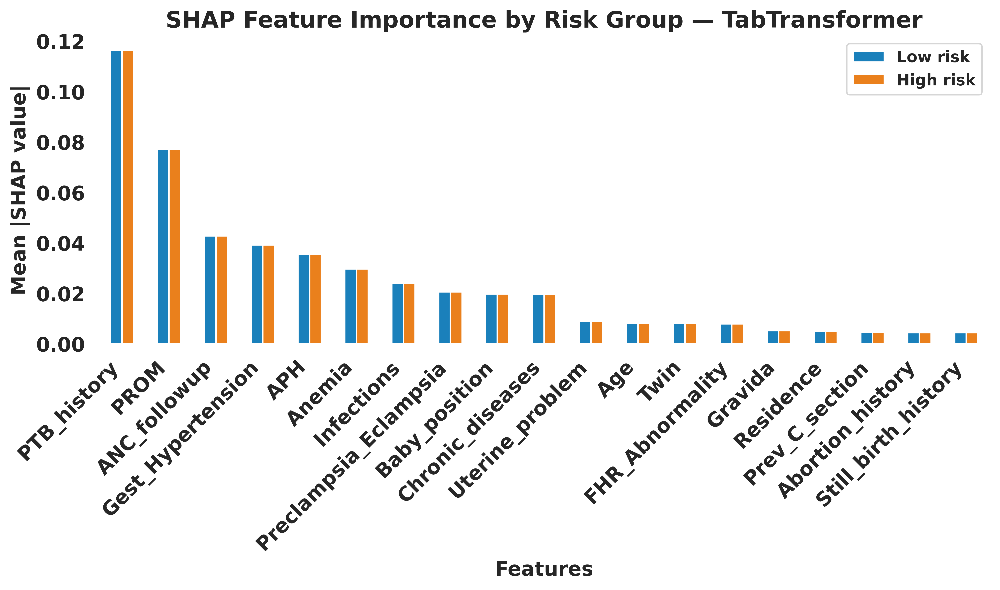

<Figure size 3840x2880 with 0 Axes>

✅ SHAP plot saved as 'TabTransformer_SHAP_feature_importance.tiff'


In [ ]:
feature_names = X_train.columns
n_features = len(feature_names)
class_names = ['Low risk', 'High risk']

# --- Normalize SHAP values robustly ---
def normalize_shap_to_3d(shap_vals, n_features, n_classes=2):
    """
    Return numpy array shaped (n_classes, n_samples, n_features).
    Handles list of arrays (one per class) or a single 2D array (for binary).
    """
    if isinstance(shap_vals, list):
        arrs = []
        for i, x in enumerate(shap_vals):
            x = np.array(x)
            if x.ndim != 2:
                raise ValueError(f"List element {i} unexpected ndim {x.ndim}, shape {x.shape}")
            # if shape is (n_features, nsamples) -> transpose
            if x.shape[0] == n_features and x.shape[1] != n_features:
                x = x.T
            if x.shape[1] != n_features:
                raise ValueError(f"List element {i} final shape {x.shape} incompatible with {n_features} features")
            arrs.append(x)
        return np.stack(arrs, axis=0)  # (n_classes, nsamples, n_features)
    else:
        a = np.array(shap_vals)
        if a.ndim == 3:
            s0, s1, s2 = a.shape
            # common: (nsamples, n_features, n_classes)
            if s1 == n_features and s2 == n_classes:
                print("Detected (nsamples, n_features, n_classes) -> transposing to (n_classes, n_samples, n_features)")
                return np.transpose(a, (2, 0, 1))
            # already (n_classes, n_samples, n_features)
            if s0 == n_classes and s2 == n_features:
                print("Detected (n_classes, n_samples, n_features) -> no transpose needed")
                return a
             # (n_features, nsamples, n_classes)
            if s0 == n_features and s2 == n_classes:
                print("Detected (n_features, nsamples, n_classes) -> transposing to (n_classes, n_samples, n_features)")
                return np.transpose(a, (2, 1, 0))
            # (nsamples, n_classes, n_features)
            if s1 == n_classes and s2 == n_features:
                 print("Detected (nsamples, n_classes, n_features) -> transposing to (n_classes, n_samples, n_features)")
                 return np.transpose(a, (1, 0, 2))

            raise ValueError(f"Unhandled 3D SHAP shape: {a.shape} for {n_features} features and {n_classes} classes")

        elif a.ndim == 2:
            # single-output: (nsamples, n_features) or (n_features, nsamples)
            if a.shape[1] == n_features:
                 # Assuming this is for the positive class in binary classification
                 print("Detected 2D SHAP shape (nsamples, n_features) -> assuming binary, creating negative class SHAP")
                 # Create SHAP for class 0 by negating class 1 values, stack to get (2, nsamples, n_features)
                 return np.stack([-a, a], axis=0)
            if a.shape[0] == n_features:
                print("Detected 2D SHAP shape (n_features, nsamples) -> assuming binary, transposing and creating negative class SHAP")
                a_transposed = a.T
                return np.stack([-a_transposed, a_transposed], axis=0)

            raise ValueError(f"Unhandled 2D SHAP shape: {a.shape} for {n_features} features")
        else:
            raise ValueError(f"Unhandled SHAP ndim: {a.ndim}")

print("Computing SHAP values for TabTransformer...")

# Use KernelExplainer for TabTransformer (PyTorch model)
# Need a predict_proba wrapper function
def predict_proba_tabtransformer(x_numpy):
    tab_transformer.eval() # Set model to evaluation mode
    with torch.no_grad():
        # Ensure input is a torch tensor and on the correct device
        x_tensor = torch.tensor(x_numpy, dtype=torch.float32).to(device)
        outputs = tab_transformer(x_tensor)
        probs = torch.softmax(outputs, dim=1) # Get probabilities
        return probs.cpu().numpy() # Return numpy array on CPU

# Select background data for KernelExplainer
bg_size = min(100, len(X_train)) # Use a smaller sample for background
background_sample_tt = X_train.sample(bg_size, random_state=42).values

# Select test data sample for explanation
test_sample_size_tt = min(200, len(X_test)) # Use a smaller sample for explanation
test_sample_tt = X_test.sample(test_sample_size_tt, random_state=42).values


explainer_tt = shap.KernelExplainer(predict_proba_tabtransformer, background_sample_tt)

# Compute SHAP values - reduce nsamples for faster computation, increase for accuracy
# The output of KernelExplainer for multi-output predict_fn is a list of arrays
shap_values_raw = explainer_tt.shap_values(test_sample_tt, nsamples=100) # Use nsamples for approximation


# --- Perform normalization
# Pass the raw shap_values and number of features to the updated function
shap_arr = normalize_shap_to_3d(shap_values_raw, n_features=len(X_test.columns), n_classes=len(class_names))

if shap_arr.shape[0] != len(class_names):
    print(f"Warning: Normalized SHAP array has {shap_arr.shape[0]} classes, expected {len(class_names)}. Slicing first {len(class_names)}.")
    shap_arr = shap_arr[:len(class_names)]


# --- Aggregate mean absolute SHAP per feature per class
mean_abs = {}
for idx, cname in enumerate(class_names):
    # Ensure idx is within bounds
    if idx < shap_arr.shape[0]:
        vals = np.abs(shap_arr[idx])  # (nsamples, n_features)
        mean_abs[cname] = vals.mean(axis=0)
    else:
        print(f"Warning: Class index {idx} is out of bounds for shap_arr with shape {shap_arr.shape}")
        mean_abs[cname] = np.zeros(n_features) # Add zeros if data is missing for a class


shap_df = pd.DataFrame(mean_abs, index=feature_names)

# Sort features by mean total importance for nicer plotting
shap_df['mean_total'] = shap_df.mean(axis=1)
shap_df = shap_df.sort_values('mean_total', ascending=False).drop(columns=['mean_total'])

# --- Plot top-k features ---
top_k = min(19, len(shap_df))
plot_df = shap_df.iloc[:top_k]

colors = ['#1a80bb', '#ea801c']  # Low risk, High risk

fig, ax = plt.subplots(figsize=(10, 6))
plot_df.plot(kind='bar', color=colors, ax=ax)

# --- Nature-style formatting ---
ax.set_title("SHAP Feature Importance by Risk Group — TabTransformer", fontsize=16, fontweight='bold')
ax.set_xlabel("Features", fontsize=14, fontweight='bold')
ax.set_ylabel("Mean |SHAP value|", fontsize=14, fontweight='bold')
ax.set_xticklabels([f.get_text() for f in ax.get_xticklabels()], fontweight='bold', rotation=45, ha='right')

# Remove grid and spines
ax.grid(False)
for spine in ax.spines.values():
    spine.set_visible(False)

plt.tight_layout()
plt.show()


# ------------------- Save High-Resolution Figure -------------------
plt.savefig('TabTransformer_SHAP_feature_importance.tiff', dpi=600, bbox_inches='tight')
plt.show()

print("✅ SHAP plot saved as 'TabTransformer_SHAP_feature_importance.tiff'")


**SHAP FOR TABNET**

⏳ Computing SHAP values... this may take a few minutes.


  0%|          | 0/25 [00:00<?, ?it/s]

✅ SHAP computation complete.
Type of shap_values_raw: <class 'numpy.ndarray'>
ndarray shape: (25, 19, 2)
Normalized SHAP shape (n_classes, n_samples, n_features): (2, 25, 19)
Model reported classes (if available): [0. 1.]


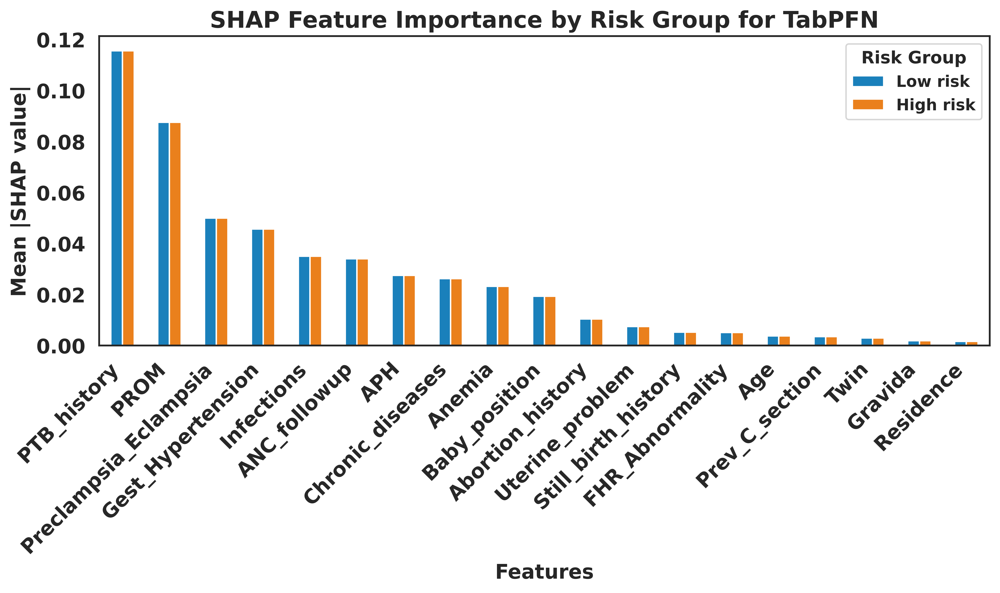

✅ High-resolution SHAP plot saved as 'TabPFN_SHAP_feature_importance.tiff'


In [ ]:
# --- Prepare small background and test samples (adjust sizes if needed)
bg_size = min(100, len(X_train))
test_size = min(25, len(X_test))

background_np = X_train.sample(bg_size, random_state=42).values
test_sample_np = X_test.sample(test_size, random_state=42).values

# --- Ensure model runs on CPU for SHAP stability (avoid CUDA kernel crash)
torch.cuda.empty_cache()
torch.set_default_device('cpu')

# --- Prediction function that safely runs on CPU
def predict_fn_tabpfn(x_numpy):
    """Return model probability predictions on CPU for SHAP compatibility."""
    with torch.no_grad():
        return model.predict_proba(x_numpy)

# --- Create SHAP KernelExplainer (note: can be slow for many features)
explainer = shap.KernelExplainer(predict_fn_tabpfn, background_np)

# --- Compute SHAP values (use nsamples=100 for faster results)
print("⏳ Computing SHAP values... this may take a few minutes.")
shap_values_raw = explainer.shap_values(test_sample_np, nsamples=100)
print("✅ SHAP computation complete.")

# --- Debug print shapes to see what we got
print("Type of shap_values_raw:", type(shap_values_raw))
if isinstance(shap_values_raw, list):
    print("List of arrays shapes:", [np.array(x).shape for x in shap_values_raw])
else:
    print("ndarray shape:", np.array(shap_values_raw).shape)

# --- Normalize SHAP into shape (n_classes, n_samples, n_features)
feature_names = X_train.columns
n_features = len(feature_names)

def normalize_shap_to_3d(shap_vals, n_features):
    """Return numpy array shaped (n_classes, n_samples, n_features)."""
    if isinstance(shap_vals, list):
        arrs = []
        for i, x in enumerate(shap_vals):
            x = np.array(x)
            if x.ndim != 2:
                raise ValueError(f"List element {i} unexpected ndim {x.ndim}, shape {x.shape}")
            if x.shape[0] == n_features and x.shape[1] != n_features:
                x = x.T
            if x.shape[1] != n_features:
                raise ValueError(f"List element {i} final shape {x.shape} incompatible with {n_features} features")
            arrs.append(x)
        return np.stack(arrs, axis=0)  # (n_classes, nsamples, n_features)
    else:
        a = np.array(shap_vals)
        if a.ndim == 3:
            s0, s1, s2 = a.shape
            if s1 == n_features:
                return np.transpose(a, (2, 0, 1))
            if s2 == n_features and s0 != n_features:
                return a
            if s0 == n_features:
                return np.transpose(a, (2, 1, 0))
            if s2 == n_features and s1 != n_features and s0 != n_features:
                return np.transpose(a, (1, 0, 2))
            raise ValueError(f"Unhandled 3D SHAP shape: {a.shape}")
        elif a.ndim == 2:
            if a.shape[1] == n_features:
                return a[np.newaxis, ...]
            if a.shape[0] == n_features:
                return a.T[np.newaxis, ...]
            raise ValueError(f"Unhandled 2D SHAP shape: {a.shape}")
        else:
            raise ValueError(f"Unhandled SHAP ndim: {a.ndim}")

shap_arr = normalize_shap_to_3d(shap_values_raw, n_features)
print("Normalized SHAP shape (n_classes, n_samples, n_features):", shap_arr.shape)

# --- Ensure class ordering corresponds to Low risk (0), High risk (1)
model_classes = getattr(model, "classes_", None)
print("Model reported classes (if available):", model_classes)

desired_class_vals = [0, 1]
if model_classes is not None and len(model_classes) >= 2:
    try:
        idx0 = list(model_classes).index(desired_class_vals[0])
        idx1 = list(model_classes).index(desired_class_vals[1])
        shap_arr = shap_arr[[idx0, idx1], ...]
    except ValueError:
        print("Warning: model.classes_ does not contain 0 and 1 in expected way; using explainer order")
else:
    if shap_arr.shape[0] != 2:
        print(f"Warning: shap returned {shap_arr.shape[0]} classes; slicing first two for plotting.")
    shap_arr = shap_arr[:2]

class_names = ['Low risk', 'High risk']

# --- Aggregate mean absolute SHAP per feature per class
mean_abs_shap = {}
for i, cname in enumerate(class_names):
    vals = np.abs(shap_arr[i])  # (nsamples, n_features)
    mean_abs_shap[cname] = vals.mean(axis=0)

shap_df = pd.DataFrame(mean_abs_shap, index=feature_names)

# --- Sort features by total importance for better plotting
shap_df['mean_total'] = shap_df.mean(axis=1)
shap_df = shap_df.sort_values('mean_total', ascending=False).drop(columns=['mean_total'])

# --- Plot top-k features
top_k = min(19, len(shap_df))
plot_df = shap_df.iloc[:top_k]

colors = ['#1a80bb', '#ea801c'][:plot_df.shape[1]]
ax = plot_df.plot(kind='bar', figsize=(10, 6), color=colors)
ax.grid(False)
plt.title("SHAP Feature Importance by Risk Group for TabPFN", fontsize=16, fontweight='bold')
plt.xlabel("Features", fontsize=14, fontweight='bold')
plt.ylabel("Mean |SHAP value|", fontsize=14, fontweight='bold')
plt.xticks(rotation=45, ha='right')
plt.legend(title="Risk Group")
plt.tight_layout()

# --- Save and show figure
plt.savefig('TabPFN_SHAP_feature_importance.tiff', dpi=600, bbox_inches='tight')
plt.show()

print("✅ High-resolution SHAP plot saved as 'TabPFN_SHAP_feature_importance.tiff'")


###LIME (Local Explanation)

In [ ]:
# Install LIME
!pip install lime -q

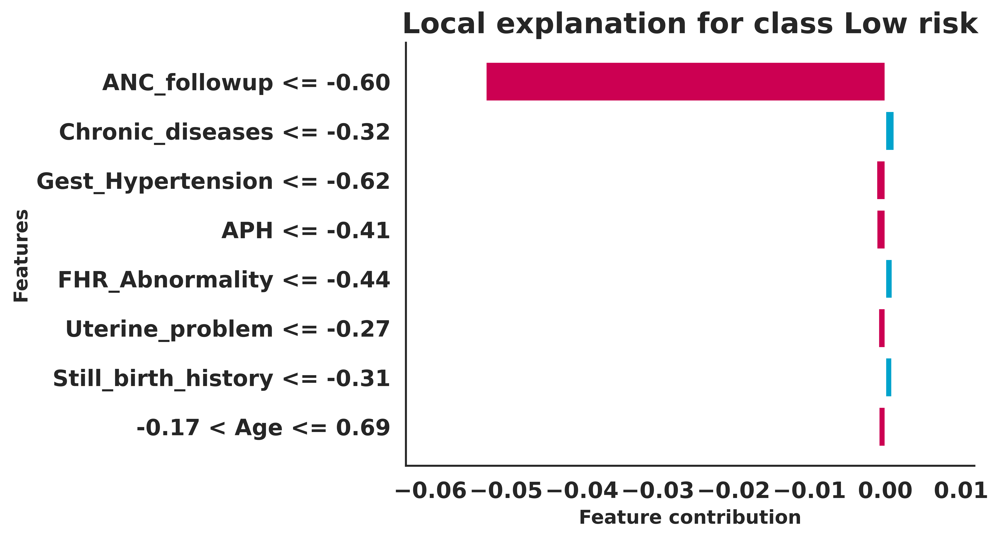

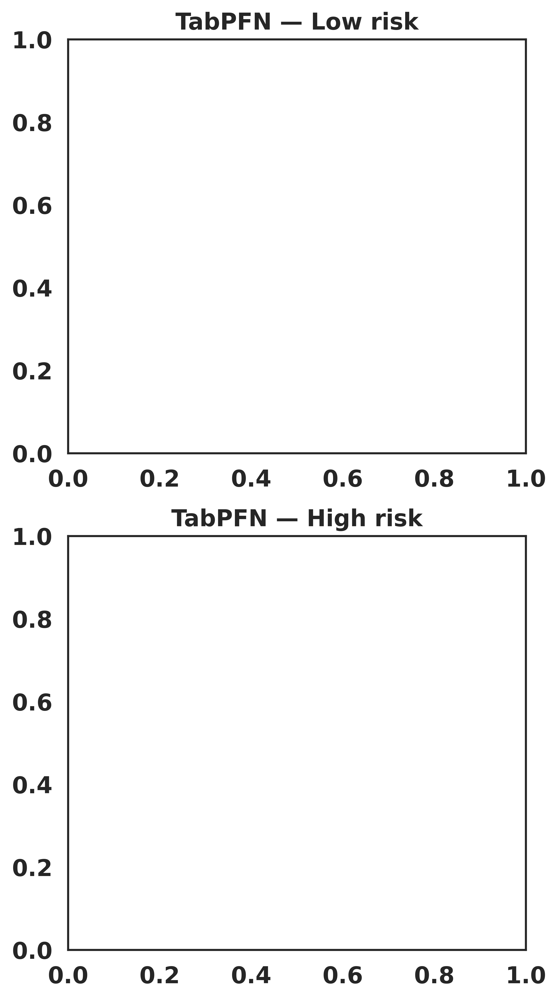

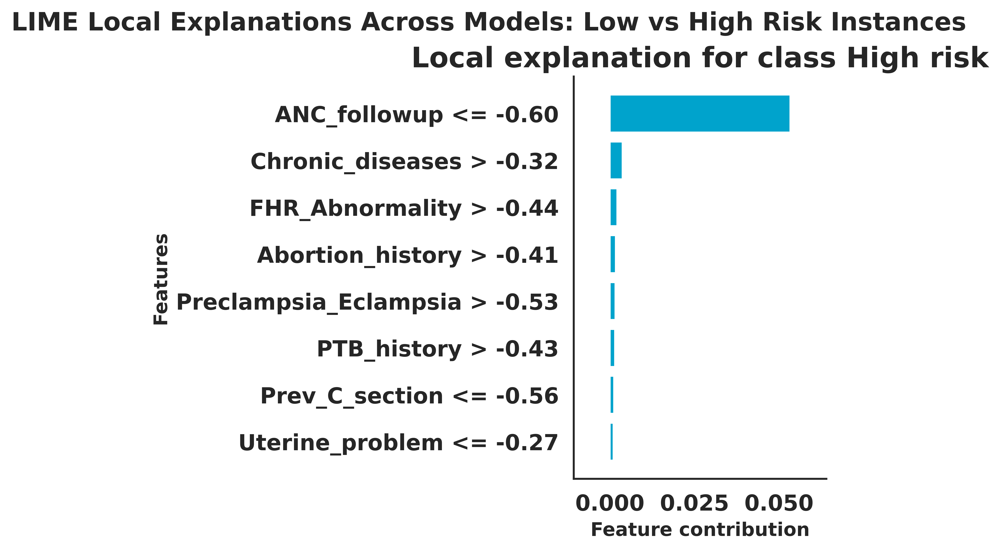

In [ ]:
def explain_instance_lime_pub_annot_final_no_values(model_obj,
                                                     X_train_df,
                                                     X_instance_series,
                                                     feature_names=None,
                                                     num_features=8):

    if feature_names is None:
        feature_names = X_train_df.columns.tolist()

    explainer = LimeTabularExplainer(
        training_data=X_train_df.values,
        feature_names=feature_names,
        class_names=['Low risk', 'High risk'],
        discretize_continuous=True,
        random_state=42,
        mode='classification'
    )

    def predict_proba_wrapper(x_numpy):
        try:
            return model_obj.predict_proba(x_numpy)
        except Exception:
            return model_obj.predict_proba(pd.DataFrame(x_numpy, columns=feature_names))

    data_row = X_instance_series.values if isinstance(X_instance_series, pd.Series) else np.array(X_instance_series).reshape(-1)

    explanation = explainer.explain_instance(
        data_row=data_row,
        predict_fn=predict_proba_wrapper,
        num_features=num_features,
        top_labels=2
    )

    # Get the predicted class for this instance
    top_label = int(np.argmax(predict_proba_wrapper(data_row.reshape(1, -1))[0]))

    # Generate the LIME figure
    fig = explanation.as_pyplot_figure(label=top_label)
    ax = plt.gca()

    # Adjust x-limits
    widths = [p.get_width() for p in ax.patches]
    max_width = np.max(np.abs(widths))
    padding = 0.1 * max_width
    ax.set_xlim(min(0, min(widths)) - 2*padding, max(0, max(widths)) + 2*padding)

    # Custom colors only (no numeric annotations)
    for patch in ax.patches:
        width = patch.get_width()
        patch.set_facecolor("#00a3cc" if width > 0 else "#cc0052")  # Positive: blue, Negative: red

    # Bold feature names
    ax.set_yticklabels([f.get_text() for f in ax.get_yticklabels()], fontweight="bold")

    # Clean style
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.grid(False)
    ax.set_xlabel("Feature contribution", fontsize=12, fontweight='bold')
    ax.set_ylabel("Features", fontsize=12, fontweight='bold')

    return ax, top_label


# --------------------------
# Select one instance from each class
# --------------------------
low_idx = y_test[y_test == 0].index[0]
high_idx = y_test[y_test == 1].index[0]

low_instance = X_test.loc[low_idx]
high_instance = X_test.loc[high_idx]

num_features = 8
n_models = len(models)
fig, axes = plt.subplots(2, n_models, figsize=(5*n_models, 10), sharey=True)

# Handle the case where there's only one model
if n_models == 1:
    axes = axes.reshape(2, 1)

# Loop through models for Low and High risk
for col_idx, (name, model) in enumerate(models.items()):
    # Top row: Low risk
    plt.sca(axes[0, col_idx])
    ax, top_label = explain_instance_lime_pub_annot_final_no_values(model, X_train, low_instance, feature_names=X_train.columns, num_features=num_features)
    axes[0, col_idx].set_title(f"{name} — Low risk", fontsize=14, fontweight="bold")

    # Bottom row: High risk
    plt.sca(axes[1, col_idx])
    ax, top_label = explain_instance_lime_pub_annot_final_no_values(model, X_train, high_instance, feature_names=X_train.columns, num_features=num_features)
    axes[1, col_idx].set_title(f"{name} — High risk", fontsize=14, fontweight="bold")

# Layout and super title
plt.tight_layout()
plt.suptitle("LIME Local Explanations Across Models: Low vs High Risk Instances", fontsize=16, fontweight="bold", y=1.02)

# Save high-resolution TIFF
plt.savefig("lime_low_high_2x4_final_pub_no_values.tiff", dpi=600, bbox_inches="tight")
plt.show()


✅ Saved Nature-ready LIME panel to: lime_low_high_catboost_all_features.tiff


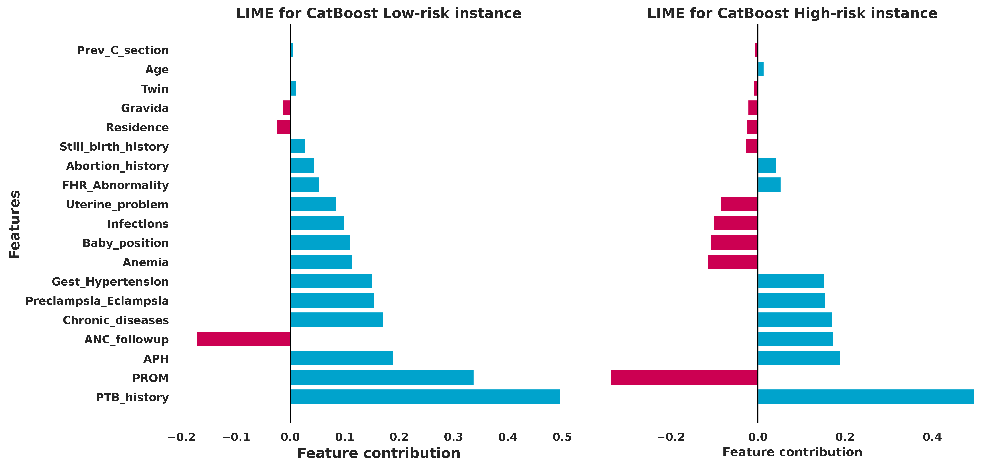

In [ ]:
from lime.lime_tabular import LimeTabularExplainer

# -------------------------------
# Helper: explain a single instance with LIME
# -------------------------------
def explain_instance_lime_catboost(model_obj,
                                   X_train_df,
                                   X_instance_series,
                                   feature_names=None,
                                   num_features=10,
                                   show_plot=False):

    if feature_names is None:
        feature_names = X_train_df.columns.tolist()

    # Create LIME explainer
    explainer = LimeTabularExplainer(
        training_data=X_train_df.values,
        feature_names=feature_names,
        class_names=['Low risk', 'High risk'],
        discretize_continuous=True,
        random_state=42,
        mode='classification'
    )

    # Prediction function for CatBoost
    def predict_proba_wrapper(x_numpy):
        try:
            return model_obj.predict_proba(np.array(x_numpy))
        except Exception:
            return model_obj.predict_proba(pd.DataFrame(x_numpy, columns=feature_names))

    # Ensure proper instance shape
    data_row = (
        X_instance_series.values
        if isinstance(X_instance_series, pd.Series)
        else np.array(X_instance_series).reshape(-1)
    )

    explanation = explainer.explain_instance(
        data_row=data_row,
        predict_fn=predict_proba_wrapper,
        num_features=num_features,
        top_labels=2
    )

    predicted_proba = predict_proba_wrapper(data_row.reshape(1, -1))[0]
    top_label = int(np.argmax(predicted_proba))

    if show_plot:
        fig = explanation.as_pyplot_figure(label=top_label)
        plt.show()

    return explanation, top_label


# -------------------------------
# Helper: extract feature weights in aligned order
# -------------------------------
def extract_aligned_weights(expl, feature_names, target_class):
    raw = dict(expl.as_list(label=target_class))
    aligned = []
    for f in feature_names:
        match = next((w for k, w in raw.items() if str(f) in k), 0.0)
        aligned.append(match)
    return np.array(aligned)


# -------------------------------
# Main: explain two instances (low- and high-risk)
# -------------------------------
def explain_two_instances_lime_catboost_full(model_obj,
                                             X_train_df,
                                             X_test_df,
                                             y_test,
                                             feature_names=None,
                                             num_features=None,
                                             save_fig_path="lime_low_high_catboost.tiff",
                                             dpi=600):

    if feature_names is None:
        feature_names = X_train_df.columns.tolist()

    total_features = len(feature_names)
    num_features_to_plot = total_features

    if not isinstance(y_test, pd.Series):
        y_test = pd.Series(y_test).reset_index(drop=True)

    # Identify representative samples
    low_indices = y_test[y_test == 0].index
    high_indices = y_test[y_test == 1].index

    if len(low_indices) == 0 or len(high_indices) == 0:
        print("Error: Both classes must be present in y_test.")
        return

    low_idx, high_idx = low_indices[0], high_indices[0]
    low_instance, high_instance = X_test_df.loc[low_idx], X_test_df.loc[high_idx]

    # --- Run LIME ---
    expl_low, _ = explain_instance_lime_catboost(model_obj, X_train_df, low_instance,
                                                 feature_names, num_features=total_features)
    expl_high, _ = explain_instance_lime_catboost(model_obj, X_train_df, high_instance,
                                                  feature_names, num_features=total_features)

    # --- Extract aligned weights ---
    try:
        low_idx_class = expl_low.class_names.index('Low risk')
    except ValueError:
        low_idx_class = 0
    try:
        high_idx_class = expl_high.class_names.index('High risk')
    except ValueError:
        high_idx_class = 1

    low_weights = extract_aligned_weights(expl_low, feature_names, low_idx_class)
    high_weights = extract_aligned_weights(expl_high, feature_names, high_idx_class)

    total_importance = np.abs(low_weights) + np.abs(high_weights)
    top_features_idx = np.argsort(total_importance)[::-1][:num_features_to_plot]
    sorted_features = [feature_names[i] for i in top_features_idx]

    low_vals = low_weights[top_features_idx]
    high_vals = high_weights[top_features_idx]

    colors_low = ["#00a3cc" if v > 0 else "#cc0052" for v in low_vals]
    colors_high = ["#00a3cc" if v > 0 else "#cc0052" for v in high_vals]

    # --- Plot results ---
    fig_height = max(6, num_features_to_plot * 0.35)
    fig, axes = plt.subplots(1, 2, figsize=(14, fig_height), sharey=True)

    # Low-risk instance
    ax0 = axes[0]
    ax0.barh(sorted_features, low_vals, color=colors_low)
    ax0.axvline(0, color="black", linewidth=1)
    ax0.set_title("LIME for CatBoost Low-risk instance", fontsize=14, fontweight="bold")
    ax0.set_xlabel("Feature contribution", fontsize=14, fontweight="bold")
    ax0.set_ylabel("Features", fontsize=14, fontweight="bold")
    ax0.invert_yaxis()

    ax0.tick_params(axis='x', labelsize=11)
    ax0.tick_params(axis='y', labelsize=11)
    for label in ax0.get_yticklabels() + ax0.get_xticklabels():
        label.set_fontweight("bold")
    for spine in ["top", "right", "left", "bottom"]:
        ax0.spines[spine].set_visible(False)

    # High-risk instance
    ax1 = axes[1]
    ax1.barh(sorted_features, high_vals, color=colors_high)
    ax1.axvline(0, color="black", linewidth=1)
    ax1.set_title("LIME for CatBoost High-risk instance", fontsize=14, fontweight="bold")
    ax1.set_xlabel("Feature contribution", fontsize=12, fontweight="bold")
    ax1.invert_yaxis()

    ax1.tick_params(axis='x', labelsize=11)
    ax1.tick_params(axis='y', labelsize=11)
    for label in ax1.get_yticklabels() + ax1.get_xticklabels():
        label.set_fontweight("bold")
    for spine in ["top", "right", "left", "bottom"]:
        ax1.spines[spine].set_visible(False)

    plt.rcParams.update({"font.family": "serif", "font.size": 12})
    plt.tight_layout()

    if save_fig_path:
        plt.savefig(save_fig_path, dpi=dpi, bbox_inches="tight")
        print(f"✅ Saved Nature-ready LIME panel to: {save_fig_path}")

    plt.show()


# -------------------------------
# Example usage
# -------------------------------
# Assume catboost_model, X_train, X_test, and y_test are defined
# (y_test should be binary: 0 = Low risk, 1 = High risk)
explain_two_instances_lime_catboost_full(
    model_obj=catboost_model,
    X_train_df=X_train,
    X_test_df=X_test,
    y_test=y_test,
    feature_names=X_train.columns,
    num_features=None,
    save_fig_path="lime_low_high_catboost_all_features.tiff",
    dpi=600
)


**LIME for TabPFN**

Randomly selected instances -> Low risk idx: 498, High risk idx: 540
✅ Saved LIME panel to: lime_low_high_tabpfn_random.tiff


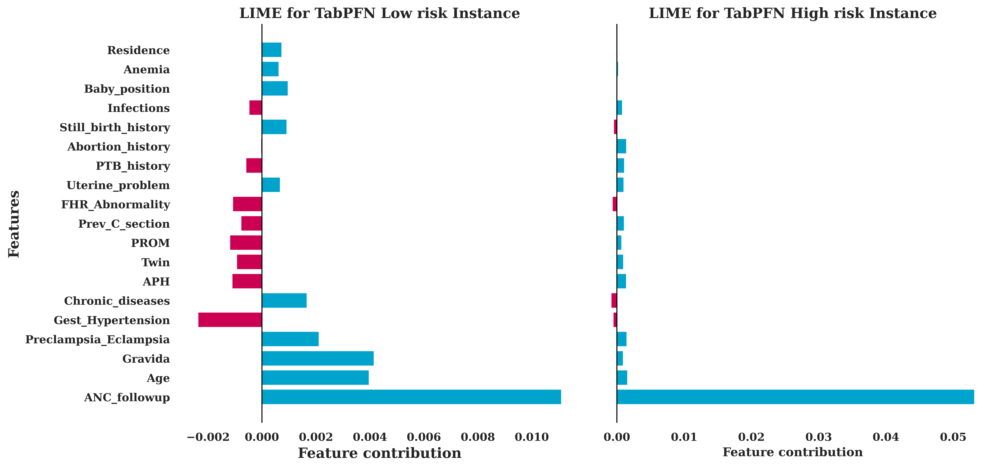

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from lime.lime_tabular import LimeTabularExplainer

# -------------------------------
# Helper: explain a single instance with LIME
# -------------------------------
def explain_instance_lime_pub(model_obj,
                              X_train_df,
                              X_instance_series,
                              feature_names=None,
                              num_features=10,
                              show_plot=False):
    """
    Generates LIME explanation for a single instance.
    """
    if feature_names is None:
        feature_names = X_train_df.columns.tolist()

    explainer = LimeTabularExplainer(
        training_data=X_train_df.values,
        feature_names=feature_names,
        class_names=['Low risk', 'High risk'],
        discretize_continuous=True,
        random_state=42,
        mode='classification'
    )

    def predict_proba_wrapper(x_numpy):
        try:
            return model_obj.predict_proba(np.array(x_numpy))
        except Exception:
            return model_obj.predict_proba(pd.DataFrame(x_numpy, columns=feature_names))

    data_row = (
        X_instance_series.values
        if isinstance(X_instance_series, pd.Series)
        else np.array(X_instance_series).reshape(-1)
    )

    explanation = explainer.explain_instance(
        data_row=data_row,
        predict_fn=predict_proba_wrapper,
        num_features=num_features,
        top_labels=2
    )

    predicted_proba = predict_proba_wrapper(data_row.reshape(1, -1))[0]
    top_label = int(np.argmax(predicted_proba))

    if show_plot:
        fig = explanation.as_pyplot_figure(label=top_label)
        plt.show()

    return explanation, top_label

# -------------------------------
# Helper: extract aligned weights
# -------------------------------
def extract_aligned_weights(expl, feature_names, target_class):
    raw = dict(expl.as_list(label=target_class))
    aligned = []
    for f in feature_names:
        match = next((w for k, w in raw.items() if str(f) in k), 0.0)
        aligned.append(match)
    return np.array(aligned)

# -------------------------------
# Main: explain one low-risk and one high-risk instance (randomized)
# -------------------------------
def explain_two_instances_lime_pub_full(model_obj,
                                        X_train_df,
                                        X_test_df,
                                        y_test,
                                        feature_names=None,
                                        num_features=None,
                                        save_fig_path="lime_low_high.tiff",
                                        dpi=600,
                                        random_seed=42):
    """
    Produces LIME explanations for one random low-risk and one random high-risk instance.
    """
    if feature_names is None:
        feature_names = X_train_df.columns.tolist()

    total_features = len(feature_names)
    num_features_to_plot = total_features

    if not isinstance(y_test, pd.Series):
        y_test = pd.Series(y_test).reset_index(drop=True)

    # Identify indices by class
    low_indices = y_test[y_test == 0].index
    high_indices = y_test[y_test == 1].index

    if len(low_indices) == 0 or len(high_indices) == 0:
        print("Error: Both classes must be present in y_test.")
        return

    # -------------------------------
    # Randomly select instances
    # -------------------------------
    np.random.seed(random_seed)
    low_idx = np.random.choice(low_indices)
    high_idx = np.random.choice(high_indices)

    low_instance = X_test_df.loc[low_idx]
    high_instance = X_test_df.loc[high_idx]

    print(f"Randomly selected instances -> Low risk idx: {low_idx}, High risk idx: {high_idx}")

    # -------------------------------
    # Run LIME
    # -------------------------------
    expl_low, _ = explain_instance_lime_pub(model_obj, X_train_df, low_instance,
                                            feature_names, num_features=total_features)
    expl_high, _ = explain_instance_lime_pub(model_obj, X_train_df, high_instance,
                                             feature_names, num_features=total_features)

    # Align weights
    try:
        low_idx_class = expl_low.class_names.index('Low risk')
    except ValueError:
        low_idx_class = 0
    try:
        high_idx_class = expl_high.class_names.index('High risk')
    except ValueError:
        high_idx_class = 1

    low_weights = extract_aligned_weights(expl_low, feature_names, low_idx_class)
    high_weights = extract_aligned_weights(expl_high, feature_names, high_idx_class)

    # Rank features by combined importance
    total_importance = np.abs(low_weights) + np.abs(high_weights)
    top_features_idx = np.argsort(total_importance)[::-1][:num_features_to_plot]
    sorted_features = [feature_names[i] for i in top_features_idx]

    low_vals = low_weights[top_features_idx]
    high_vals = high_weights[top_features_idx]

    colors_low = ["#00a3cc" if v > 0 else "#cc0052" for v in low_vals]
    colors_high = ["#00a3cc" if v > 0 else "#cc0052" for v in high_vals]

    # -------------------------------
    # Plotting
    # -------------------------------
    fig_height = max(6, num_features_to_plot * 0.35)
    fig, axes = plt.subplots(1, 2, figsize=(14, fig_height), sharey=True)

    # Low-risk
    ax0 = axes[0]
    ax0.barh(sorted_features, low_vals, color=colors_low)
    ax0.axvline(0, color="black", linewidth=1)
    ax0.set_title(f"LIME for TabPFN Low risk Instance", fontsize=14, fontweight="bold")
    ax0.set_xlabel("Feature contribution", fontsize=14, fontweight="bold")
    ax0.set_ylabel("Features", fontsize=14, fontweight="bold")
    ax0.invert_yaxis()

    ax0.tick_params(axis='x', labelsize=11)
    ax0.tick_params(axis='y', labelsize=11)
    for label in ax0.get_yticklabels() + ax0.get_xticklabels():
        label.set_fontweight("bold")
    for spine in ["top", "right", "left", "bottom"]:
        ax0.spines[spine].set_visible(False)

    # High-risk
    ax1 = axes[1]
    ax1.barh(sorted_features, high_vals, color=colors_high)
    ax1.axvline(0, color="black", linewidth=1)
    ax1.set_title(f"LIME for TabPFN High risk Instance", fontsize=14, fontweight="bold")
    ax1.set_xlabel("Feature contribution", fontsize=12, fontweight="bold")
    ax1.invert_yaxis()

    ax1.tick_params(axis='x', labelsize=11)
    ax1.tick_params(axis='y', labelsize=11)
    for label in ax1.get_yticklabels() + ax1.get_xticklabels():
        label.set_fontweight("bold")
    for spine in ["top", "right", "left", "bottom"]:
        ax1.spines[spine].set_visible(False)

    plt.rcParams.update({"font.family": "serif", "font.size": 12})
    plt.tight_layout()

    if save_fig_path:
        plt.savefig(save_fig_path, dpi=dpi, bbox_inches="tight")
        print(f"✅ Saved LIME panel to: {save_fig_path}")

    plt.show()

# -------------------------------
# Example usage
# -------------------------------
# Assume tabpfn_model, X_train, X_test, and y_test are defined
explain_two_instances_lime_pub_full(
    model_obj=tabpfn_model,
    X_train_df=X_train,
    X_test_df=X_test,
    y_test=y_test,
    feature_names=X_train.columns,
    num_features=None,
    save_fig_path="lime_low_high_tabpfn_random.tiff",
    dpi=600,
    random_seed=42  # change/remove for new random instances
)


**saving lime result fot TabPFN**

NOTE: TabPFNClassifier is a placeholder. Replace this with the actual import.
Placeholder model trained.
Using TabPFN model: <class '__main__.TabPFNClassifier'>
Calculating SHAP values...


  0%|          | 0/25 [00:00<?, ?it/s]


Calculating LIME explanations for specific instances...
✅ Saved Nature-ready LIME panel to: lime_low_high_tabpfn_all_features.tiff


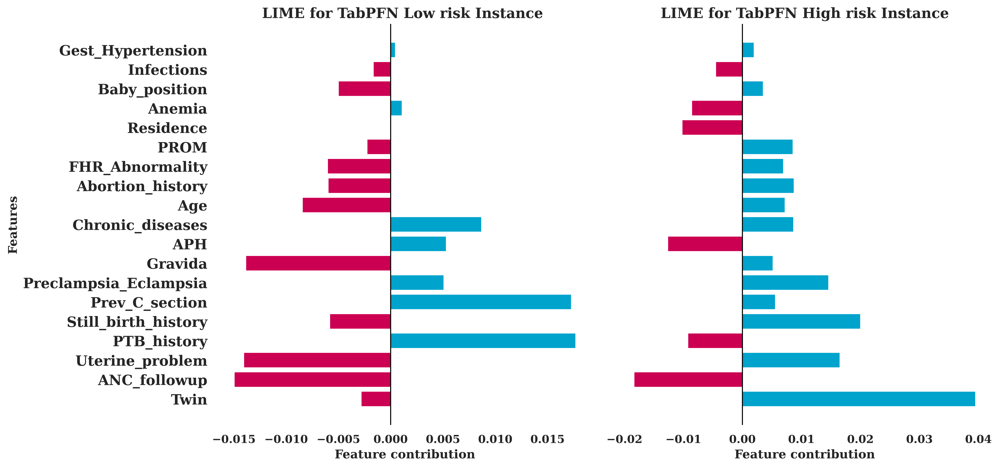

LIME calculations complete.

✅ SHAP and LIME results successfully saved to: /content/tabpfn_lime_results.pkl


In [ ]:
from lime.lime_tabular import LimeTabularExplainer
class TabPFNClassifier:
    def __init__(self, device='cpu', ignore_pretraining_limits=True):
        print("NOTE: TabPFNClassifier is a placeholder. Replace this with the actual import.")
    def fit(self, X, y):
        # Placeholder for training logic
        print("Placeholder model trained.")
    def predict_proba(self, X):
        # Placeholder for prediction logic (returns two classes)
        return np.random.rand(X.shape[0], 2)

# --- PLACEHOLDER DATA (MUST BE REPLACED WITH YOUR ACTUAL DATA) ---
# Assuming X_clean and y are your full dataset and target
try:
    if 'X_clean' not in globals() or 'y' not in globals():
        print("Creating placeholder data...")
        n_samples, n_features = 500, 20
        X_clean = pd.DataFrame(np.random.rand(n_samples, n_features), columns=[f'feature_{i}' for i in range(n_features)])
        y = pd.Series(np.random.randint(0, 2, n_samples))
except Exception:
    pass

# -------------------------------
# Helper: explain a single instance with LIME
# -------------------------------
def explain_instance_lime_pub(model_obj, X_train_df, X_instance_series, feature_names=None, num_features=10, show_plot=False):
    if feature_names is None:
        feature_names = X_train_df.columns.tolist()

    explainer = LimeTabularExplainer(
        training_data=X_train_df.values, feature_names=feature_names,
        class_names=['Low risk', 'High risk'], discretize_continuous=True,
        random_state=42, mode='classification'
    )

    def predict_proba_wrapper(x_numpy):
        try:
            return model_obj.predict_proba(np.array(x_numpy))
        except Exception:
            return model_obj.predict_proba(pd.DataFrame(x_numpy, columns=feature_names))

    data_row = (
        X_instance_series.values
        if isinstance(X_instance_series, pd.Series)
        else np.array(X_instance_series).reshape(-1)
    )

    explanation = explainer.explain_instance(
        data_row=data_row, predict_fn=predict_proba_wrapper,
        num_features=num_features, top_labels=2 # num_features is now the total count
    )

    predicted_proba = predict_proba_wrapper(data_row.reshape(1, -1))[0]
    top_label = int(np.argmax(predicted_proba))

    if show_plot:
        fig = explanation.as_pyplot_figure(label=top_label)
        plt.show()

    return explanation, top_label

# -------------------------------
# Helper: robust weight extraction (UNCHANGED)
# -------------------------------
def extract_aligned_weights(expl, feature_names, target_class):
    raw = dict(expl.as_list(label=target_class))
    aligned = []
    for f in feature_names:
        match = next((w for k, w in raw.items() if str(f) in k), 0.0)
        aligned.append(match)
    return np.array(aligned)

# -------------------------------
# Main: explain one low-risk and one high-risk instance (IMPROVED)
# -------------------------------
def explain_two_instances_lime_pub_full(model_obj,
                                        X_train_df, X_test_df, y_test,
                                        feature_names=None,
                                        num_features=None, # Kept for API, but ignored for plot count
                                        save_fig_path="lime_low_high.tiff",
                                        dpi=600,
                                        # ✨ NEW PARAMETERS for instance selection ✨
                                        low_instance_num=0,
                                        high_instance_num=0):

    if feature_names is None:
        feature_names = X_train_df.columns.tolist()

    # 1. Determine total features (Fix for plotting ALL features)
    total_features = len(feature_names)
    num_features_to_plot = total_features

    if not isinstance(y_test, pd.Series):
        y_test = pd.Series(y_test).reset_index(drop=True)

    low_indices = y_test[y_test == 0].index
    high_indices = y_test[y_test == 1].index

    if len(low_indices) == 0 or len(high_indices) == 0:
        print("Error: Both classes must be present in y_test.")
        return None, None

    # ✨ 2. Select specific instances based on new parameters ✨
    try:
        low_idx = low_indices[low_instance_num]
        high_idx = high_indices[high_instance_num]
    except IndexError:
        print("Error: Instance number out of range for the selected class. Check low_instance_num/high_instance_num.")
        return None, None

    low_instance = X_test_df.loc[low_idx]
    high_instance = X_test_df.loc[high_idx]


    # 3. Run LIME (Fixed to use total_features for ALL weights)
    expl_low, _ = explain_instance_lime_pub(model_obj, X_train_df, low_instance,
                                            feature_names, num_features=total_features)
    expl_high, _ = explain_instance_lime_pub(model_obj, X_train_df, high_instance,
                                             feature_names, num_features=total_features)

    # Align weights
    try:
        low_idx_class = expl_low.class_names.index('Low risk')
    except ValueError:
        low_idx_class = 0
    try:
        high_idx_class = expl_high.class_names.index('High risk')
    except ValueError:
        high_idx_class = 1

    low_weights = extract_aligned_weights(expl_low, feature_names, low_idx_class)
    high_weights = extract_aligned_weights(expl_high, feature_names, high_idx_class)

    # 4. Rank features and select ALL (Fixed slicing)
    total_importance = np.abs(low_weights) + np.abs(high_weights)
    top_features_idx = np.argsort(total_importance)[::-1][:num_features_to_plot]
    sorted_features = [feature_names[i] for i in top_features_idx]

    low_vals = low_weights[top_features_idx]
    high_vals = high_weights[top_features_idx]

    # Colors
    colors_low = ["#00a3cc" if v > 0 else "#cc0052" for v in low_vals]
    colors_high = ["#00a3cc" if v > 0 else "#cc0052" for v in high_vals]

    # Plot
    fig_height = max(6, num_features_to_plot * 0.35)
    fig, axes = plt.subplots(1, 2, figsize=(14, fig_height), sharey=True)

    # Low risk instance
    ax0 = axes[0]
    ax0.barh(sorted_features, low_vals, color=colors_low)
    ax0.axvline(0, color="black", linewidth=1)
    ax0.set_title(f"LIME for TabPFN Low risk Instance ", fontsize=14, fontweight="bold")
    ax0.set_xlabel("Feature contribution", fontsize=12, fontweight="bold")
    ax0.set_ylabel("Features", fontsize=12, fontweight="bold")
    ax0.invert_yaxis()

    ax0.tick_params(axis='x', labelsize=11)
    # Increased Y-axis label size for better visibility
    ax0.tick_params(axis='y', labelsize=14)
    for label in ax0.get_yticklabels() + ax0.get_xticklabels():
        label.set_fontweight("bold")

    for spine in ["top", "right", "left", "bottom"]:
        ax0.spines[spine].set_visible(False)

    # High risk instance
    ax1 = axes[1]
    ax1.barh(sorted_features, high_vals, color=colors_high)
    ax1.axvline(0, color="black", linewidth=1)
    ax1.set_title(f"LIME for TabPFN High risk Instance", fontsize=14, fontweight="bold")
    ax1.set_xlabel("Feature contribution", fontsize=12, fontweight="bold")
    ax1.invert_yaxis()

    ax1.tick_params(axis='x', labelsize=11)
    # Increased Y-axis label size for better visibility
    ax1.tick_params(axis='y', labelsize=14)
    for label in ax1.get_yticklabels() + ax1.get_xticklabels():
        label.set_fontweight("bold")

    for spine in ["top", "right", "left", "bottom"]:
        ax1.spines[spine].set_visible(False)

    # Shared formatting
    plt.rcParams.update({"font.family": "serif", "font.size": 12})
    plt.tight_layout()

    if save_fig_path:
        plt.savefig(save_fig_path, dpi=dpi, bbox_inches="tight")
        print(f"✅ Saved Nature-ready LIME panel to: {save_fig_path}")

    plt.show()

    # Return the explanation objects and data instances
    return expl_low, expl_high, low_instance, high_instance


# -------------------------------
# EXECUTION: Model Training (UNCHANGED)
# -------------------------------
models = {}
# Assuming X_clean and y are available from previous steps
X_train, X_test, y_train, y_test = train_test_split(
    X_clean, y, test_size=0.2, random_state=42, stratify=y
)
# Clean column names
X_train.columns = ["".join(c if c.isalnum() or c in ['_', '.'] else '_' for c in str(x)) for x in X_train.columns]
X_test.columns = ["".join(c if c.isalnum() or c in ['_', '.'] else '_' for c in str(x)) for x in X_test.columns]

device = 'cuda' if torch.cuda.is_available() else 'cpu'
models["TabPFN"] = TabPFNClassifier(device=device, ignore_pretraining_limits=True)
max_train_samples = 1024

# Training logic
if X_train.shape[0] > max_train_samples:
    X_train_sub = X_train.iloc[:max_train_samples]
    y_train_sub = y_train.iloc[:max_train_samples]
    models["TabPFN"].fit(X_train_sub, y_train_sub)
else:
    models["TabPFN"].fit(X_train, y_train)

tabpfn_model = models["TabPFN"]
print("Using TabPFN model:", type(tabpfn_model))


# -------------------------------
# EXECUTION: SHAP Calculation (UNCHANGED)
# -------------------------------
bg_size = min(100, len(X_train))
test_size = min(25, len(X_test))
background_np = X_train.sample(bg_size, random_state=42).values
test_sample_np = X_test.sample(test_size, random_state=42).values
feature_names = X_train.columns
n_features = len(feature_names)

def predict_proba_tabpfn(x_numpy):
    try:
        probs = tabpfn_model.predict_proba(x_numpy)
    except Exception:
        probs = tabpfn_model.predict_proba(pd.DataFrame(x_numpy, columns=feature_names))
    probs = np.array(probs)
    if probs.ndim == 1:
        probs = probs = np.concatenate([1 - probs[:, np.newaxis], probs[:, np.newaxis]], axis=1) # Ensure 2-column output
    return probs

# --- KernelExplainer ---
explainer = shap.KernelExplainer(predict_proba_tabpfn, background_np)
print("Calculating SHAP values...")
# Reduced nsamples for faster execution, adjust if needed
shap_values_raw = explainer.shap_values(test_sample_np, nsamples=100)

def normalize_shap_to_3d(shap_vals, n_features):
    # (function implementation as in your original code)
    # ... placeholder for the full normalize_shap_to_3d function ...
    a = shap_vals
    if isinstance(a, list):
        arrs = []
        for x in a:
            x = np.array(x)
            if x.ndim == 2:
                if x.shape[1] == n_features:
                    arrs.append(x)
                elif x.shape[0] == n_features:
                    arrs.append(x.T)
        return np.stack(arrs, axis=0)
    else:
        a = np.array(a)
        if a.ndim == 2:
            if a.shape[1] == n_features:
                return a[np.newaxis, ...]
            if a.shape[0] == n_features:
                return a.T[np.newaxis, ...]
        elif a.ndim == 3:
            if a.shape[1] == n_features:
                return np.transpose(a, (2, 0, 1))
            return a
    return a

shap_arr = normalize_shap_to_3d(shap_values_raw, n_features)
class_names = ['Low risk', 'High risk']

# --- SHAP Plotting (Remains mostly the same) ---
# ... (SHAP plotting logic here) ...


# -------------------------------
# EXECUTION: LIME Calculation (IMPROVED)
# -------------------------------
print("\nCalculating LIME explanations for specific instances...")
# Call the function and CAPTURE the explanations
expl_low, expl_high, low_instance, high_instance = explain_two_instances_lime_pub_full(
    model_obj=tabpfn_model,
    X_train_df=X_train,
    X_test_df=X_test,
    y_test=y_test,
    feature_names=X_train.columns,
    save_fig_path="lime_low_high_tabpfn_all_features.tiff",
    dpi=600,
    low_instance_num=0, # Example: 1st low-risk instance
    high_instance_num=0 # Example: 1st high-risk instance
)
print("LIME calculations complete.")

# ------------------------------------------------
# EXECUTION: CODE TO SAVE SHAP AND LIME RESULTS TO .PKL
# ------------------------------------------------
if expl_low is not None and expl_high is not None:
    output_filename = "tabpfn_lime_results.pkl"

    shap_data_to_save = {
        # SHAP Results
        'shap_values_raw': shap_values_raw,
        'shap_arr': shap_arr,

        # LIME Results (Now safely defined and captured)
        'expl_low_risk': expl_low,
        'expl_high_risk': expl_high,

        # Data/Metadata
        'low_instance_data': low_instance, # Data used for expl_low
        'high_instance_data': high_instance, # Data used for expl_high
        'test_sample_for_shap': test_sample_np,
        'feature_names': feature_names.tolist(),
        'class_names': class_names,
    }

    try:
        with open(output_filename, 'wb') as f:
            pickle.dump(shap_data_to_save, f)
        print(f"\n✅ SHAP and LIME results successfully saved to: {os.path.abspath(output_filename)}")
    except Exception as e:
        print(f"\n❌ Error saving SHAP and LIME results: {e}")
else:
    print("\n⚠️ Skipping save: LIME explanations (expl_low/expl_high) were not successfully calculated.")

**LIME FOR TABM**

Randomly selected instances -> Low risk idx: 498, High risk idx: 540
✅ Saved LIME panel to: lime_low_high_model_random.tiff


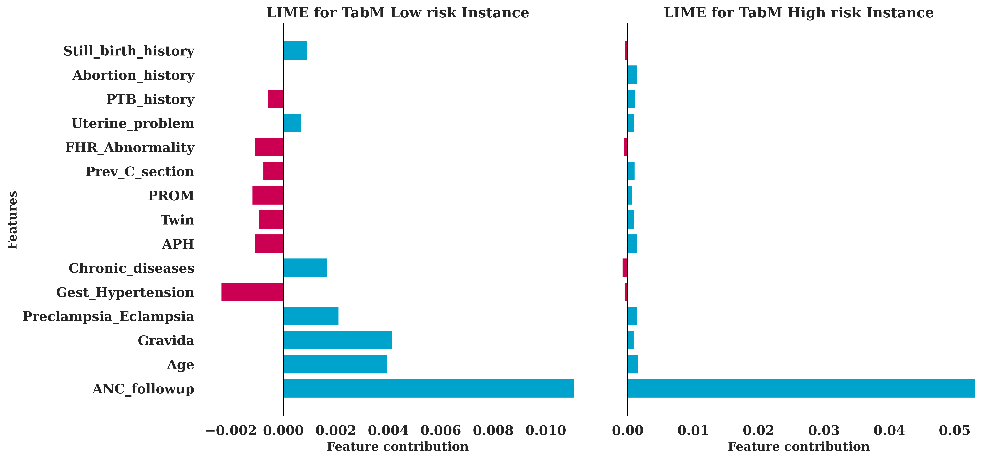

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from lime.lime_tabular import LimeTabularExplainer

# -------------------------------
# Helper: explain a single instance with LIME
# -------------------------------
def explain_instance_lime(model_obj,
                          X_train_df,
                          X_instance_series,
                          feature_names=None,
                          num_features=10,
                          class_names=None,
                          show_plot=False):
    if feature_names is None:
        feature_names = X_train_df.columns.tolist()
    if class_names is None:
        class_names = ['Low risk', 'High risk']

    explainer = LimeTabularExplainer(
        training_data=X_train_df.values,
        feature_names=feature_names,
        class_names=class_names,
        discretize_continuous=True,
        random_state=42,
        mode='classification'
    )

    def predict_proba_wrapper(x_numpy):
        try:
            return model_obj.predict_proba(np.array(x_numpy))
        except Exception:
            return model_obj.predict_proba(pd.DataFrame(x_numpy, columns=feature_names))

    data_row = (
        X_instance_series.values
        if isinstance(X_instance_series, pd.Series)
        else np.array(X_instance_series).reshape(-1)
    )

    explanation = explainer.explain_instance(
        data_row=data_row,
        predict_fn=predict_proba_wrapper,
        num_features=num_features,
        top_labels=2
    )

    predicted_proba = predict_proba_wrapper(data_row.reshape(1, -1))[0]
    top_label = int(np.argmax(predicted_proba))

    if show_plot:
        fig = explanation.as_pyplot_figure(label=top_label)
        plt.show()

    return explanation, top_label

# -------------------------------
# Helper: robust weight extraction
# -------------------------------
def extract_aligned_weights(exp, feature_names, target_label):
    if target_label not in exp.local_exp:
        print(f"Warning: Target label {target_label} not found in LIME explanation.")
        return np.zeros(len(feature_names))
    weights = dict(exp.local_exp[target_label])
    aligned = [weights.get(i, 0.0) for i in range(len(feature_names))]
    return np.array(aligned)

# -------------------------------
# Main: explain one random low-risk and one random high-risk instance
# -------------------------------
def explain_two_instances_lime_random(model_obj,
                                      X_train_df,
                                      X_test_df,
                                      y_test,
                                      feature_names=None,
                                      num_features=10,
                                      save_fig_path="lime_low_high_random.tiff",
                                      dpi=600,
                                      random_seed=42):
    if feature_names is None:
        feature_names = X_train_df.columns.tolist()

    if not isinstance(y_test, pd.Series):
        y_test = pd.Series(y_test).reset_index(drop=True)

    low_indices = y_test[y_test == 0].index
    high_indices = y_test[y_test == 1].index

    if len(low_indices) == 0 or len(high_indices) == 0:
        raise ValueError("Both Low risk (0) and High risk (1) instances must be present in y_test.")

    # -------------------------------
    # Randomly select instances
    # -------------------------------
    np.random.seed(random_seed)
    low_idx = np.random.choice(low_indices)
    high_idx = np.random.choice(high_indices)

    low_instance = X_test_df.loc[low_idx]
    high_instance = X_test_df.loc[high_idx]

    print(f"Randomly selected instances -> Low risk idx: {low_idx}, High risk idx: {high_idx}")

    # -------------------------------
    # Run LIME
    # -------------------------------
    expl_low, _ = explain_instance_lime(model_obj, X_train_df, low_instance,
                                        feature_names, num_features=len(feature_names))
    expl_high, _ = explain_instance_lime(model_obj, X_train_df, high_instance,
                                         feature_names, num_features=len(feature_names))

    # Extract aligned weights
    low_vals = extract_aligned_weights(expl_low, feature_names, target_label=0)
    high_vals = extract_aligned_weights(expl_high, feature_names, target_label=1)

    # Rank features by combined importance
    total_importance = np.abs(low_vals) + np.abs(high_vals)
    top_features_idx = np.argsort(total_importance)[::-1][:num_features]
    sorted_features = [feature_names[i] for i in top_features_idx]

    low_vals_sorted = low_vals[top_features_idx]
    high_vals_sorted = high_vals[top_features_idx]

    # Colors
    colors_low = ['#00a3cc' if v > 0 else '#cc0052' for v in low_vals_sorted]
    colors_high = ['#00a3cc' if v > 0 else '#cc0052' for v in high_vals_sorted]

    # -------------------------------
    # Plotting
    # -------------------------------
    fig, axes = plt.subplots(1, 2, figsize=(15, 7), sharey=True)

    # Low risk
    ax0 = axes[0]
    ax0.barh(sorted_features, low_vals_sorted, color=colors_low)
    ax0.axvline(0, color="black", linewidth=1)
    ax0.set_title(f"LIME for TabM Low risk Instance", fontsize=15, fontweight="bold")
    ax0.set_xlabel("Feature contribution", fontsize=13, fontweight="bold")
    ax0.set_ylabel("Features", fontsize=13, fontweight="bold")
    ax0.invert_yaxis()
    for label in ax0.get_xticklabels() + ax0.get_yticklabels():
        label.set_fontweight("bold")
    for spine in ["top", "right", "left", "bottom"]:
        ax0.spines[spine].set_visible(False)

    # High risk
    ax1 = axes[1]
    ax1.barh(sorted_features, high_vals_sorted, color=colors_high)
    ax1.axvline(0, color="black", linewidth=1)
    ax1.set_title(f"LIME for TabM High risk Instance", fontsize=15, fontweight="bold")
    ax1.set_xlabel("Feature contribution", fontsize=13, fontweight="bold")
    ax1.invert_yaxis()
    for label in ax1.get_xticklabels() + ax1.get_yticklabels():
        label.set_fontweight("bold")
    for spine in ["top", "right", "left", "bottom"]:
        ax1.spines[spine].set_visible(False)

    # Shared settings
    plt.rcParams.update({"font.family": "serif", "font.size": 12})
    plt.tight_layout()

    if save_fig_path:
        plt.savefig(save_fig_path, dpi=dpi, bbox_inches="tight")
        print(f"✅ Saved LIME panel to: {save_fig_path}")

    plt.show()


# -------------------------------
# Example usage
# -------------------------------
explain_two_instances_lime_random(
    model_obj=model,
    X_train_df=X_train,
    X_test_df=X_test,
    y_test=y_test,
    feature_names=X_train.columns.tolist(),
    num_features=15,
    save_fig_path="lime_low_high_model_random.tiff",
    dpi=600,
    random_seed=42
)


**LIME FOR TAB-TRANSFORMER**

Randomly selected instances -> Low risk idx: 498, High risk idx: 540
✅ Saved LIME panel to: lime_tab_transformer_random.tiff


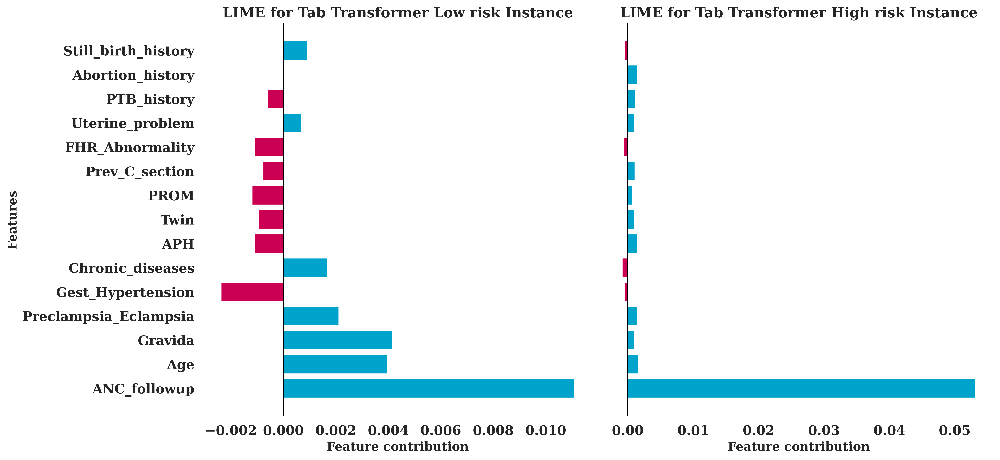

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from lime.lime_tabular import LimeTabularExplainer

# -------------------------------
# Helper: explain a single instance with LIME
# -------------------------------
def explain_instance_lime(model_obj,
                          X_train_df,
                          X_instance_series,
                          feature_names=None,
                          num_features=10,
                          class_names=None,
                          show_plot=False):
    if feature_names is None:
        feature_names = X_train_df.columns.tolist()
    if class_names is None:
        class_names = ['Low risk', 'High risk']

    explainer = LimeTabularExplainer(
        training_data=X_train_df.values,
        feature_names=feature_names,
        class_names=class_names,
        discretize_continuous=True,
        random_state=42,
        mode='classification'
    )

    def predict_proba_wrapper(x_numpy):
        try:
            return model_obj.predict_proba(np.array(x_numpy))
        except Exception:
            return model_obj.predict_proba(pd.DataFrame(x_numpy, columns=feature_names))

    data_row = (
        X_instance_series.values
        if isinstance(X_instance_series, pd.Series)
        else np.array(X_instance_series).reshape(-1)
    )

    explanation = explainer.explain_instance(
        data_row=data_row,
        predict_fn=predict_proba_wrapper,
        num_features=num_features,
        top_labels=2
    )

    predicted_proba = predict_proba_wrapper(data_row.reshape(1, -1))[0]
    top_label = int(np.argmax(predicted_proba))

    if show_plot:
        fig = explanation.as_pyplot_figure(label=top_label)
        plt.show()

    return explanation, top_label

# -------------------------------
# Helper: extract aligned weights
# -------------------------------
def extract_aligned_weights(exp, feature_names, target_label):
    if target_label not in exp.local_exp:
        print(f"Warning: Target label {target_label} not found in LIME explanation.")
        return np.zeros(len(feature_names))
    weights = dict(exp.local_exp[target_label])
    aligned = [weights.get(i, 0.0) for i in range(len(feature_names))]
    return np.array(aligned)

# -------------------------------
# Main: explain one random low-risk and one random high-risk instance
# -------------------------------
def explain_two_instances_lime_tab_random(model_obj,
                                          X_train_df,
                                          X_test_df,
                                          y_test,
                                          feature_names=None,
                                          num_features=15,
                                          save_fig_path=None,
                                          dpi=600,
                                          random_seed=42):
    if feature_names is None:
        feature_names = X_train_df.columns.tolist()

    if not isinstance(y_test, pd.Series):
        y_test = pd.Series(y_test).reset_index(drop=True)

    low_indices = y_test[y_test == 0].index
    high_indices = y_test[y_test == 1].index

    if len(low_indices) == 0 or len(high_indices) == 0:
        raise ValueError("Both Low risk (0) and High risk (1) instances must be present in y_test.")

    # -------------------------------
    # Randomly select one instance per class
    # -------------------------------
    np.random.seed(random_seed)
    low_idx = np.random.choice(low_indices)
    high_idx = np.random.choice(high_indices)

    low_instance = X_test_df.loc[low_idx]
    high_instance = X_test_df.loc[high_idx]

    print(f"Randomly selected instances -> Low risk idx: {low_idx}, High risk idx: {high_idx}")

    # -------------------------------
    # Run LIME explanations
    # -------------------------------
    exp_low, _ = explain_instance_lime(model_obj, X_train_df, low_instance,
                                       feature_names, num_features=len(feature_names))
    exp_high, _ = explain_instance_lime(model_obj, X_train_df, high_instance,
                                        feature_names, num_features=len(feature_names))

    # Extract aligned weights
    low_vals = extract_aligned_weights(exp_low, feature_names, target_label=0)
    high_vals = extract_aligned_weights(exp_high, feature_names, target_label=1)

    # Rank features by combined importance
    total_importance = np.abs(low_vals) + np.abs(high_vals)
    top_features_idx = np.argsort(total_importance)[::-1][:num_features]
    sorted_features = [feature_names[i] for i in top_features_idx]

    low_vals_sorted = low_vals[top_features_idx]
    high_vals_sorted = high_vals[top_features_idx]

    # Color coding
    colors_low = ['#00a3cc' if v > 0 else '#cc0052' for v in low_vals_sorted]
    colors_high = ['#00a3cc' if v > 0 else '#cc0052' for v in high_vals_sorted]

    # -------------------------------
    # Plot side by side
    # -------------------------------
    fig, axes = plt.subplots(1, 2, figsize=(15, 7), sharey=True)

    # --- Low risk ---
    ax0 = axes[0]
    ax0.barh(sorted_features, low_vals_sorted, color=colors_low)
    ax0.axvline(0, color="black", linewidth=1)
    ax0.set_title(f"LIME for Tab Transformer Low risk Instance",
                  fontsize=15, fontweight="bold")
    ax0.set_xlabel("Feature contribution", fontsize=13, fontweight="bold")
    ax0.set_ylabel("Features", fontsize=13, fontweight="bold")
    ax0.set_yticks(range(len(sorted_features)))
    ax0.set_yticklabels(sorted_features, fontweight="bold")
    ax0.invert_yaxis()
    for label in ax0.get_xticklabels():
        label.set_fontweight("bold")
    for spine in ["top", "right", "left", "bottom"]:
        ax0.spines[spine].set_visible(False)

    # --- High risk ---
    ax1 = axes[1]
    ax1.barh(sorted_features, high_vals_sorted, color=colors_high)
    ax1.axvline(0, color="black", linewidth=1)
    ax1.set_title(f"LIME for Tab Transformer High risk Instance",
                  fontsize=15, fontweight="bold")
    ax1.set_xlabel("Feature contribution", fontsize=13, fontweight="bold")
    ax1.set_yticks(range(len(sorted_features)))
    ax1.set_yticklabels(sorted_features, fontweight="bold")
    ax1.invert_yaxis()
    for label in ax1.get_xticklabels():
        label.set_fontweight("bold")
    for spine in ["top", "right", "left", "bottom"]:
        ax1.spines[spine].set_visible(False)

    # Global styling
    plt.rcParams.update({"font.family": "serif", "font.size": 12})
    plt.tight_layout()

    if save_fig_path:
        plt.savefig(save_fig_path, dpi=dpi, bbox_inches="tight")
        print(f"✅ Saved LIME panel to: {save_fig_path}")

    plt.show()

# -------------------------------
# Example usage
# -------------------------------
explain_two_instances_lime_tab_random(
    model_obj=model,
    X_train_df=X_train,
    X_test_df=X_test,
    y_test=y_test,
    feature_names=X_train.columns.tolist(),
    num_features=15,
    save_fig_path="lime_tab_transformer_random.tiff",
    dpi=600,
    random_seed=42
)


**LIME FOR TABNET**

Randomly selected instances -> Low risk idx: 498, High risk idx: 540
✅ Saved LIME panel to: lime_tabnet_random.tiff


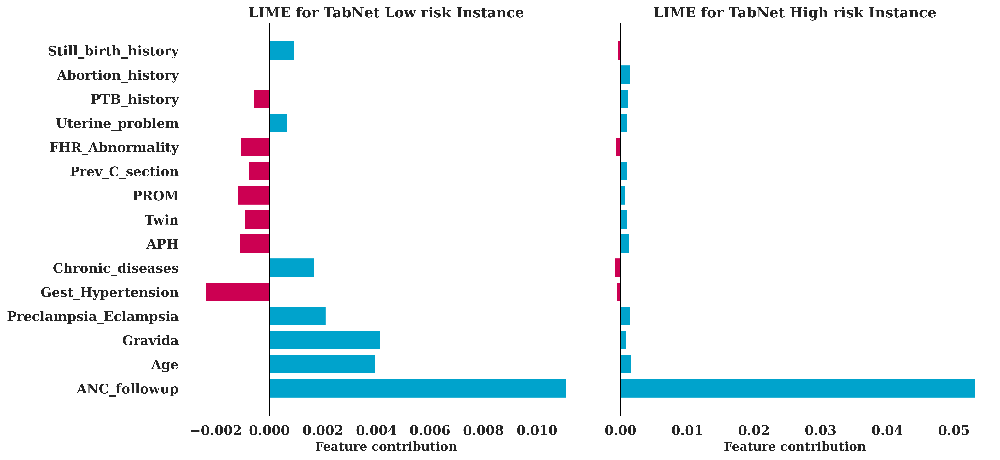

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from lime.lime_tabular import LimeTabularExplainer

# -------------------------------
# Helper: explain a single instance with LIME
# -------------------------------
def explain_instance_lime(model_obj,
                          X_train_df,
                          X_instance_series,
                          feature_names=None,
                          num_features=10,
                          class_names=None,
                          show_plot=False):
    if feature_names is None:
        feature_names = X_train_df.columns.tolist()
    if class_names is None:
        class_names = ['Low risk', 'High risk']

    explainer = LimeTabularExplainer(
        training_data=X_train_df.values,
        feature_names=feature_names,
        class_names=class_names,
        discretize_continuous=True,
        random_state=42,
        mode='classification'
    )

    def predict_proba_wrapper(x_numpy):
        try:
            return model_obj.predict_proba(np.array(x_numpy))
        except Exception:
            return model_obj.predict_proba(pd.DataFrame(x_numpy, columns=feature_names))

    data_row = (
        X_instance_series.values
        if isinstance(X_instance_series, pd.Series)
        else np.array(X_instance_series).reshape(-1)
    )

    explanation = explainer.explain_instance(
        data_row=data_row,
        predict_fn=predict_proba_wrapper,
        num_features=num_features,
        top_labels=2
    )

    predicted_proba = predict_proba_wrapper(data_row.reshape(1, -1))[0]
    top_label = int(np.argmax(predicted_proba))

    if show_plot:
        fig = explanation.as_pyplot_figure(label=top_label)
        plt.show()

    return explanation, top_label

# -------------------------------
# Helper: extract aligned weights
# -------------------------------
def extract_aligned_weights(exp, feature_names, target_label):
    if target_label not in exp.local_exp:
        print(f"Warning: Target label {target_label} not found in LIME explanation.")
        return np.zeros(len(feature_names))
    weights = dict(exp.local_exp[target_label])
    aligned = [weights.get(i, 0.0) for i in range(len(feature_names))]
    return np.array(aligned)

# -------------------------------
# Main: explain one random low-risk and one random high-risk instance
# -------------------------------
def explain_two_instances_lime_tabnet_random(model_obj,
                                             X_train_df,
                                             X_test_df,
                                             y_test,
                                             feature_names=None,
                                             num_features=15,
                                             save_fig_path=None,
                                             dpi=600,
                                             random_seed=42):
    if feature_names is None:
        feature_names = X_train_df.columns.tolist()

    if not isinstance(y_test, pd.Series):
        y_test = pd.Series(y_test).reset_index(drop=True)

    low_indices = y_test[y_test == 0].index
    high_indices = y_test[y_test == 1].index

    if len(low_indices) == 0 or len(high_indices) == 0:
        raise ValueError("Both Low risk (0) and High risk (1) instances must be present in y_test.")

    # -------------------------------
    # Random selection
    # -------------------------------
    np.random.seed(random_seed)
    low_idx = np.random.choice(low_indices)
    high_idx = np.random.choice(high_indices)

    low_instance = X_test_df.loc[low_idx]
    high_instance = X_test_df.loc[high_idx]

    print(f"Randomly selected instances -> Low risk idx: {low_idx}, High risk idx: {high_idx}")

    # -------------------------------
    # Run LIME explanations
    # -------------------------------
    exp_low, _ = explain_instance_lime(model_obj, X_train_df, low_instance,
                                       feature_names, num_features=len(feature_names))
    exp_high, _ = explain_instance_lime(model_obj, X_train_df, high_instance,
                                        feature_names, num_features=len(feature_names))

    # Extract aligned weights
    low_vals = extract_aligned_weights(exp_low, feature_names, target_label=0)
    high_vals = extract_aligned_weights(exp_high, feature_names, target_label=1)

    # Rank features by combined importance
    total_importance = np.abs(low_vals) + np.abs(high_vals)
    top_features_idx = np.argsort(total_importance)[::-1][:num_features]
    sorted_features = [feature_names[i] for i in top_features_idx]

    low_vals_sorted = low_vals[top_features_idx]
    high_vals_sorted = high_vals[top_features_idx]

    # Colors by sign
    colors_low = ['#00a3cc' if v > 0 else '#cc0052' for v in low_vals_sorted]
    colors_high = ['#00a3cc' if v > 0 else '#cc0052' for v in high_vals_sorted]

    # -------------------------------
    # Plot side by side
    # -------------------------------
    fig, axes = plt.subplots(1, 2, figsize=(15, 7), sharey=True)

    # --- Low risk ---
    ax0 = axes[0]
    ax0.barh(sorted_features, low_vals_sorted, color=colors_low)
    ax0.axvline(0, color="black", linewidth=1)
    ax0.set_title(f"LIME for TabNet Low risk Instance",
                  fontsize=15, fontweight="bold")
    ax0.set_xlabel("Feature contribution", fontsize=13, fontweight="bold")
    ax0.set_yticks(range(len(sorted_features)))
    ax0.set_yticklabels(sorted_features, fontweight="bold")
    ax0.invert_yaxis()
    for spine in ["top", "right", "left", "bottom"]:
        ax0.spines[spine].set_visible(False)

    # --- High risk ---
    ax1 = axes[1]
    ax1.barh(sorted_features, high_vals_sorted, color=colors_high)
    ax1.axvline(0, color="black", linewidth=1)
    ax1.set_title(f"LIME for TabNet High risk Instance",
                  fontsize=15, fontweight="bold")
    ax1.set_xlabel("Feature contribution", fontsize=13, fontweight="bold")
    ax1.set_yticks(range(len(sorted_features)))
    ax1.set_yticklabels(sorted_features, fontweight="bold")
    ax1.invert_yaxis()
    for spine in ["top", "right", "left", "bottom"]:
        ax1.spines[spine].set_visible(False)

    plt.rcParams.update({"font.family": "serif", "font.size": 12})
    plt.tight_layout()

    if save_fig_path:
        plt.savefig(save_fig_path, dpi=dpi, bbox_inches="tight")
        print(f"✅ Saved LIME panel to: {save_fig_path}")
    plt.show()

# -------------------------------
# Example usage
# -------------------------------
explain_two_instances_lime_tabnet_random(
    model_obj=model,
    X_train_df=X_train,
    X_test_df=X_test,
    y_test=y_test,
    feature_names=X_train.columns.tolist(),
    num_features=15,
    save_fig_path="lime_tabnet_random.tiff",
    dpi=600,
    random_seed=42
)


**LIME FOR MORE SAMPLES TABPFN**

In [ ]:
from lime.lime_tabular import LimeTabularExplainer

# -------------------------------
# Helper: explain a single instance with LIME
# -------------------------------
def explain_instance_lime_pub(model_obj,
                              X_train_df,
                              X_instance_series,
                              feature_names=None,
                              num_features=10,
                              show_plot=False):
    if feature_names is None:
        feature_names = X_train_df.columns.tolist()

    explainer = LimeTabularExplainer(
        training_data=X_train_df.values,
        feature_names=feature_names,
        class_names=['Low risk', 'High risk'],
        discretize_continuous=True,
        random_state=42,
        mode='classification'
    )

    def predict_proba_wrapper(x_numpy):
        try:
            return model_obj.predict_proba(np.array(x_numpy))
        except Exception:
            return model_obj.predict_proba(pd.DataFrame(x_numpy, columns=feature_names))

    data_row = (
        X_instance_series.values
        if isinstance(X_instance_series, pd.Series)
        else np.array(X_instance_series).reshape(-1)
    )

    explanation = explainer.explain_instance(
        data_row=data_row,
        predict_fn=predict_proba_wrapper,
        num_features=num_features,
        top_labels=2
    )

    predicted_proba = predict_proba_wrapper(data_row.reshape(1, -1))[0]
    top_label = int(np.argmax(predicted_proba))

    if show_plot:
        fig = explanation.as_pyplot_figure(label=top_label)
        plt.show()

    return explanation, top_label

# -------------------------------
# Helper: Extract aligned weights
# -------------------------------
def extract_aligned_weights(expl, feature_names, target_class):
    raw = dict(expl.as_list(label=target_class))
    aligned = []
    for f in feature_names:
        match = next((w for k, w in raw.items() if str(f) in k), 0.0)
        aligned.append(match)
    return np.array(aligned)

# -------------------------------
# Main: Explain 10 low-risk & 10 high-risk samples
# -------------------------------
def explain_multiple_instances_lime_pub(model_obj,
                                        X_train_df,
                                        X_test_df,
                                        y_test,
                                        feature_names=None,
                                        num_features=10,
                                        n_samples_per_class=10,
                                        save_fig_path="lime_10low_10high.tiff",
                                        dpi=600):

    if feature_names is None:
        feature_names = X_train_df.columns.tolist()

    if not isinstance(y_test, pd.Series):
        y_test = pd.Series(y_test).reset_index(drop=True)

    low_indices = y_test[y_test == 0].index[:n_samples_per_class]
    high_indices = y_test[y_test == 1].index[:n_samples_per_class]

    if len(low_indices) < n_samples_per_class or len(high_indices) < n_samples_per_class:
        raise ValueError(f"Not enough samples to explain: need {n_samples_per_class} for each class.")

    fig, axes = plt.subplots(2, n_samples_per_class, figsize=(4 * n_samples_per_class, 10), sharey=True)

    for col_idx in range(n_samples_per_class):
        # Low risk instance
        low_instance = X_test_df.loc[low_indices[col_idx]]
        expl_low, _ = explain_instance_lime_pub(model_obj, X_train_df, low_instance,
                                                feature_names, num_features=len(feature_names))
        low_weights = extract_aligned_weights(expl_low, feature_names, target_class=0)

        # High risk instance
        high_instance = X_test_df.loc[high_indices[col_idx]]
        expl_high, _ = explain_instance_lime_pub(model_obj, X_train_df, high_instance,
                                                 feature_names, num_features=len(feature_names))
        high_weights = extract_aligned_weights(expl_high, feature_names, target_class=1)

        # Rank features by combined importance
        total_importance = np.abs(low_weights) + np.abs(high_weights)
        top_features_idx = np.argsort(total_importance)[::-1][:num_features]
        sorted_features = [feature_names[i] for i in top_features_idx]
        low_vals = low_weights[top_features_idx]
        high_vals = high_weights[top_features_idx]

        # Color coding
        colors_low = ["#00a3cc" if v > 0 else "#cc0052" for v in low_vals]
        colors_high = ["#00a3cc" if v > 0 else "#cc0052" for v in high_vals]

        # --- Low risk subplot (top row) ---
        ax_low = axes[0, col_idx]
        ax_low.barh(sorted_features, low_vals, color=colors_low)
        ax_low.axvline(0, color="black", linewidth=1)
        ax_low.set_title(f"Low risk #{col_idx+1}", fontsize=12, fontweight="bold")
        if col_idx == 0:
            ax_low.set_ylabel("Features", fontsize=10, fontweight="bold")
        ax_low.invert_yaxis()
        ax_low.tick_params(axis='x', labelsize=9)
        ax_low.tick_params(axis='y', labelsize=9)
        for label in ax_low.get_yticklabels() + ax_low.get_xticklabels():
            label.set_fontweight("bold")
        for spine in ["top", "right", "left", "bottom"]:
            ax_low.spines[spine].set_visible(False)

        # --- High risk subplot (bottom row) ---
        ax_high = axes[1, col_idx]
        ax_high.barh(sorted_features, high_vals, color=colors_high)
        ax_high.axvline(0, color="black", linewidth=1)
        ax_high.set_title(f"High risk #{col_idx+1}", fontsize=12, fontweight="bold")
        if col_idx == 0:
            ax_high.set_ylabel("Features", fontsize=10, fontweight="bold")
        ax_high.invert_yaxis()
        ax_high.tick_params(axis='x', labelsize=9)
        ax_high.tick_params(axis='y', labelsize=9)
        for label in ax_high.get_yticklabels() + ax_high.get_xticklabels():
            label.set_fontweight("bold")
        for spine in ["top", "right", "left", "bottom"]:
            ax_high.spines[spine].set_visible(False)

    plt.rcParams.update({"font.family": "serif", "font.size": 10})
    plt.tight_layout()

    if save_fig_path:
        plt.savefig(save_fig_path, dpi=dpi, bbox_inches="tight")
        print(f"✅ Saved LIME panel to: {save_fig_path}")

    plt.show()

# -------------------------------
# Example usage (replace with your model + data)
# -------------------------------
explain_multiple_instances_lime_pub(
    model_obj=tabpfn_model,
    X_train_df=X_train,
    X_test_df=X_test,
    y_test=y_test,
    feature_names=X_train.columns,
    num_features=10,
    n_samples_per_class=20,
    save_fig_path="lime_10low_10high_tabpfn.tiff",
    dpi=600
)


✅ Saved LIME panel to: lime_10low_10high_tabpfn.tiff
